# Домашнее задание №2

<span style="color: red; font-size: 14pt">Дедлайн: 13 марта 23:59</span>

Машинное обучение, ФИВТ, Весна 2018

Составлено с использованием материалов Евгения Колмакова и Юрия Кашницкого (открытый курс машинного обучения, тема 3), а также лекций по машинному обучению Евгения Соколова

**Оформление дз**: 
- Присылайте выполненное задание на почту ``ml.course.mipt@gmail.com``
- Укажите тему письма в следующем формате ``ML2018_fall <номер_группы> <фамилия>``, к примеру -- ``ML2018_fall 596 ivanov``
- Выполненное дз сохраните в файл ``ML2018_<фамилия>_<группа>_task<номер задания>.ipnb``, к примеру -- ``ML2018_ivanov_596_task1.ipnb``

**Вопросы**:
- Присылайте вопросы на почту ``ml.course.mipt@gmail.com``
- Укажите тему письма в следующем формате ``ML2018_fall Question <Содержание вопроса>``

--------
- **PS1**: Используются автоматические фильтры, мы не найдем ваше дз, если вы укажете тему письма в неправильном формате.
- **PS2**: Просроченный дедлайн снижает максимальный вес задания по формуле, указнной на первом семинаре

## Часть 0. Вопросы для самоконтроля

##### Перед выполнением задания убедитесь, что вы знаете ответы на этот теор.минимум
##### Эта часть задания не оценивается, ответы можно не записывать

1. Что такое решающее дерево? Как по построенному дереву найти прогноз для объекта?
2. Почему для любой выборки можно построить дерево, имеющее нулевую ошибку на ней? Приведите примеры.
3. Почему не рекомендуется строить небинарные деревья (имеющие более двух потомков у каждой вершины)?
4. Как устроен жадный алгоритм построения дерева?
5. Какие критерии информативности для решения задачи классификации вы знаете?
6. Какой смысл у критерия Джини и энтропийного критерия?
7. Какие критерии информативности для решения задачи регрессии вы знаете?
8. Что такое pruning (стрижка) дерева? Чем отличаются post-pruning и pre-pruning?
9. Какие методы обработки пропущенных значений вы знаете?
10. Как учитывать категориальные признаки в решающем дереве?
11. Что такое mean target encoding? Почему эта техника хорошо работает для решающих деревьев?
12. Как работает отбор признаков с помощью решающих деревьев?

## Часть 1. Теоретические задачи

##### 30% баллов за задание, оценочное время выполнения 1 час

##### Решение можно затехать здесь или написать от руки и добавить фото в ноутбук

### Задача 1 (10% баллов)

Какая стратегия поведения в листьях регрессионного дерева приводит к меньшему матожиданию ошибки по MSE: отвечать средним значением таргета на объектах обучающей выборки, попавших в лист, или отвечать таргетом для случайного объекта из листа (считая все объекты равновероятными)?

Рассмотрим один элемент в обоих случаях и подсчитаем MSE на нем.

$MSE_1 = (y - \frac{1}{n}\sum_{i=1}^n y_n)^2 = y^2 - \frac{2y}{n}\sum_{i=1}^n y_n + (\frac{\sum_{i=1}^n y_n}{n})^2$

$MSE_2 = \frac{1}{n}\sum_{i=1}^n (y - y_i)^2 = y^2 - \frac{2y}{n}\sum_{i=1}^n y_n + \frac{\sum_{i=1}^n y_n^2}{n} $

$MSE_1 - MSE_2 = (\frac{\sum_{i=1}^n y_n}{n})^2 - \frac{\sum_{i=1}^n y_n^2}{n} \leq 0$

Значит, в первом случае ошибка не больше, чем во втором.

### Задача 2 (15% баллов)

Критерий информативности для набора объектов $L$ вычисляется на основе того, насколько хорошо их целевые переменные предсказываются константой (при оптимальном выборе этой константы):
$$H(R) = \min_{c \in Y} \dfrac{1}{|R|} \sum_{(x_i,y_i) \in R} L(y_i, c),$$
где $L(y_i, c)$- некоторая функция потерь. Соответственно, чтобы получить вид критерия при конкретной функции потерь, необходимо аналитически найти оптимальное значение константы и подставить его в формулу для $H(R)$.

Выведите критерии информативности для следующих функций потерь:
1. $L(y,c) = (y-c)^2$
2. $L(y,c) = \sum_{k=1}^K (c_k-[y=k])^2$
3. $L(y,c) = -\sum_{k=1}^K [y=k]\log c_k$

**Подсказка**:
должны получиться дисперия, критерий Джини и энтропийный критерий.

** Случай 1 **

$\frac{\delta}{\delta с} \sum_{(x_i,y_i) \in R} (y_i - c)^2 = 0$

$\sum_{(x_i,y_i) \in R} y_i - |R| * c= 0; \rightarrow c = \frac{\sum_{(x_i,y_i) \in R} y_i}{|R|} = E y$

Тогда получим

$H(R) = \frac{1}{|R|}\sum_{(x_i,y_i) \in R} (y_i - Ey)^2 = E(y - Ey)^2 = Dy$

** Случай 2 **

$ 0 = \frac{\delta}{\delta c_j} \sum_{(x_i,y_i) \in R} \sum_{k = 1}^K (c_k - I(y_i = k))^2 = 2  \sum_{(x_i,y_i) \in R} (c_j - I(y == j)) $

$c_k = \frac{\sum_{(x_i,y_i) \in R} I(y == k)}{|R|} = p_k $

Обозначим $N_k =  \sum_{(x_i,y_i) \in R} I(y == k)$

Тогда

$H(R) = \frac{1}{|R|} \sum_{(x_i,y_i) \in R} \sum_{k=1}^K(p_k - I[y==k])^2 = \frac{1}{|R|} \sum_{k=1}^K (N_k (1 - p_k)^2 + (|R| - N_k)p_k^2) = \frac{1}{|R|} \sum_{k=1}^K (|R|p_k^2 - 2N_kp_k + N_1) = (p_k = \frac{N_k}{|R|}) = \sum_{k=1}^K (p_k^2 - 2p_K^2 + p_k) = 1 - \sum_{k=1}^K p_k^2 $

** Случай 3 **

Считаем что $\sum_i c_i = 1$

$\frac{\delta}{\delta c_k} \log c_i = \frac{\delta }{ \delta c_k} \log (1 - c_1 - ... - c_k - .. - c_n) = -\frac{1}{c_i}$

Рассмотрим $d \sum_{(x_i,y_i) \in R} \sum_{k=1}^K I(y=k)\log c_k$ 

Для фиксированного k


$ \sum_{(x_i,y_i) \in R} \sum_{j=1}^K \frac{(-1)^{1-I(y=k)}}{c_j} = 0$

$ \sum_{j=1, j\neq k}^K \frac{-N_j}{c_j} + \frac{N_k}{c_k} = 0$

Решая систем получим $c_k = \frac{N_k}{|R|} = p_k$

Тогда $H(R) =  - \frac{1}{|R|} \sum_{(x_i,y_i) \in R} \sum_{k=1}^K (I(y=k)\log p_k = - \sum_{k=1}^K p_k \log p_k$

### Задача 3 (5% баллов)

Запишите оценку сложности построения одного решающего дерева в зависимости от размера обучающей выборки $l$, числа признаков $d$, максимальной глубины дерева $D$. В качестве предикатов используются пороговые функции $[x_j>t]$. При выборе предиката в каждой вершине перебираются все признаки, а в качестве порогов рассматриваются величины $t$, равные значения этого признака на объектах, попавших в текущую вершину. Считайте сложность вычисления критерия информативноси константной.

На первом шаге : d признаков, для каждого не более чем t вариантов. Подсчет критерия за константу. Следоватено первую вершину разобьем за $O(ld)$. 

На последущих шагах идет разбиение на части $\alpha_i$, причем $\sum_i alpha_i = 1$. Значит на k шаге  разбиение за $O(\sum_i \alpha_i l d) = O(ld)$

Шагов не более чем D. Итого O(ldD).



## Часть 2. Визуализация решающих деревьев

##### 20% баллов за задание, оценочное время выполнения 30 минут

Для начала нужно поставить GraphViz

- На macOS:
    - sudo pip install pydotplus
    - brew install graphviz
- Linux должно работать то же самое с заменой brew на sudo apt-get
    - sudo pip install pydotplus
    - sudo apt-get install graphviz
- Windows
    - Установить GraphViz отсюда: http://www.graphviz.org/Download_windows.php
    - Добавить путь к папке bin в PATH (например, "C:\Programs\Graphviz2.38\bin")
    - pip install pydotplus

Постройте решающее дерево из sklearn на датасете Car Evaluation Dataset (https://archive.ics.uci.edu/ml/datasets/car+evaluation)

In [4]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
import numpy as np
import pandas as pd
import scipy
import seaborn as sns
from matplotlib import pylab, gridspec, pyplot as plt
import IPython.display
from io import StringIO 
import pydotplus
import urllib
from sklearn import metrics, neighbors, dummy, preprocessing, svm
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, classification_report
from IPython.display import Image
import PIL

In [5]:
df = pd.read_csv('https://archive.ics.uci.edu/ml/machine-learning-databases/car/car.data', header=None)
columns = ('buying maint doors persons lug_boot safety class')
df.columns = columns.split()

In [6]:
def number_encode_features(init_df):
    result = init_df.copy()
    encoders = {}
    for column in result.columns:
        if result.dtypes[column] == np.object:
            encoders[column] = preprocessing.LabelEncoder()
            result[column] = encoders[column].fit_transform(result[column])
    return result, encoders

df_en, encoders = number_encode_features(df)

In [6]:
X = np.array(df_en['buying maint doors persons lug_boot safety'.split()])
y = encoders['class'].transform(df['class'])
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.33, random_state=42)

Визуализируйте получившееся дерево с помощью GraphViz (следующая функция может помочь):

In [7]:
def draw_decision_tree(clf, column_names):
    dot_data = StringIO() 
    tree.export_graphviz(clf, out_file=dot_data, feature_names=column_names) 
    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
    a = IPython.display.Image(graph.create_png())
    IPython.display.display(a)

In [8]:
cols = 'buying maint doors persons lug_boot safety'.split()

Посмотрите, как меняется картинка для различных значений структурных параметров (варьируйте параметры max_depth, criterion, min_samples_leaf, max_features). Убедитесь, что увеличение глубины дерева и уменьшение количества объектов в листьях способствует гибкости модели и, как следствие, переобучению (что соответствует интуитивным соображениям о структуре дерева).

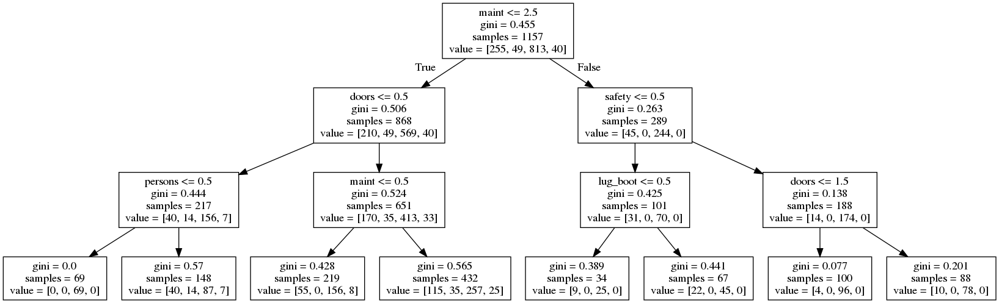

max depth  3
criterion gini
min samples leaf 1
max features 1
Accuracy score  0.6952714535901926


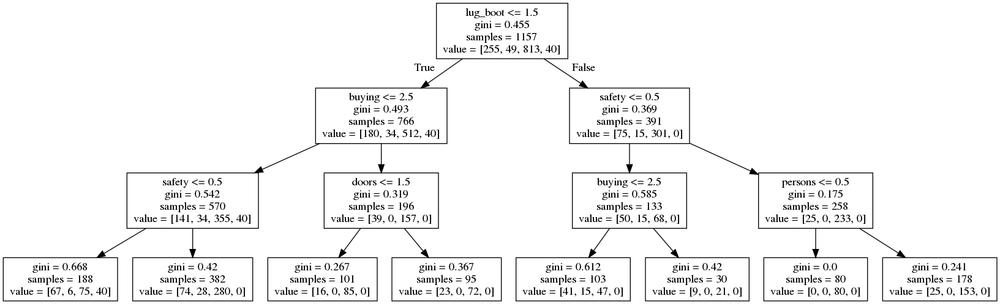

max depth  3
criterion gini
min samples leaf 1
max features 2
Accuracy score  0.6952714535901926


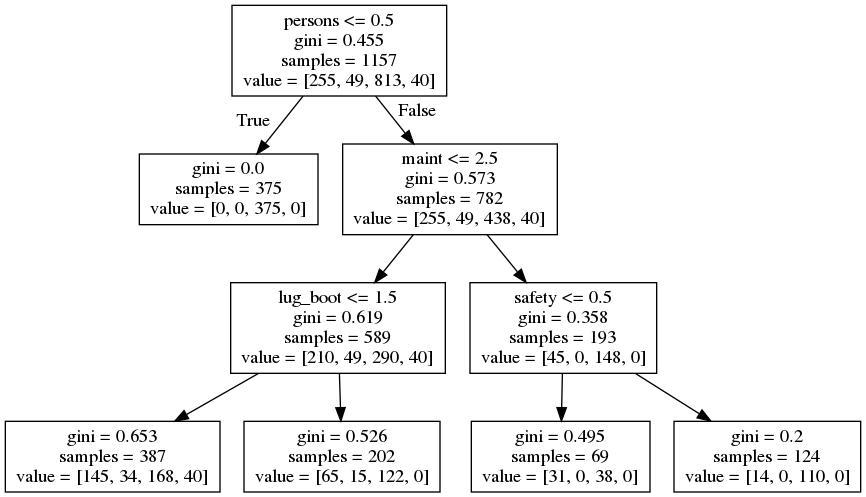

max depth  3
criterion gini
min samples leaf 1
max features 3
Accuracy score  0.6952714535901926


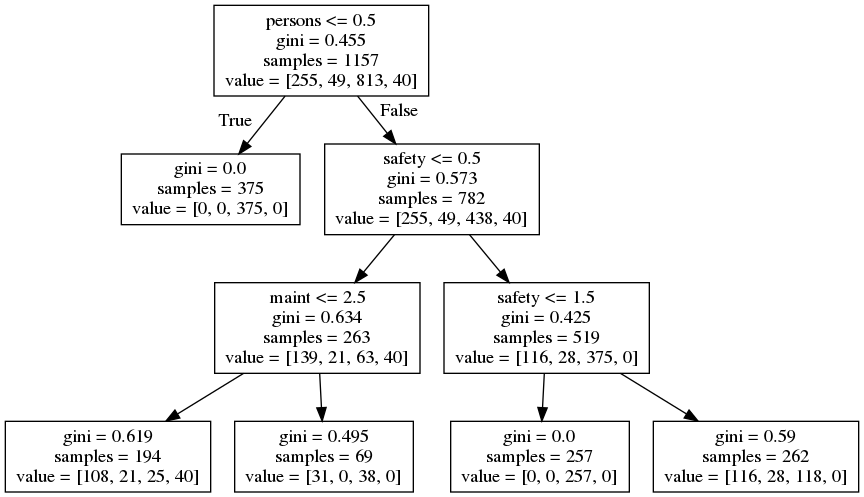

max depth  3
criterion gini
min samples leaf 1
max features 4
Accuracy score  0.7653239929947461


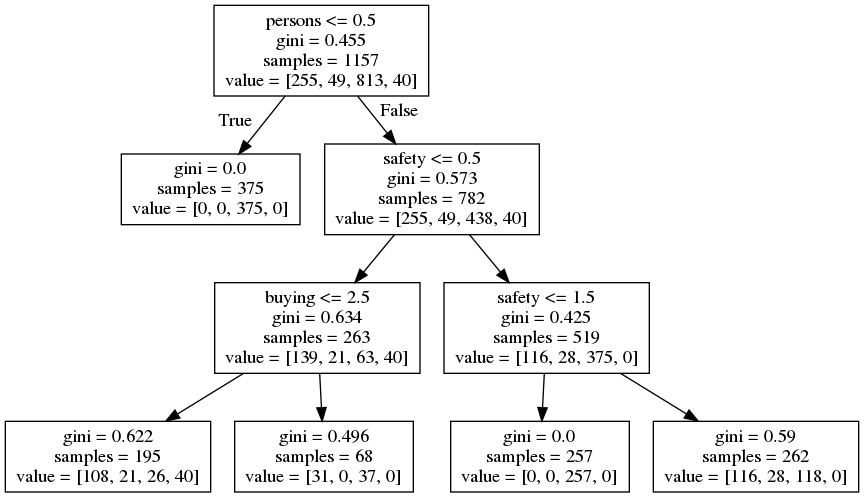

max depth  3
criterion gini
min samples leaf 1
max features 5
Accuracy score  0.7670753064798599


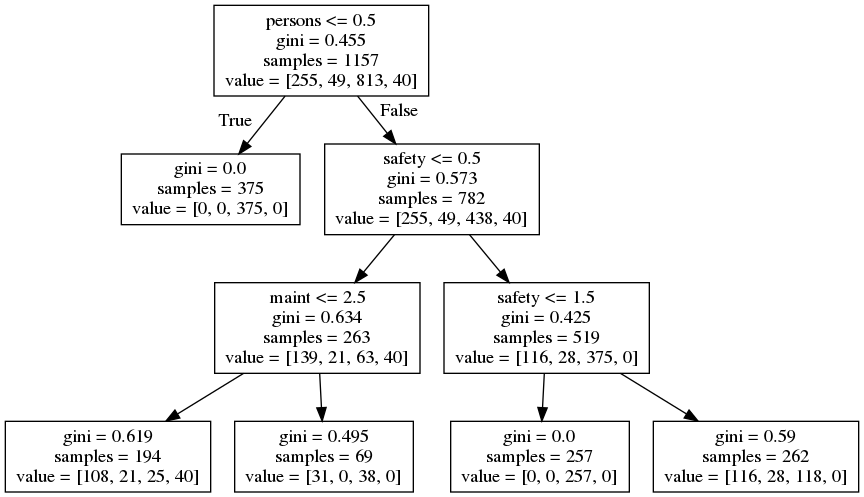

max depth  3
criterion gini
min samples leaf 1
max features 6
Accuracy score  0.7653239929947461


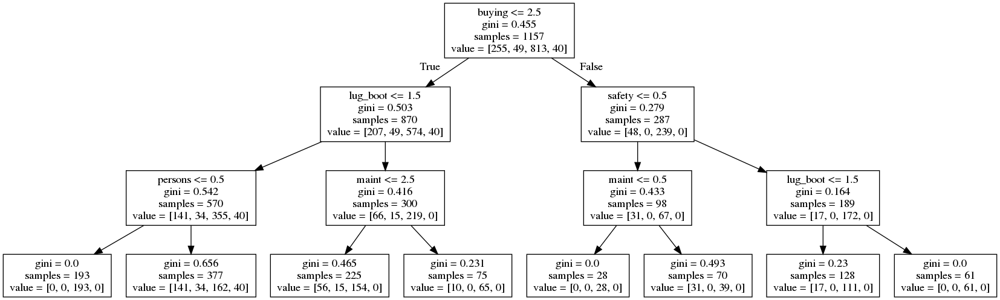

max depth  3
criterion gini
min samples leaf 20
max features 1
Accuracy score  0.6952714535901926


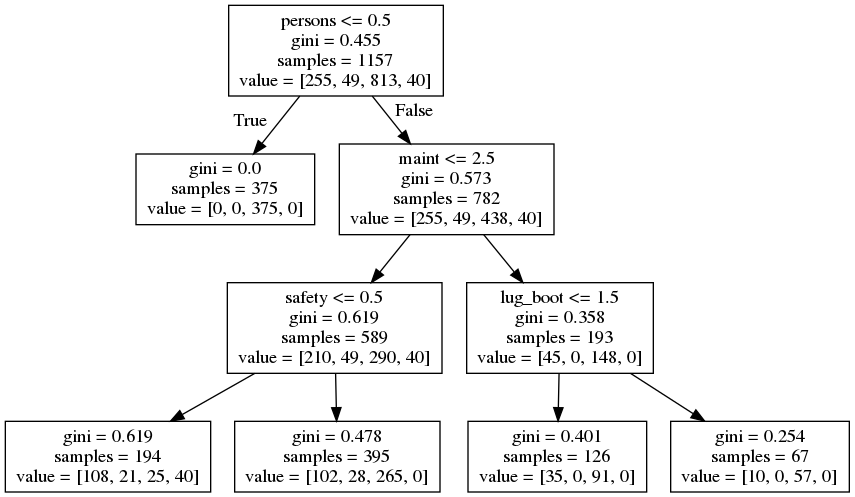

max depth  3
criterion gini
min samples leaf 20
max features 2
Accuracy score  0.7653239929947461


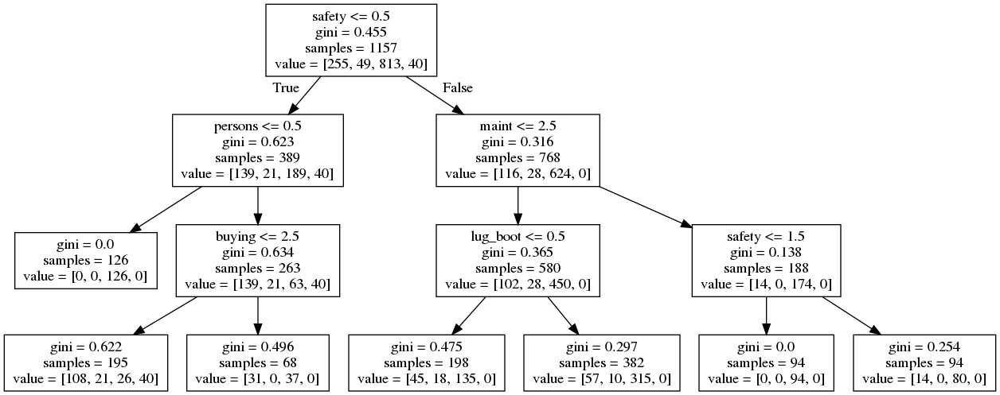

max depth  3
criterion gini
min samples leaf 20
max features 3
Accuracy score  0.7670753064798599


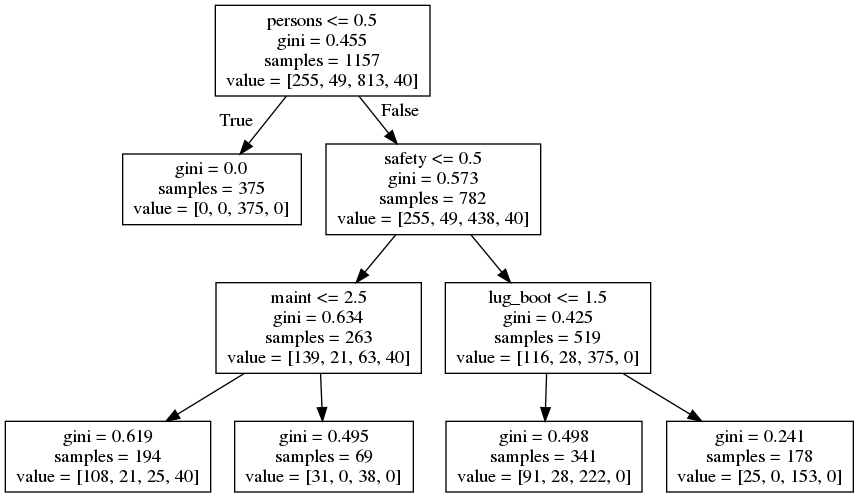

max depth  3
criterion gini
min samples leaf 20
max features 4
Accuracy score  0.7653239929947461


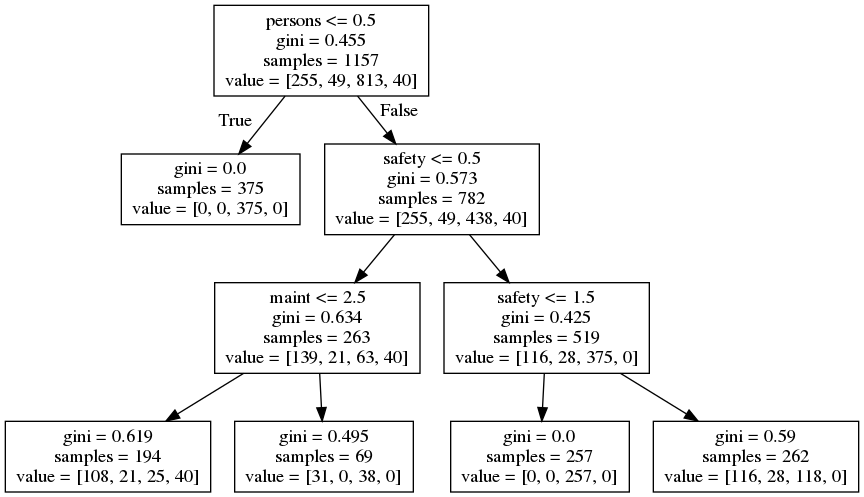

max depth  3
criterion gini
min samples leaf 20
max features 5
Accuracy score  0.7653239929947461


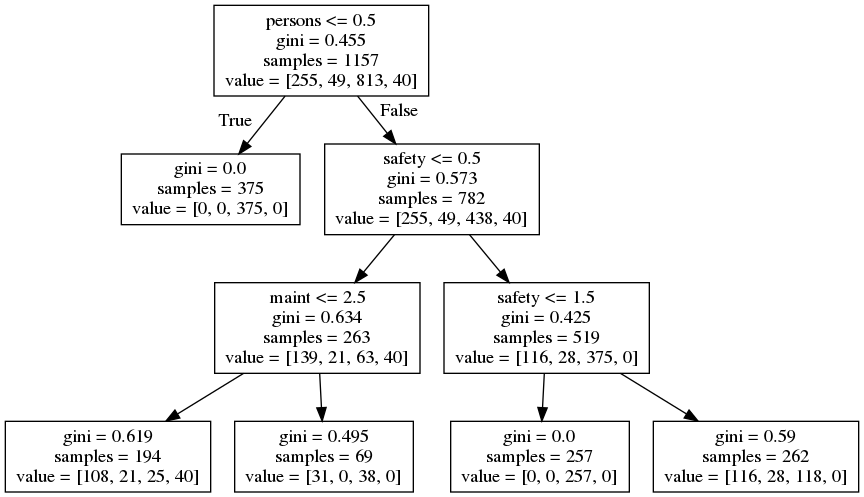

max depth  3
criterion gini
min samples leaf 20
max features 6
Accuracy score  0.7653239929947461


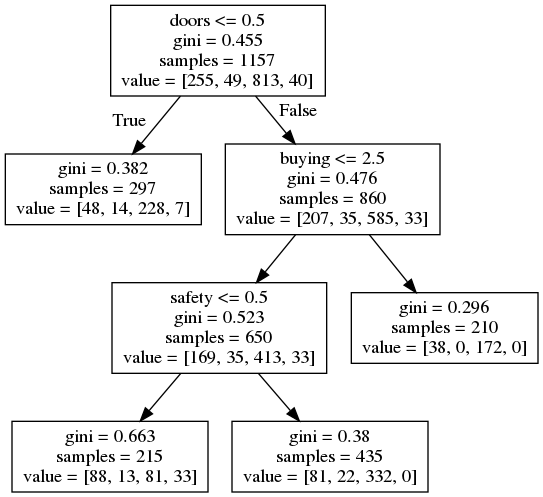

max depth  3
criterion gini
min samples leaf 200
max features 1
Accuracy score  0.6760070052539404


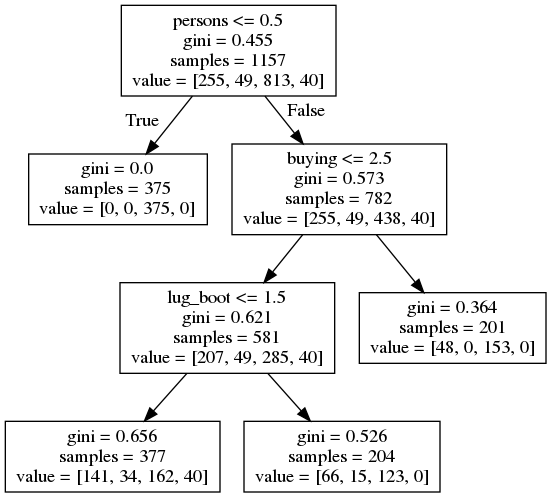

max depth  3
criterion gini
min samples leaf 200
max features 2
Accuracy score  0.6952714535901926


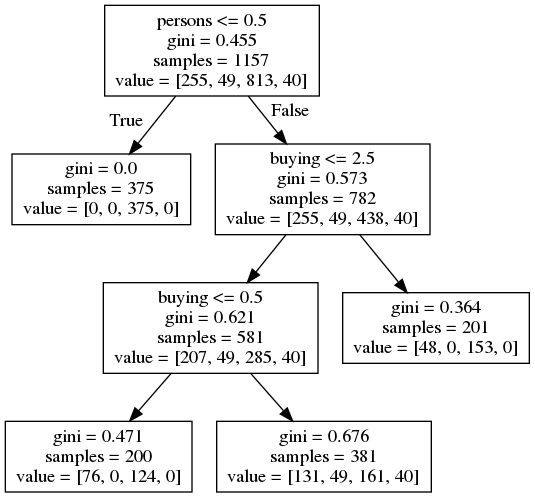

max depth  3
criterion gini
min samples leaf 200
max features 3
Accuracy score  0.6952714535901926


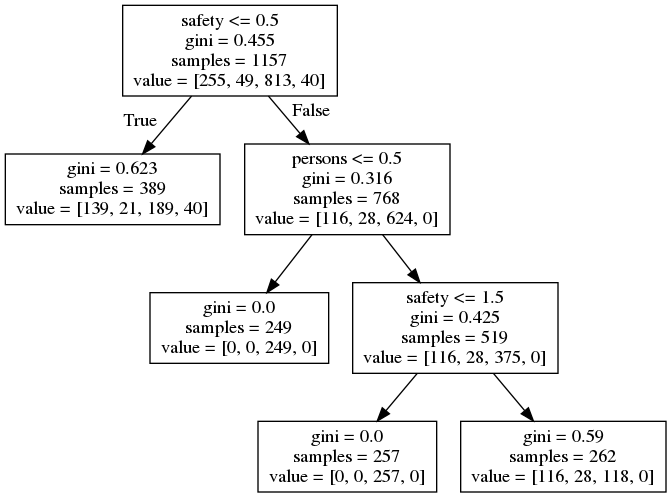

max depth  3
criterion gini
min samples leaf 200
max features 4
Accuracy score  0.6952714535901926


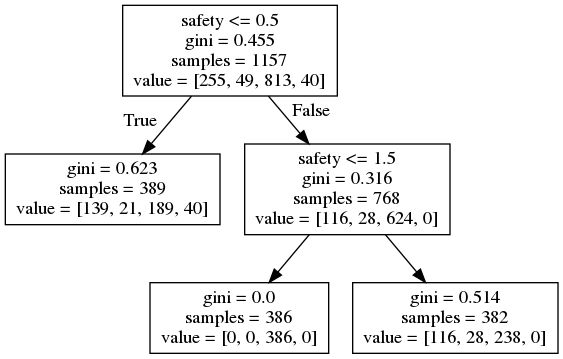

max depth  3
criterion gini
min samples leaf 200
max features 5
Accuracy score  0.6952714535901926


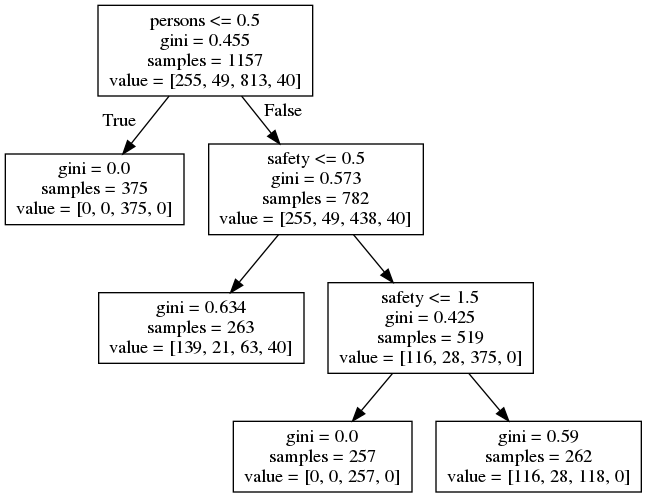

max depth  3
criterion gini
min samples leaf 200
max features 6
Accuracy score  0.7705779334500875


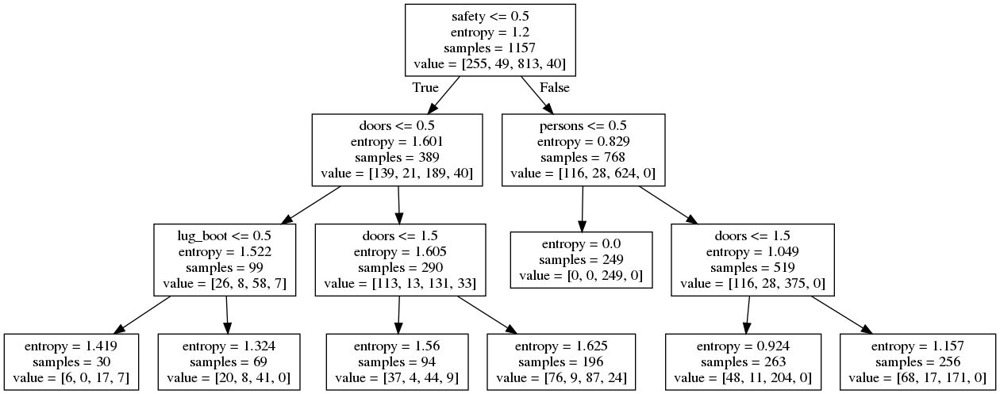

max depth  3
criterion entropy
min samples leaf 1
max features 1
Accuracy score  0.6952714535901926


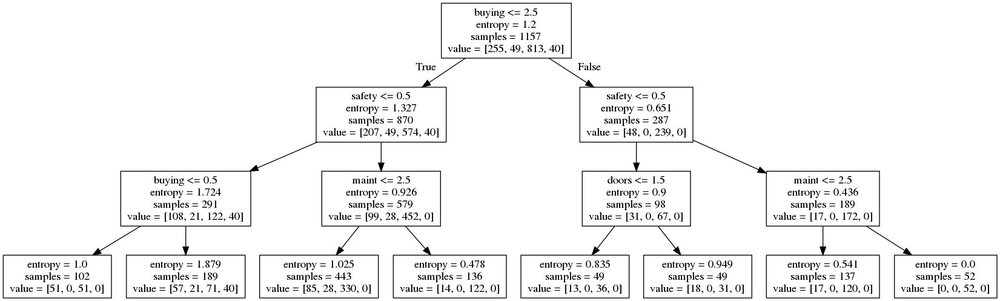

max depth  3
criterion entropy
min samples leaf 1
max features 2
Accuracy score  0.6847635726795096


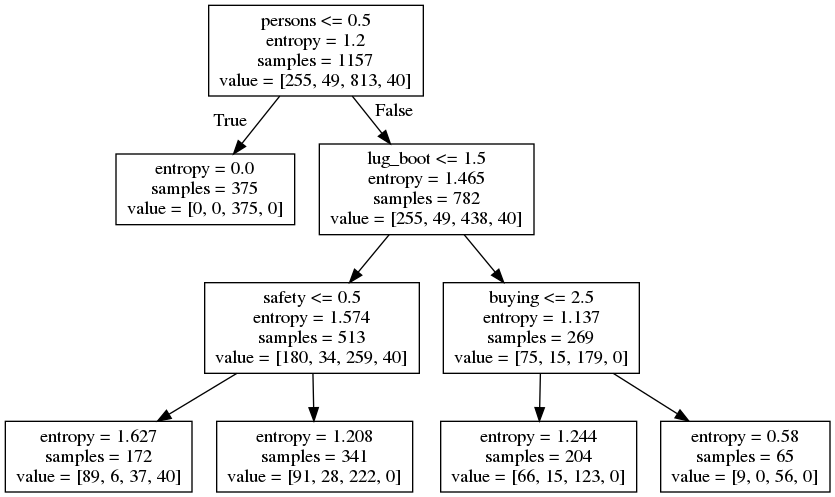

max depth  3
criterion entropy
min samples leaf 1
max features 3
Accuracy score  0.7548161120840631


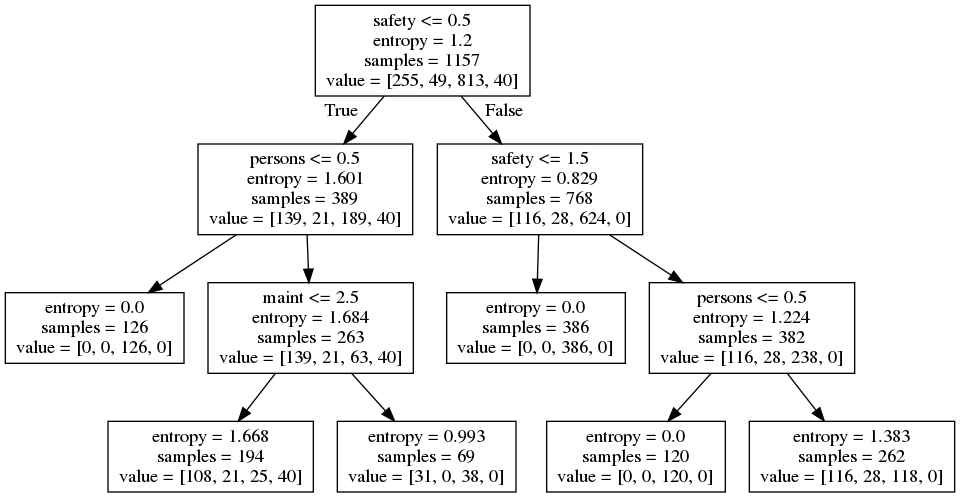

max depth  3
criterion entropy
min samples leaf 1
max features 4
Accuracy score  0.7653239929947461


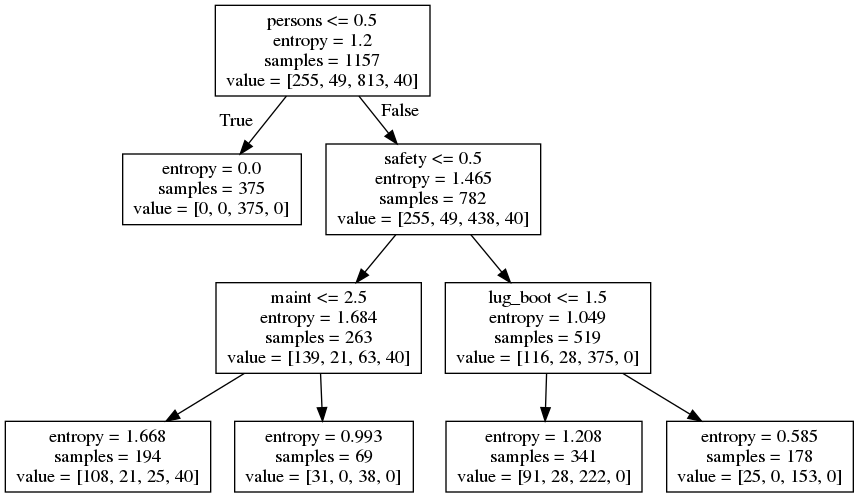

max depth  3
criterion entropy
min samples leaf 1
max features 5
Accuracy score  0.7653239929947461


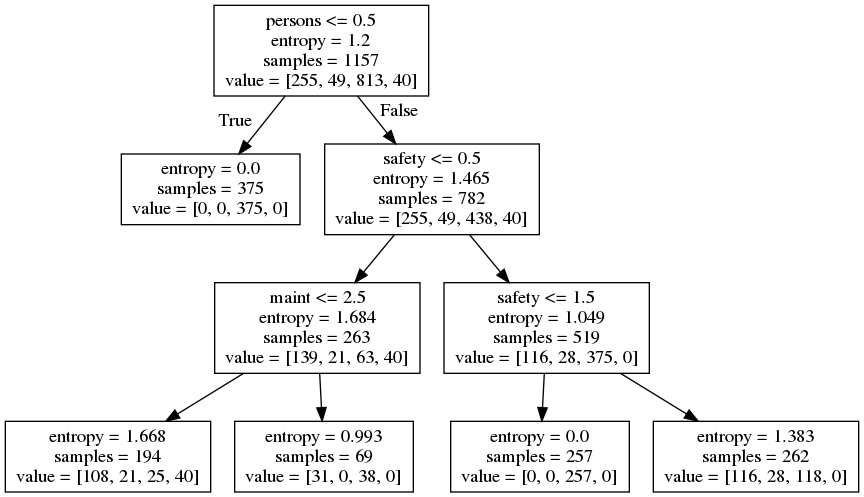

max depth  3
criterion entropy
min samples leaf 1
max features 6
Accuracy score  0.7653239929947461


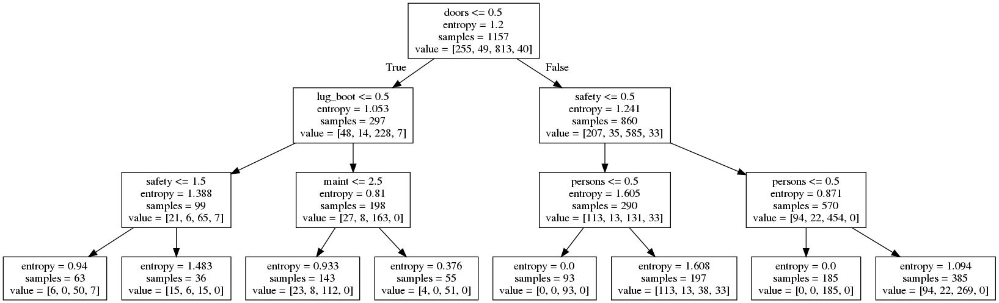

max depth  3
criterion entropy
min samples leaf 20
max features 1
Accuracy score  0.7425569176882661


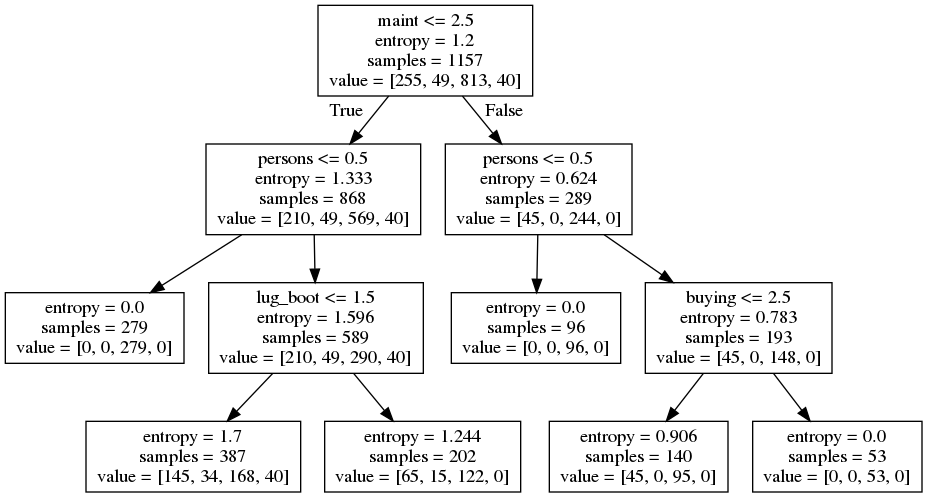

max depth  3
criterion entropy
min samples leaf 20
max features 2
Accuracy score  0.6952714535901926


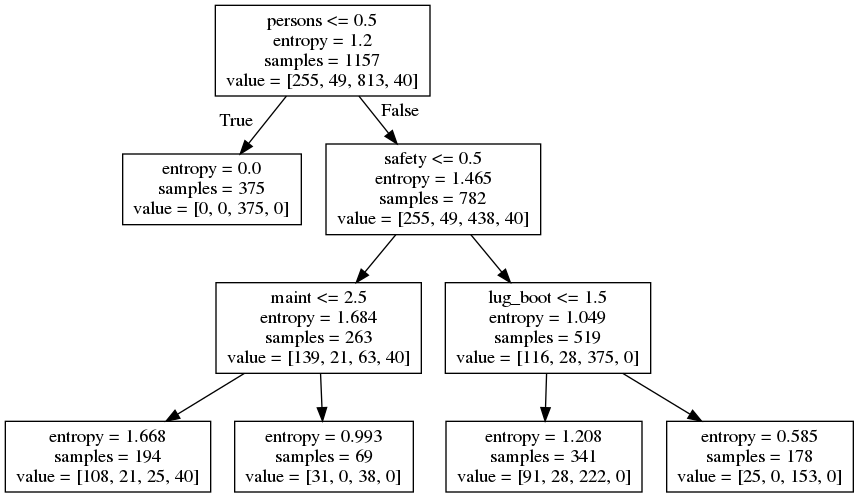

max depth  3
criterion entropy
min samples leaf 20
max features 3
Accuracy score  0.7653239929947461


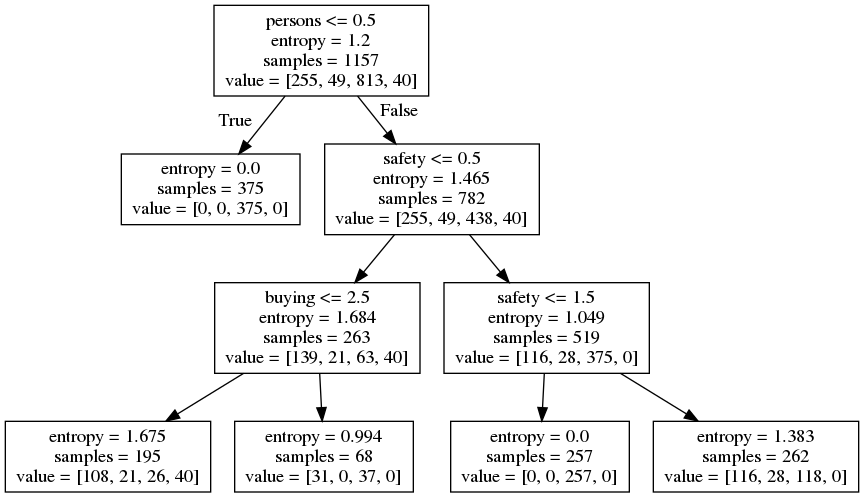

max depth  3
criterion entropy
min samples leaf 20
max features 4
Accuracy score  0.7670753064798599


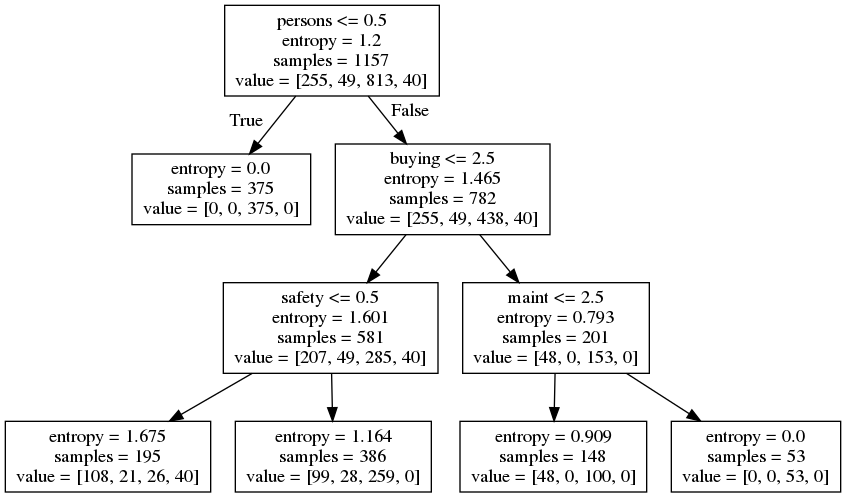

max depth  3
criterion entropy
min samples leaf 20
max features 5
Accuracy score  0.7670753064798599


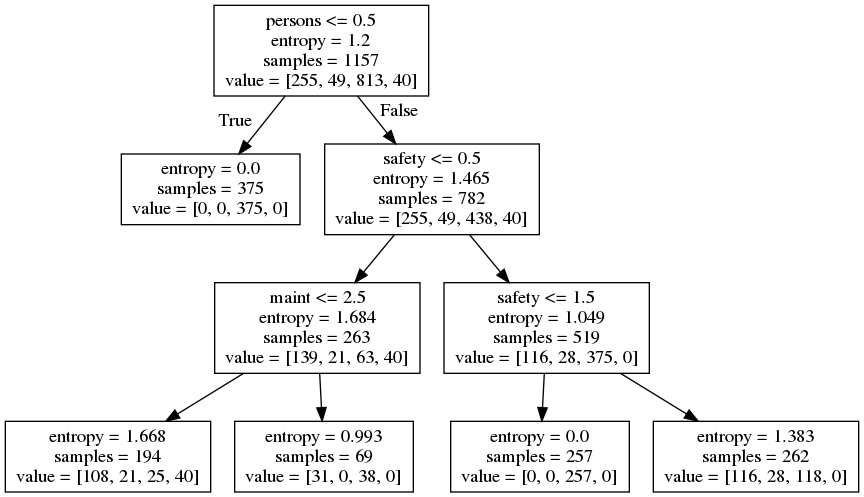

max depth  3
criterion entropy
min samples leaf 20
max features 6
Accuracy score  0.7653239929947461


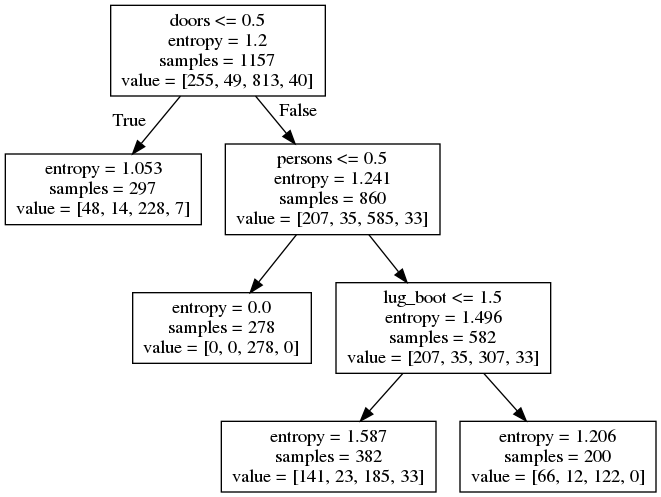

max depth  3
criterion entropy
min samples leaf 200
max features 1
Accuracy score  0.6952714535901926


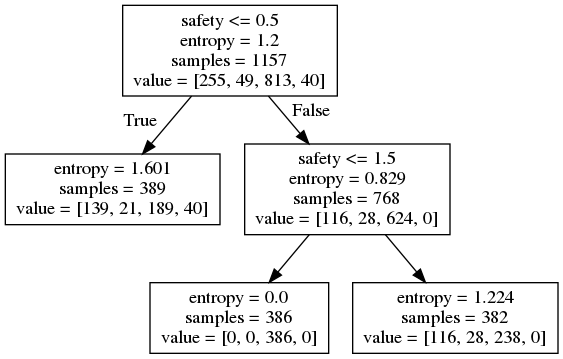

max depth  3
criterion entropy
min samples leaf 200
max features 2
Accuracy score  0.6952714535901926


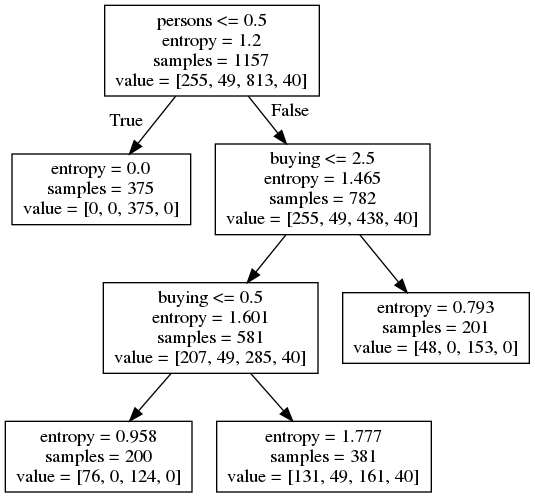

max depth  3
criterion entropy
min samples leaf 200
max features 3
Accuracy score  0.6952714535901926


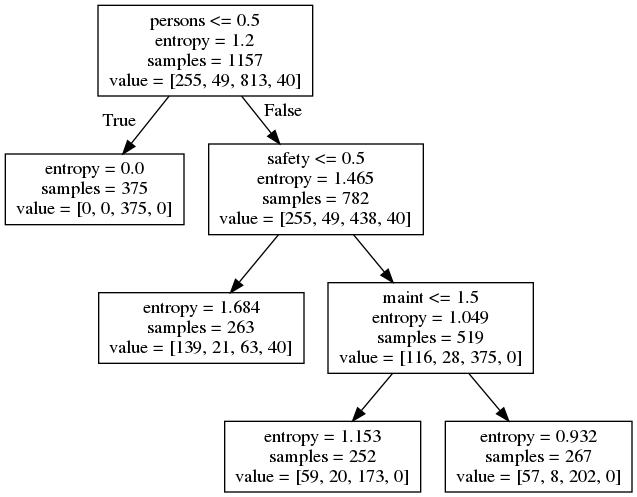

max depth  3
criterion entropy
min samples leaf 200
max features 4
Accuracy score  0.7705779334500875


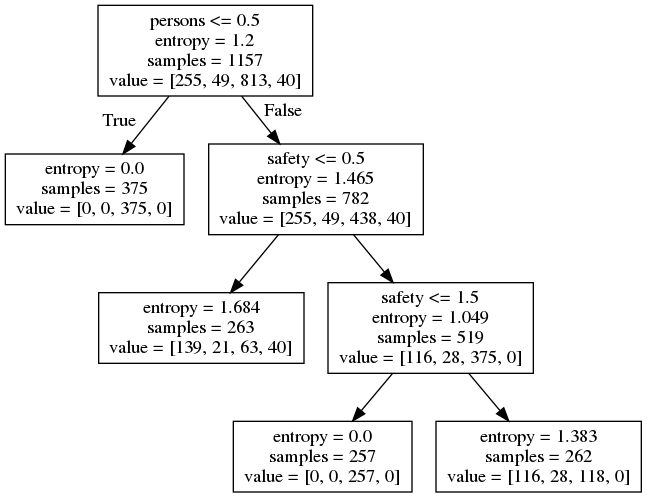

max depth  3
criterion entropy
min samples leaf 200
max features 5
Accuracy score  0.7705779334500875


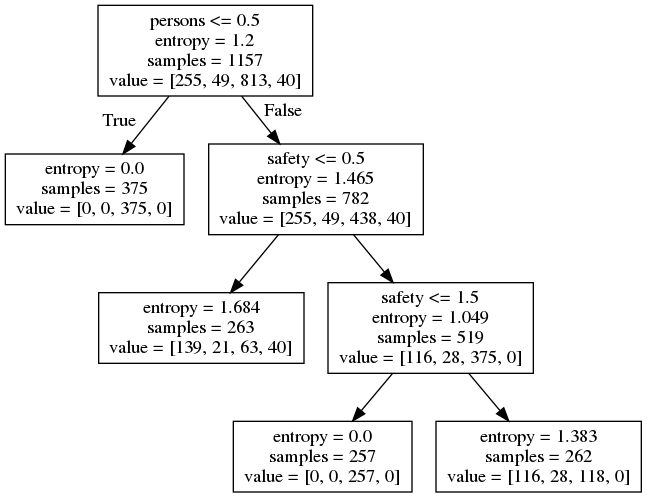

max depth  3
criterion entropy
min samples leaf 200
max features 6
Accuracy score  0.7705779334500875


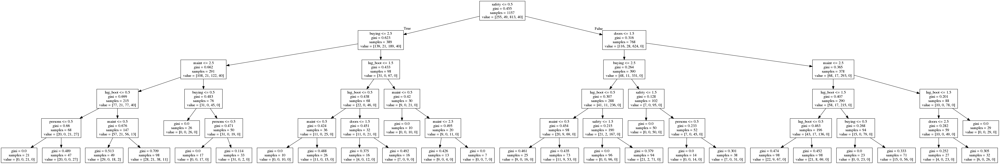

max depth  5
criterion gini
min samples leaf 1
max features 1
Accuracy score  0.7460595446584939


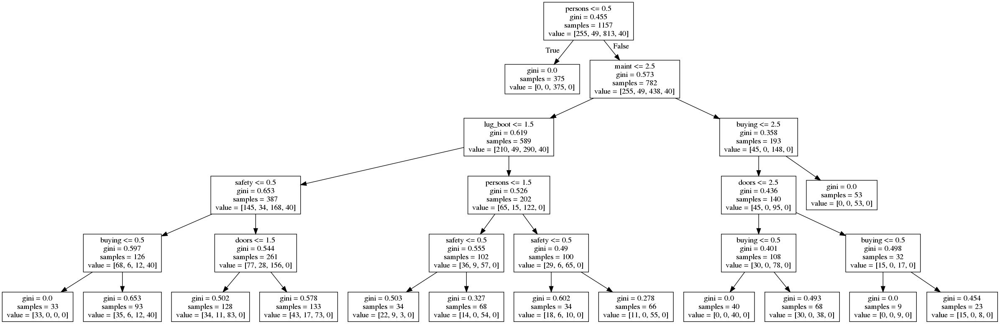

max depth  5
criterion gini
min samples leaf 1
max features 2
Accuracy score  0.7705779334500875


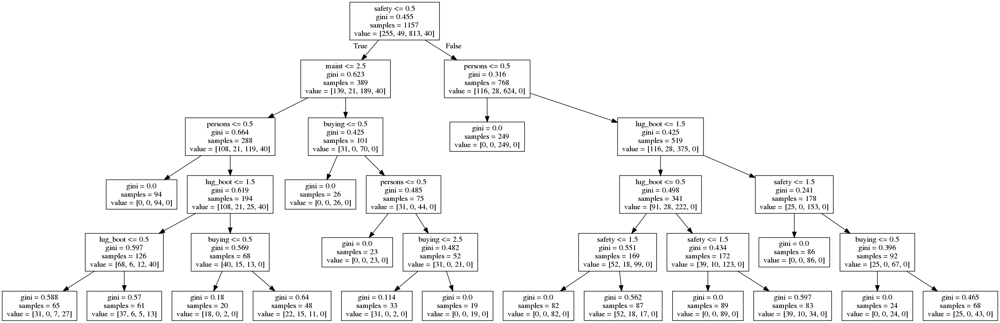

max depth  5
criterion gini
min samples leaf 1
max features 3
Accuracy score  0.8493870402802102


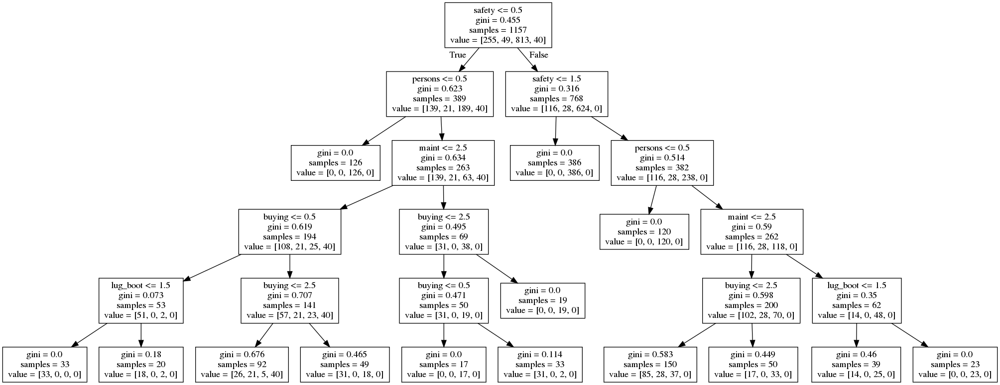

max depth  5
criterion gini
min samples leaf 1
max features 4
Accuracy score  0.8598949211908932


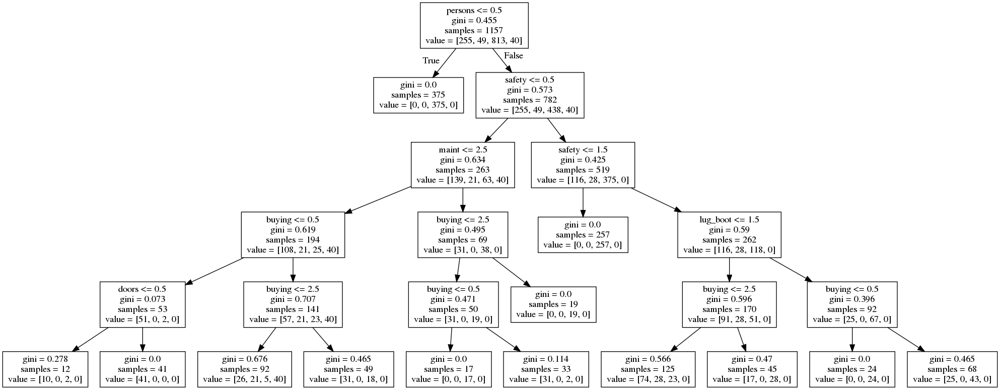

max depth  5
criterion gini
min samples leaf 1
max features 5
Accuracy score  0.8651488616462347


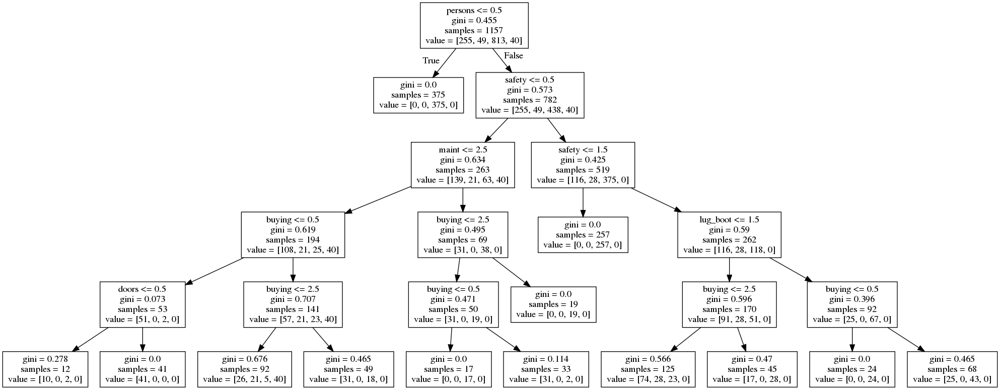

max depth  5
criterion gini
min samples leaf 1
max features 6
Accuracy score  0.8651488616462347


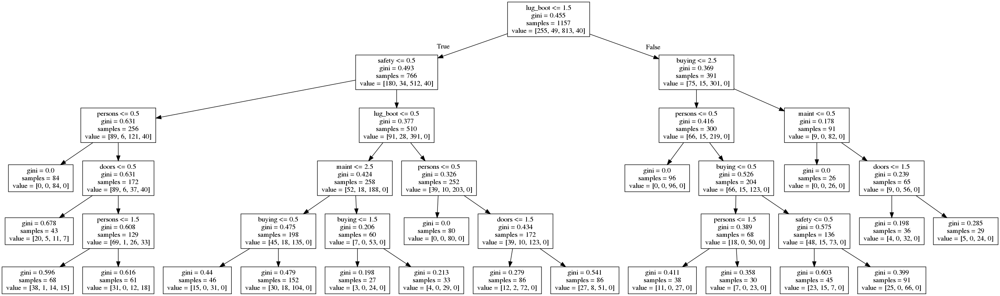

max depth  5
criterion gini
min samples leaf 20
max features 1
Accuracy score  0.7740805604203153


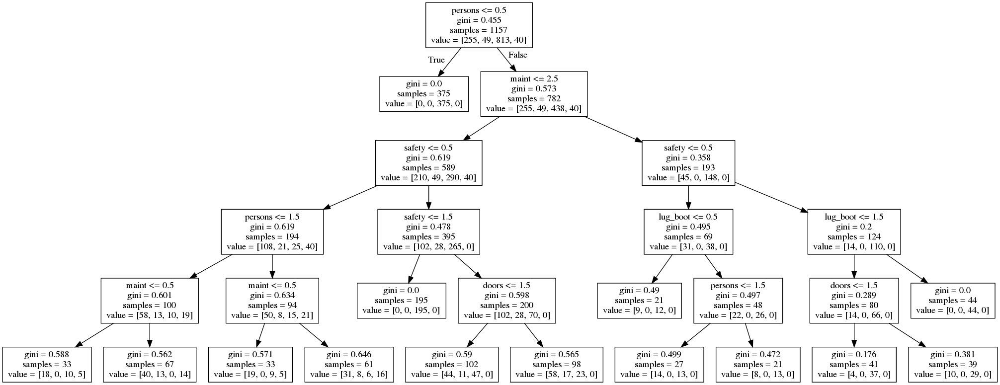

max depth  5
criterion gini
min samples leaf 20
max features 2
Accuracy score  0.7863397548161121


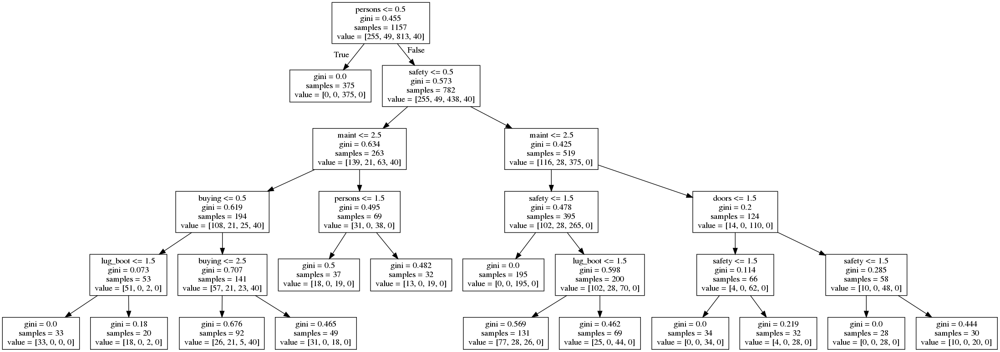

max depth  5
criterion gini
min samples leaf 20
max features 3
Accuracy score  0.8388791593695272


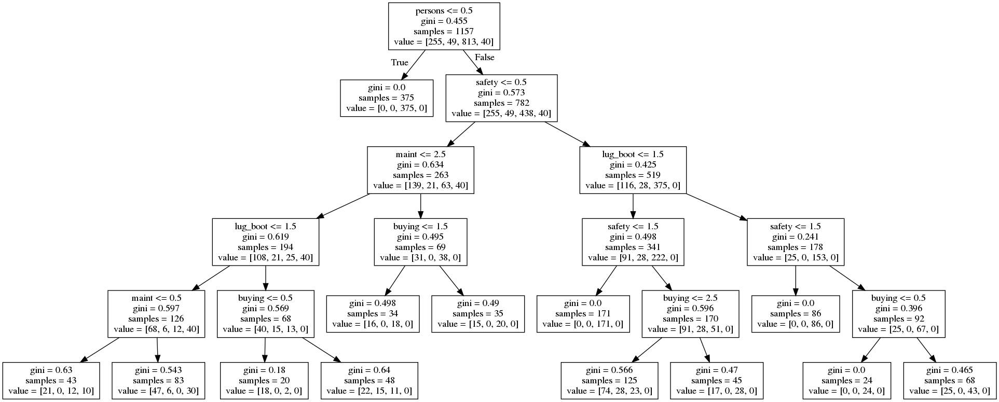

max depth  5
criterion gini
min samples leaf 20
max features 4
Accuracy score  0.8248686514886164


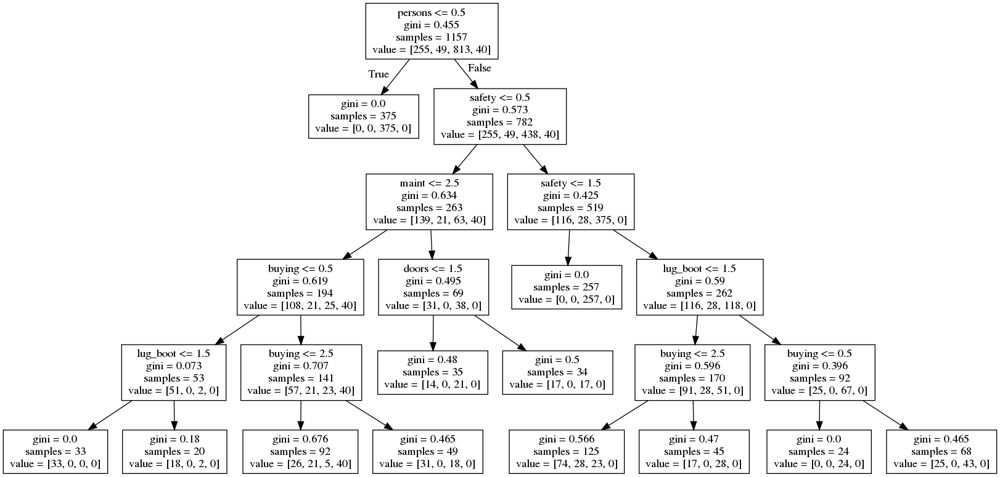

max depth  5
criterion gini
min samples leaf 20
max features 5
Accuracy score  0.8388791593695272


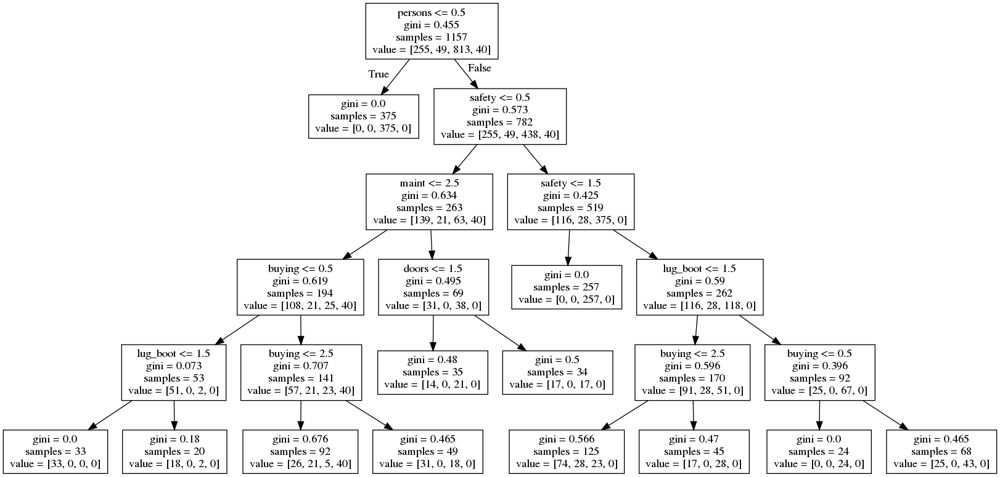

max depth  5
criterion gini
min samples leaf 20
max features 6
Accuracy score  0.8388791593695272


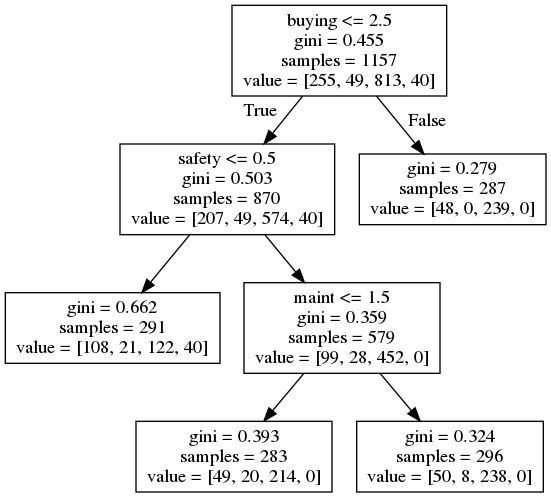

max depth  5
criterion gini
min samples leaf 200
max features 1
Accuracy score  0.6952714535901926


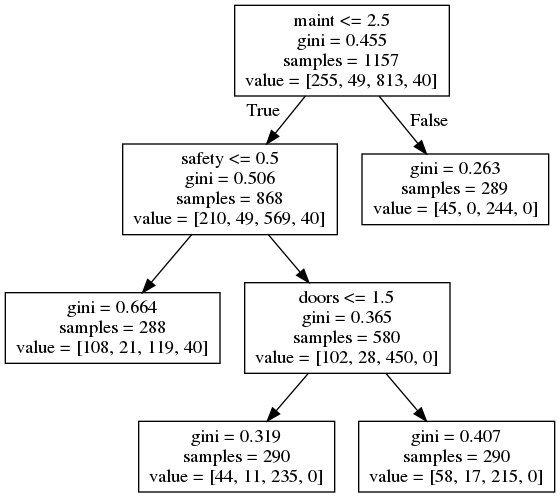

max depth  5
criterion gini
min samples leaf 200
max features 2
Accuracy score  0.6952714535901926


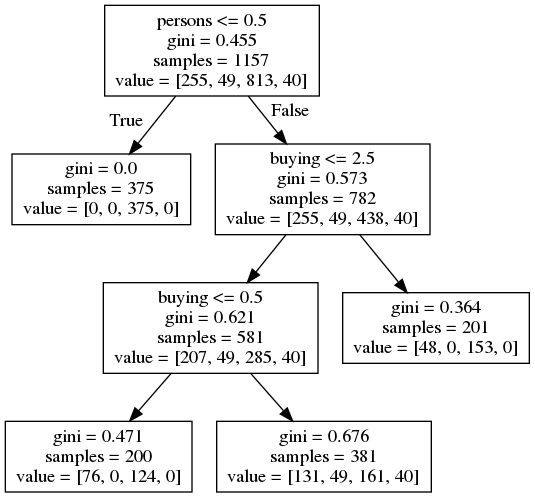

max depth  5
criterion gini
min samples leaf 200
max features 3
Accuracy score  0.6952714535901926


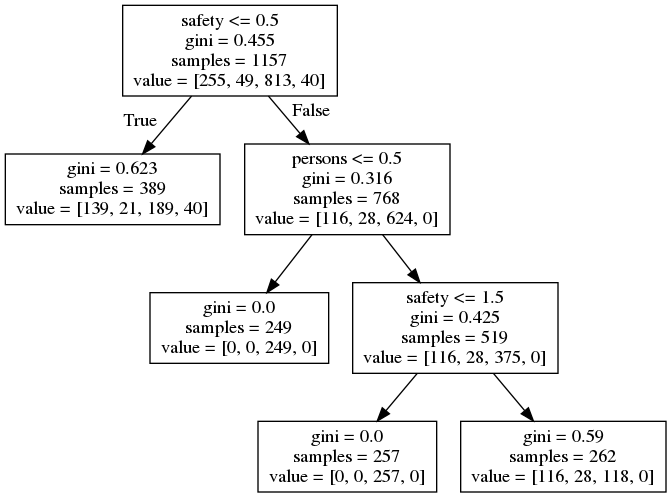

max depth  5
criterion gini
min samples leaf 200
max features 4
Accuracy score  0.6952714535901926


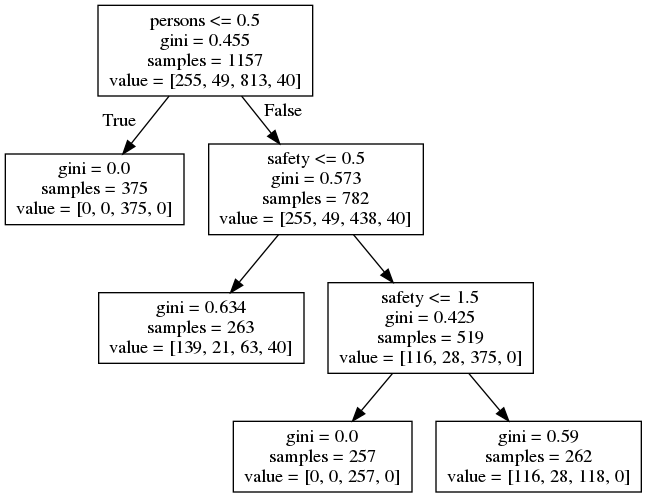

max depth  5
criterion gini
min samples leaf 200
max features 5
Accuracy score  0.7705779334500875


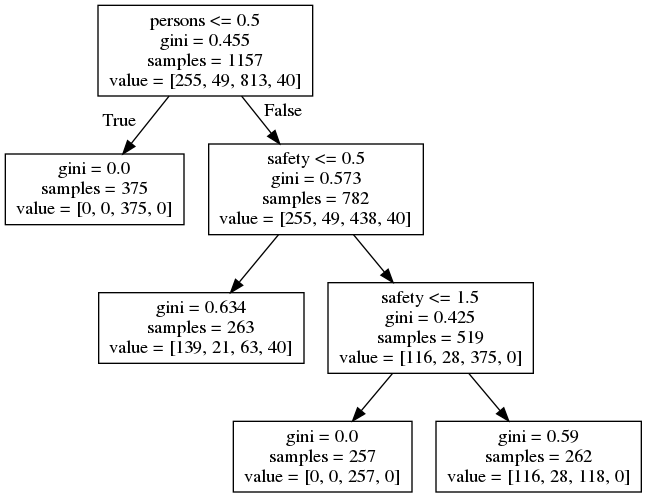

max depth  5
criterion gini
min samples leaf 200
max features 6
Accuracy score  0.7705779334500875


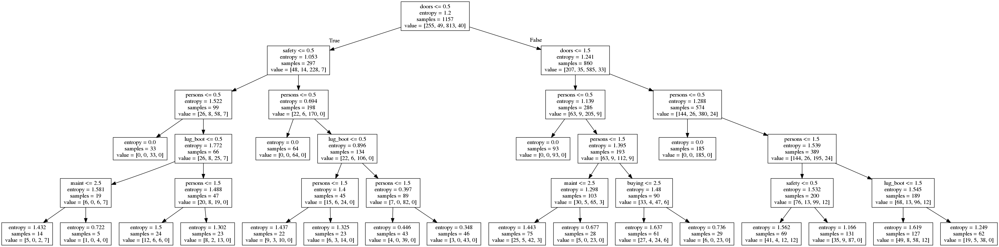

max depth  5
criterion entropy
min samples leaf 1
max features 1
Accuracy score  0.7057793345008757


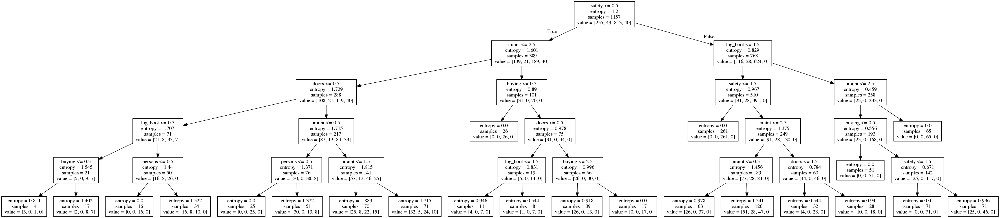

max depth  5
criterion entropy
min samples leaf 1
max features 2
Accuracy score  0.712784588441331


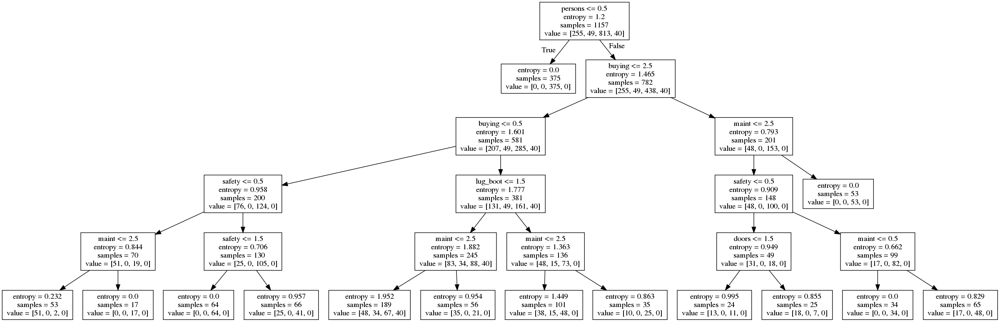

max depth  5
criterion entropy
min samples leaf 1
max features 3
Accuracy score  0.7478108581436077


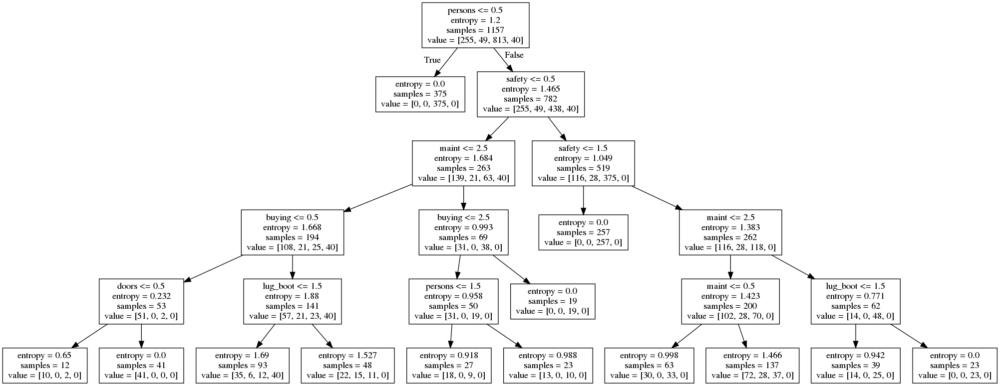

max depth  5
criterion entropy
min samples leaf 1
max features 4
Accuracy score  0.8283712784588442


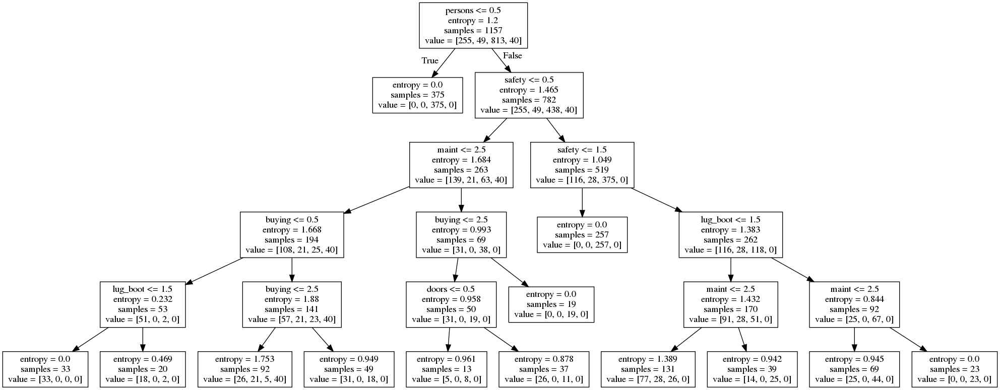

max depth  5
criterion entropy
min samples leaf 1
max features 5
Accuracy score  0.8441330998248686


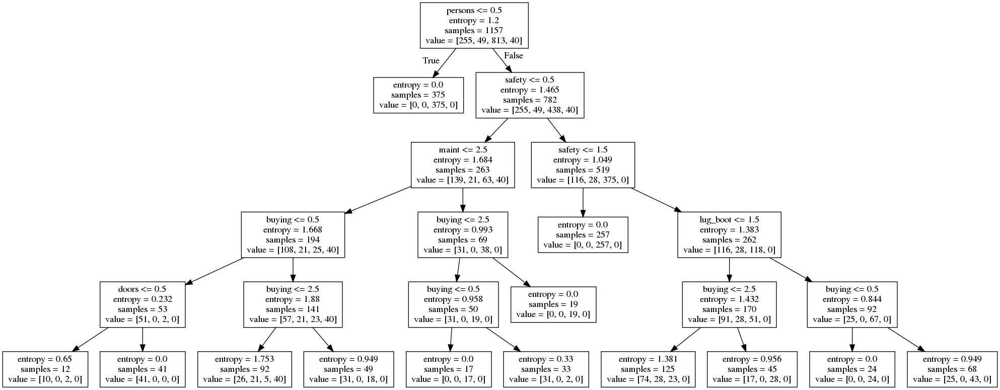

max depth  5
criterion entropy
min samples leaf 1
max features 6
Accuracy score  0.8651488616462347


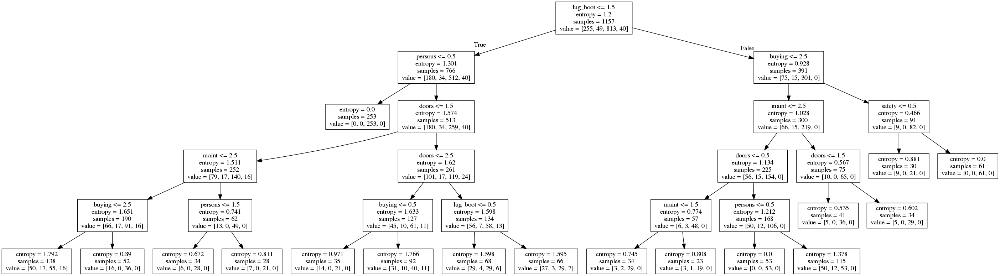

max depth  5
criterion entropy
min samples leaf 20
max features 1
Accuracy score  0.681260945709282


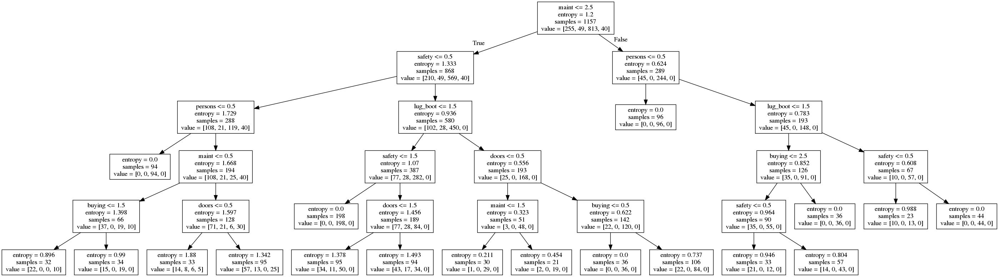

max depth  5
criterion entropy
min samples leaf 20
max features 2
Accuracy score  0.7723292469352014


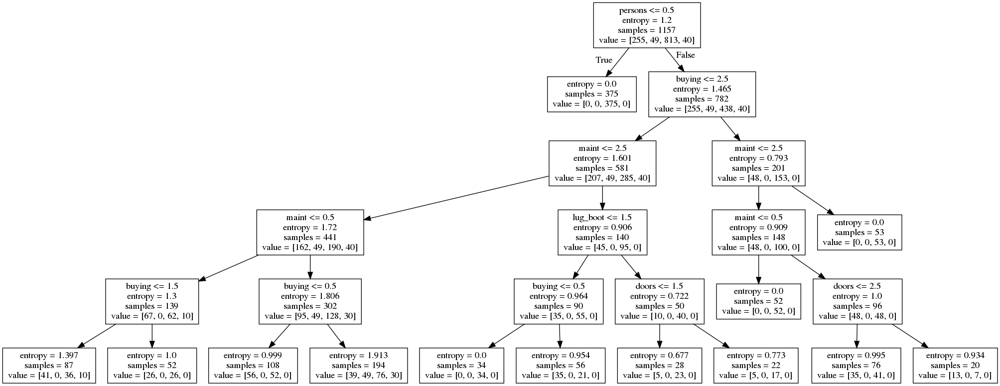

max depth  5
criterion entropy
min samples leaf 20
max features 3
Accuracy score  0.6987740805604203


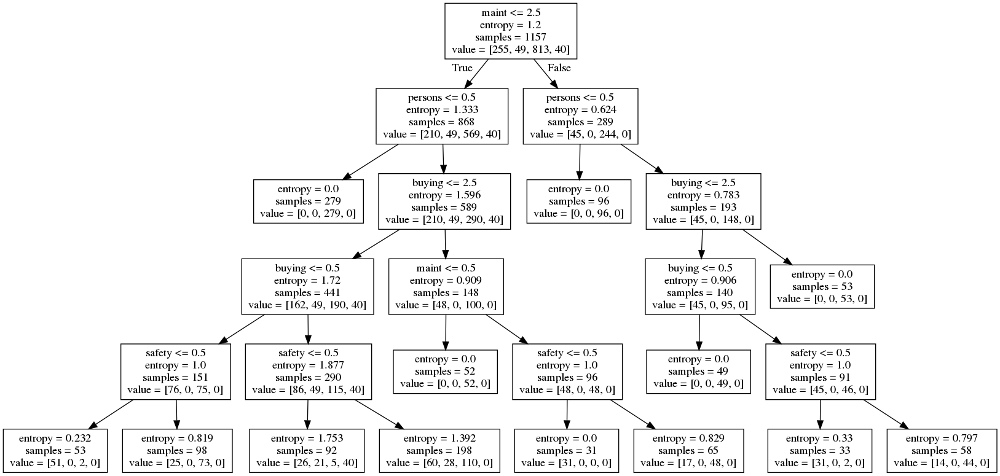

max depth  5
criterion entropy
min samples leaf 20
max features 4
Accuracy score  0.8161120840630472


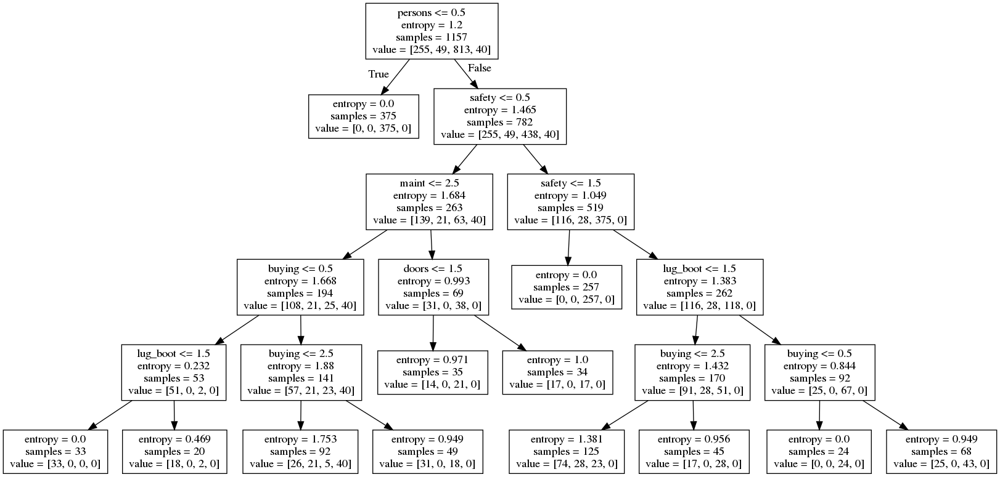

max depth  5
criterion entropy
min samples leaf 20
max features 5
Accuracy score  0.8388791593695272


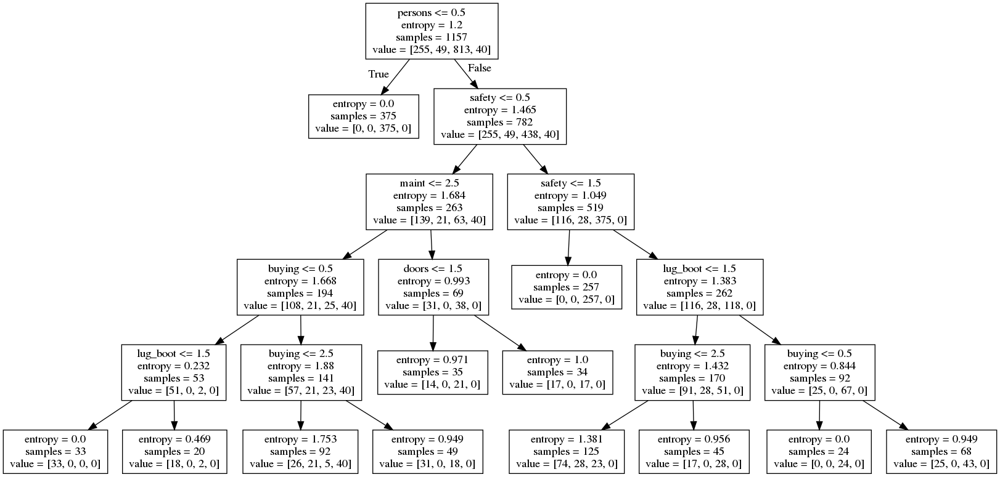

max depth  5
criterion entropy
min samples leaf 20
max features 6
Accuracy score  0.8388791593695272


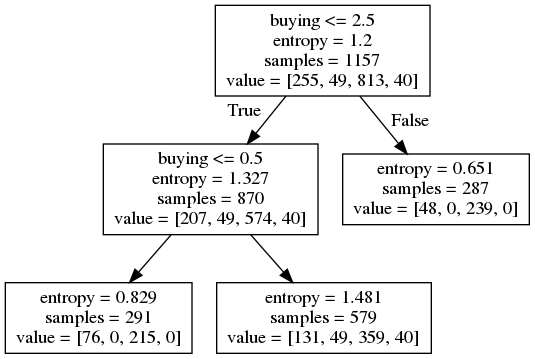

max depth  5
criterion entropy
min samples leaf 200
max features 1
Accuracy score  0.6952714535901926


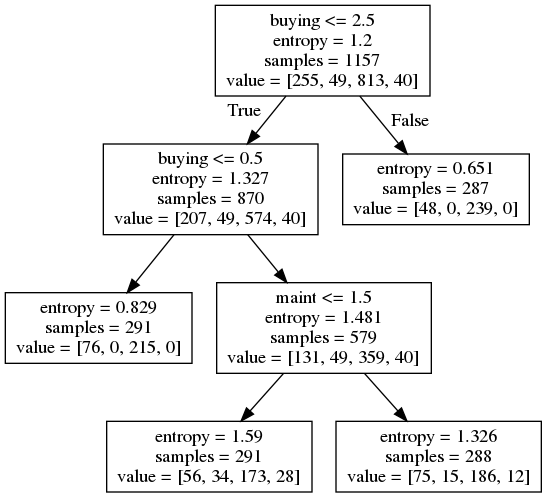

max depth  5
criterion entropy
min samples leaf 200
max features 2
Accuracy score  0.6952714535901926


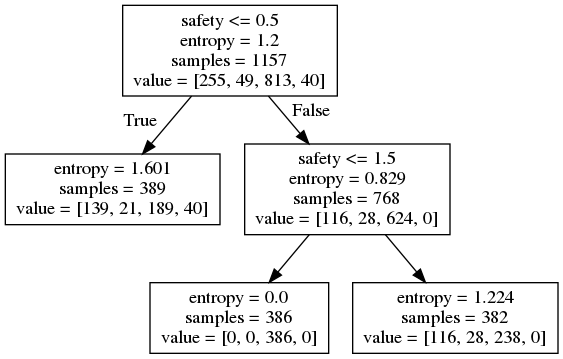

max depth  5
criterion entropy
min samples leaf 200
max features 3
Accuracy score  0.6952714535901926


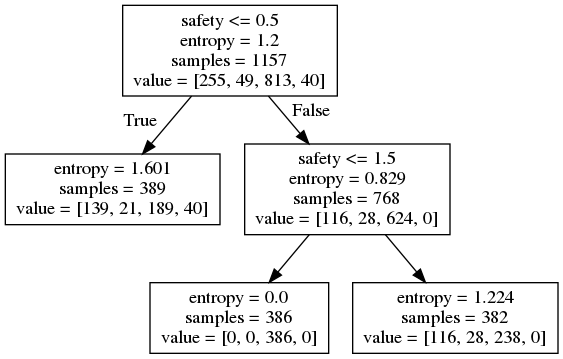

max depth  5
criterion entropy
min samples leaf 200
max features 4
Accuracy score  0.6952714535901926


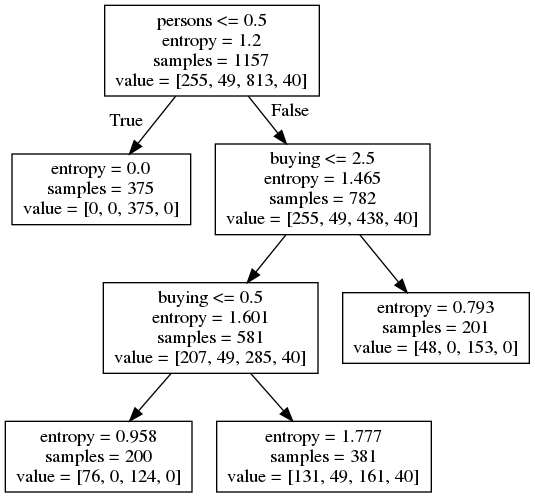

max depth  5
criterion entropy
min samples leaf 200
max features 5
Accuracy score  0.6952714535901926


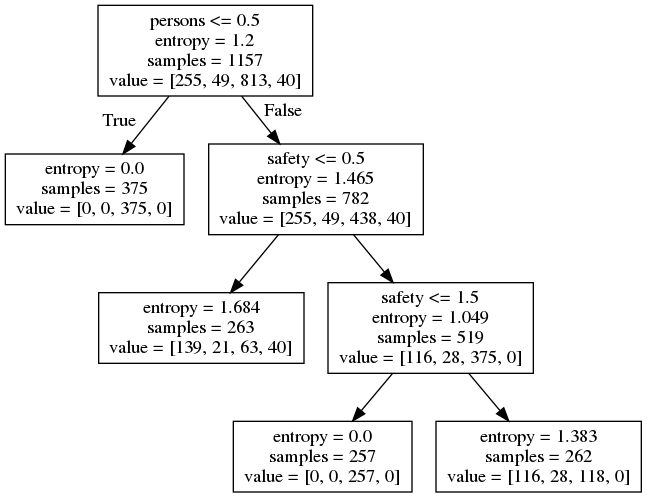

max depth  5
criterion entropy
min samples leaf 200
max features 6
Accuracy score  0.7705779334500875


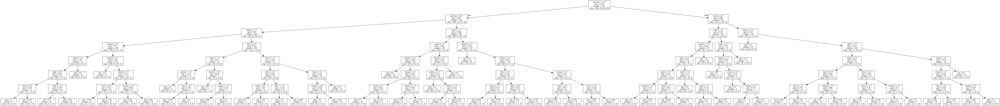

max depth  7
criterion gini
min samples leaf 1
max features 1
Accuracy score  0.6795096322241682


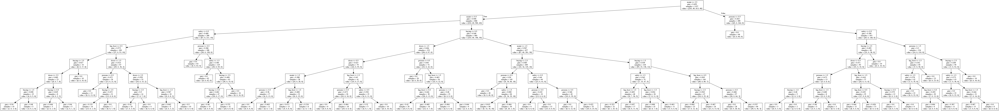

max depth  7
criterion gini
min samples leaf 1
max features 2
Accuracy score  0.7653239929947461


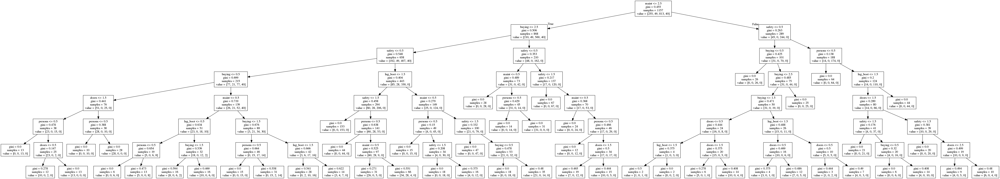

max depth  7
criterion gini
min samples leaf 1
max features 3
Accuracy score  0.8336252189141856


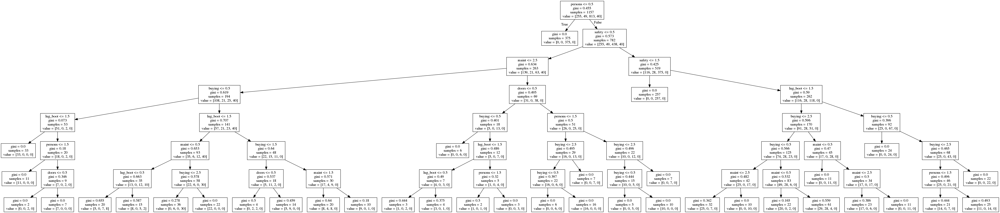

max depth  7
criterion gini
min samples leaf 1
max features 4
Accuracy score  0.9036777583187391


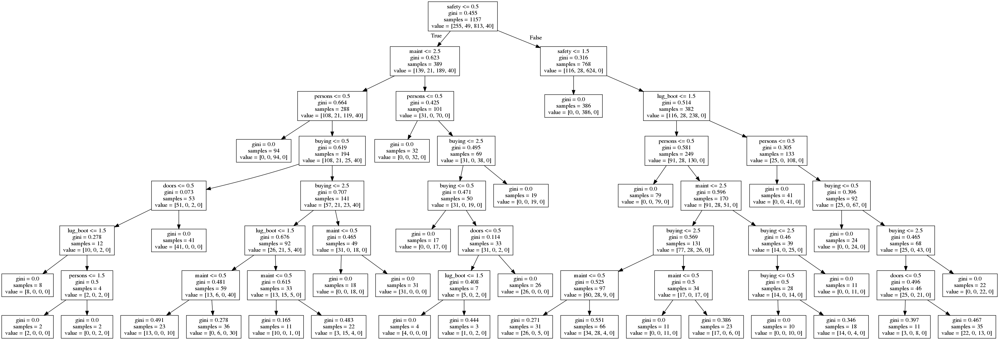

max depth  7
criterion gini
min samples leaf 1
max features 5
Accuracy score  0.9299474605954466


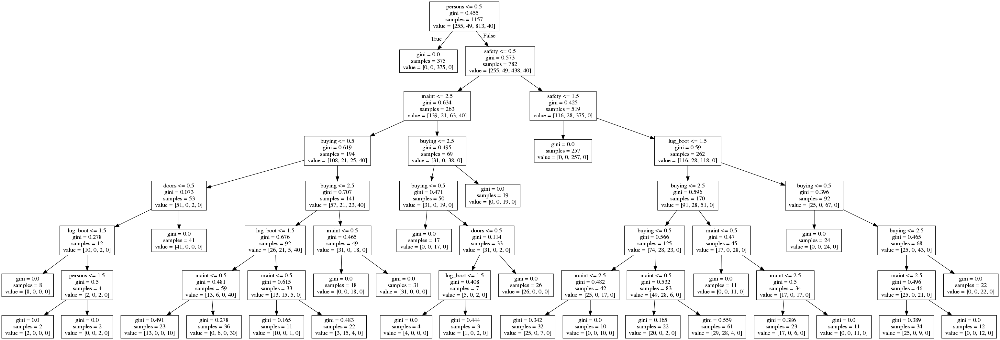

max depth  7
criterion gini
min samples leaf 1
max features 6
Accuracy score  0.9352014010507881


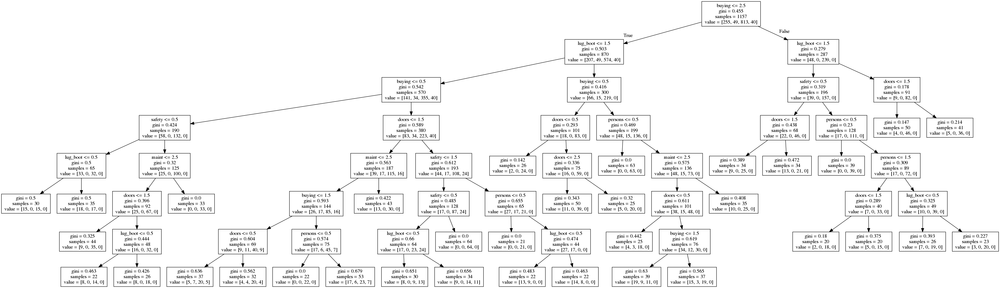

max depth  7
criterion gini
min samples leaf 20
max features 1
Accuracy score  0.712784588441331


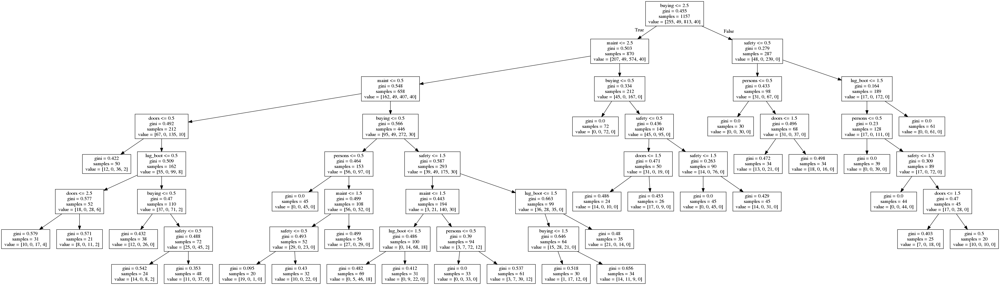

max depth  7
criterion gini
min samples leaf 20
max features 2
Accuracy score  0.7215411558669002


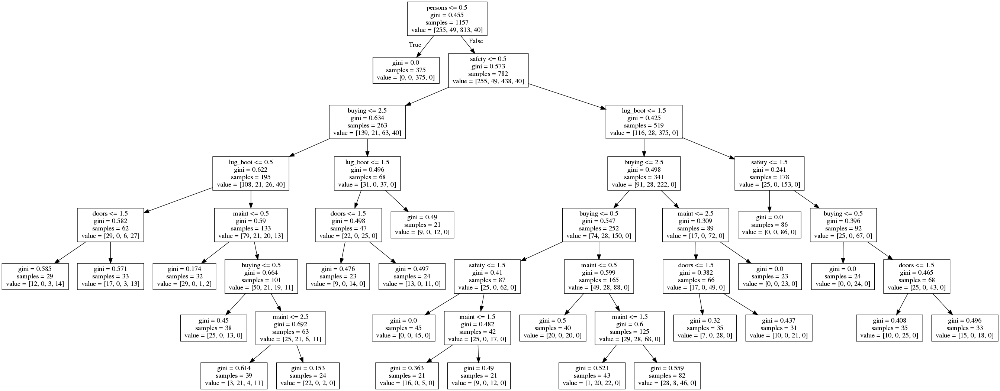

max depth  7
criterion gini
min samples leaf 20
max features 3
Accuracy score  0.7618213660245184


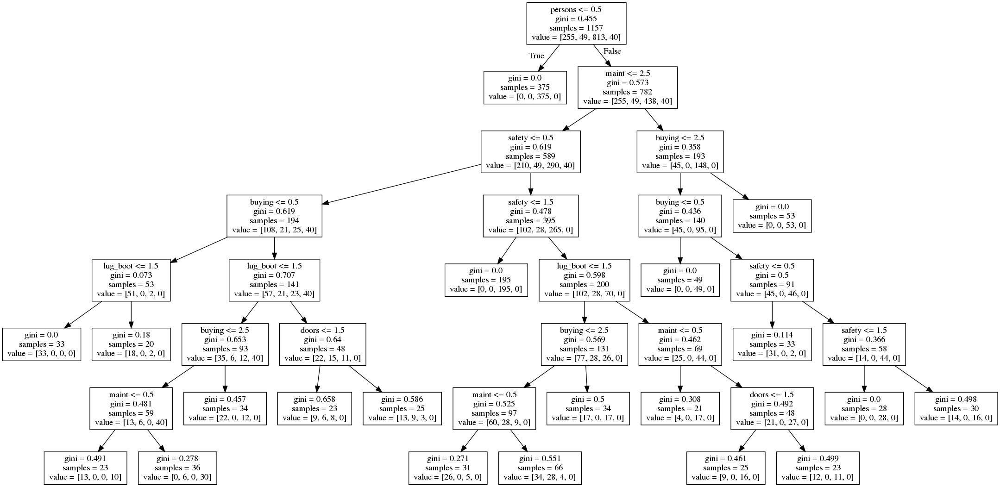

max depth  7
criterion gini
min samples leaf 20
max features 4
Accuracy score  0.882661996497373


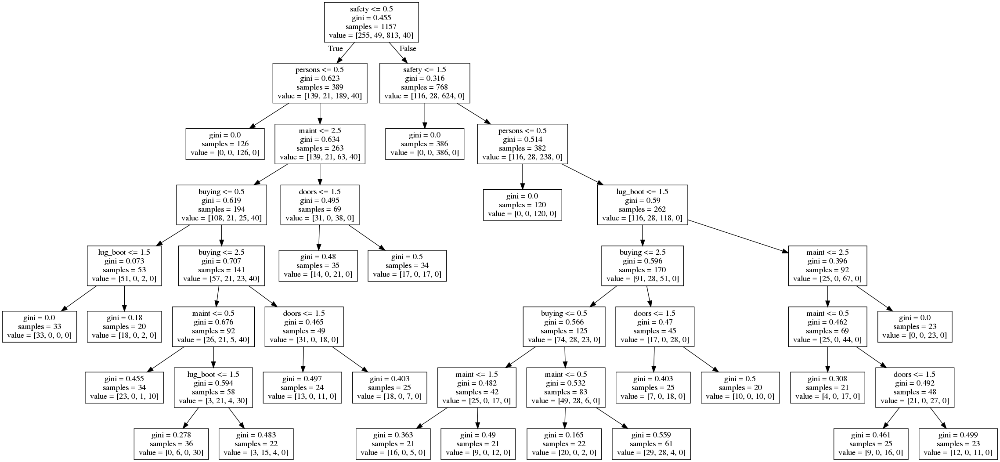

max depth  7
criterion gini
min samples leaf 20
max features 5
Accuracy score  0.8651488616462347


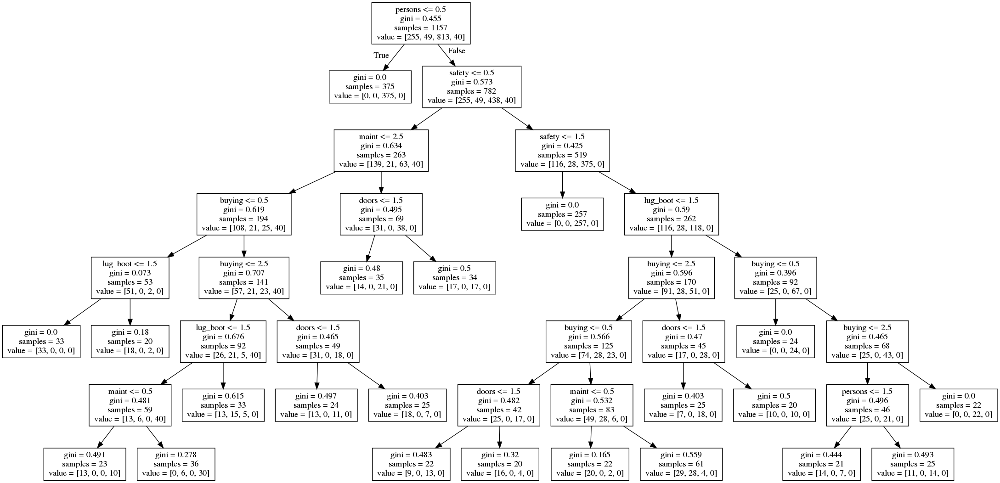

max depth  7
criterion gini
min samples leaf 20
max features 6
Accuracy score  0.8528896672504378


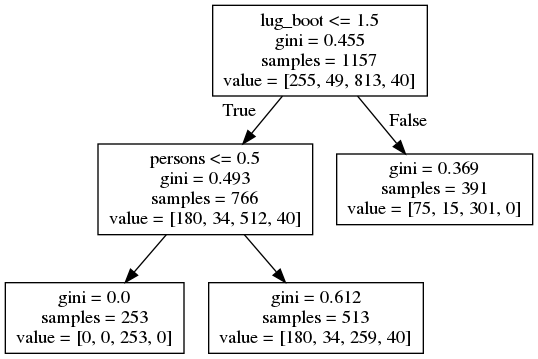

max depth  7
criterion gini
min samples leaf 200
max features 1
Accuracy score  0.6952714535901926


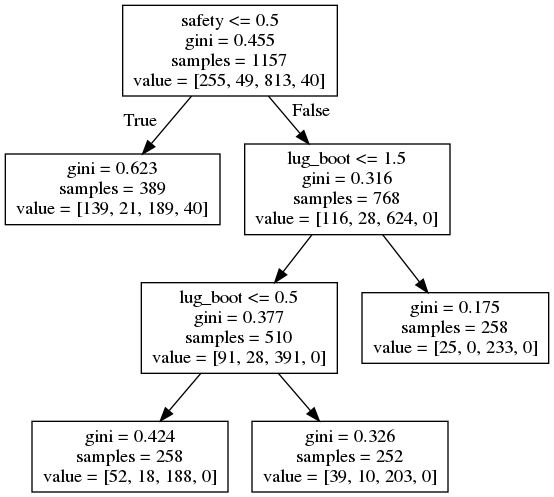

max depth  7
criterion gini
min samples leaf 200
max features 2
Accuracy score  0.6952714535901926


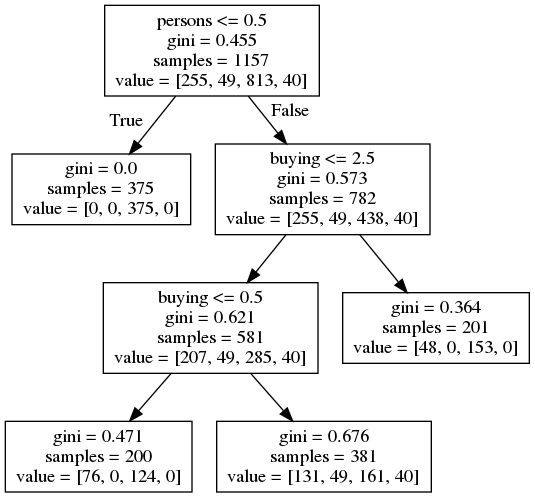

max depth  7
criterion gini
min samples leaf 200
max features 3
Accuracy score  0.6952714535901926


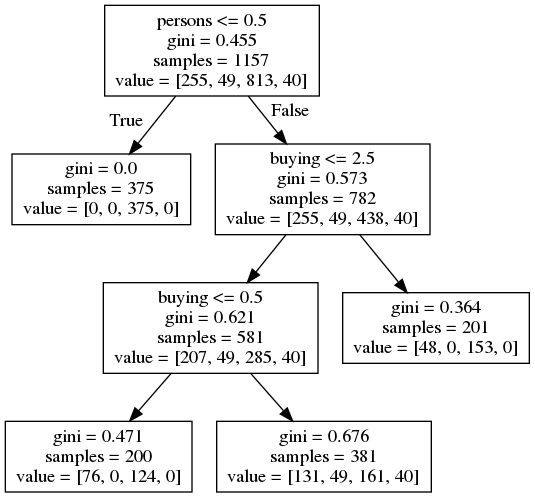

max depth  7
criterion gini
min samples leaf 200
max features 4
Accuracy score  0.6952714535901926


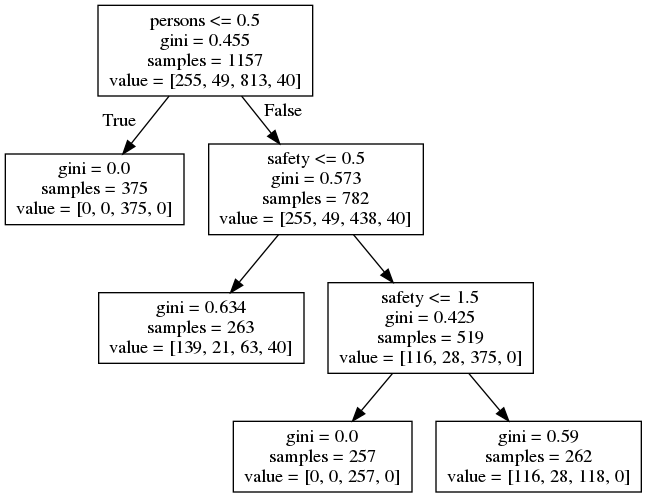

max depth  7
criterion gini
min samples leaf 200
max features 5
Accuracy score  0.7705779334500875


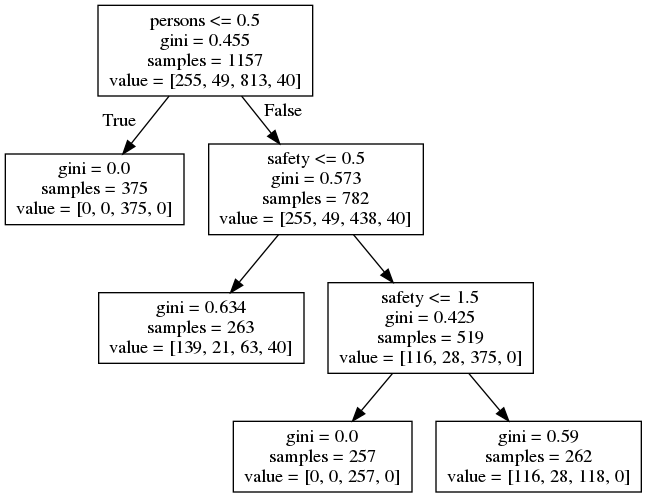

max depth  7
criterion gini
min samples leaf 200
max features 6
Accuracy score  0.7705779334500875


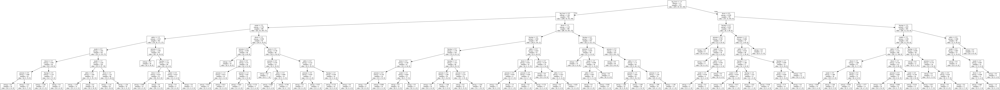

max depth  7
criterion entropy
min samples leaf 1
max features 1
Accuracy score  0.7373029772329247


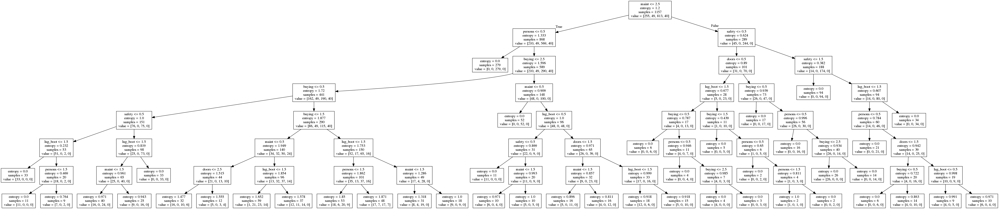

max depth  7
criterion entropy
min samples leaf 1
max features 2
Accuracy score  0.7600700525394045


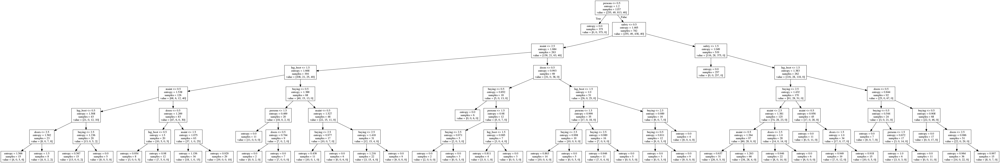

max depth  7
criterion entropy
min samples leaf 1
max features 3
Accuracy score  0.8213660245183888


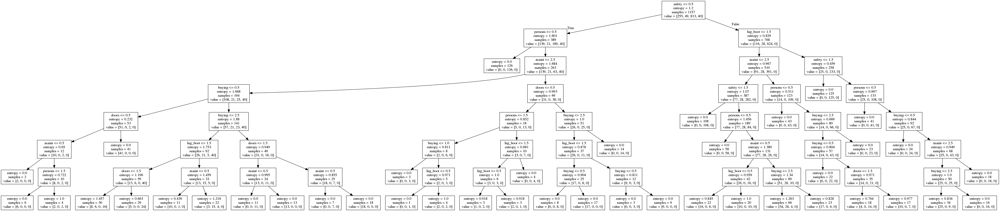

max depth  7
criterion entropy
min samples leaf 1
max features 4
Accuracy score  0.8879159369527145


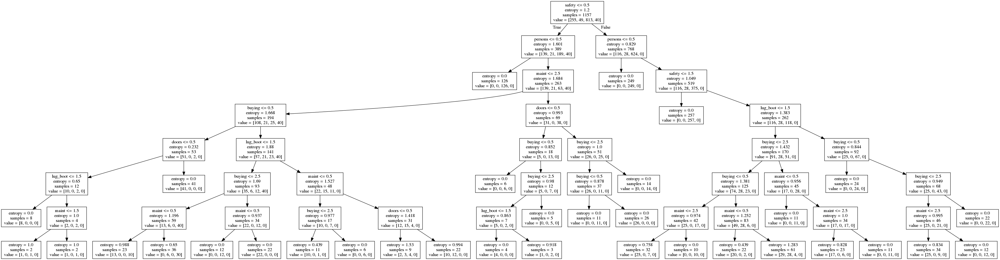

max depth  7
criterion entropy
min samples leaf 1
max features 5
Accuracy score  0.9281961471103327


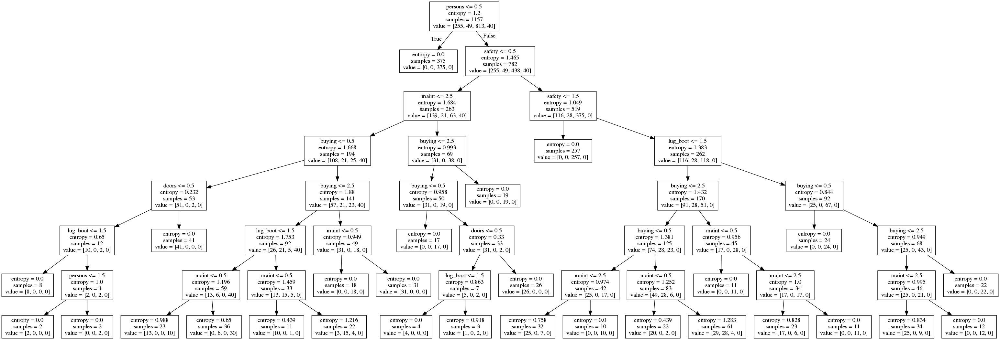

max depth  7
criterion entropy
min samples leaf 1
max features 6
Accuracy score  0.9352014010507881


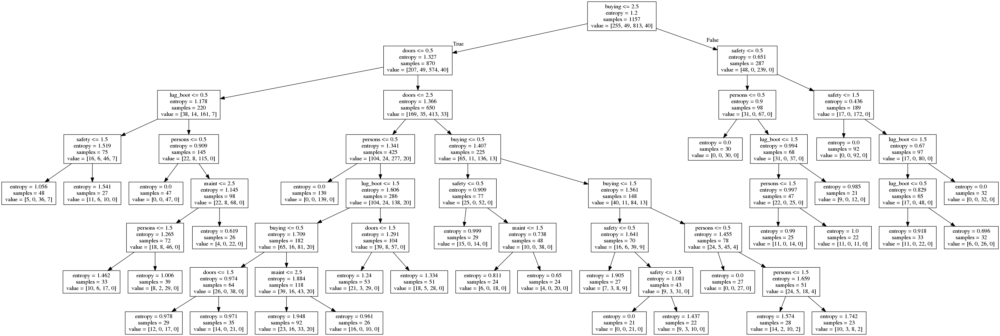

max depth  7
criterion entropy
min samples leaf 20
max features 1
Accuracy score  0.6970227670753065


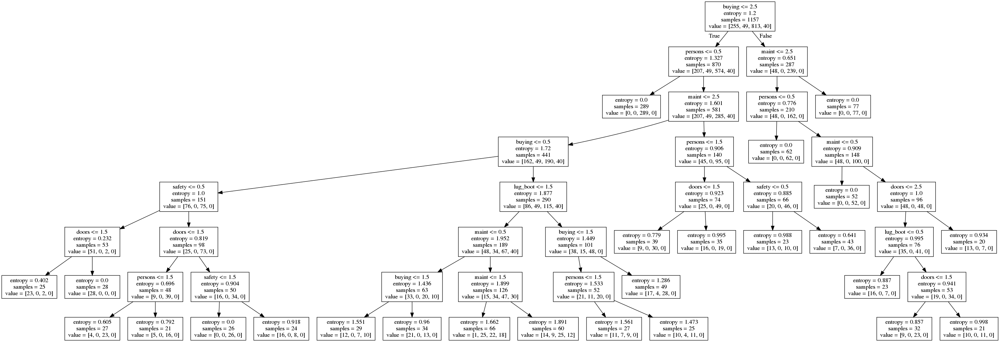

max depth  7
criterion entropy
min samples leaf 20
max features 2
Accuracy score  0.7408056042031523


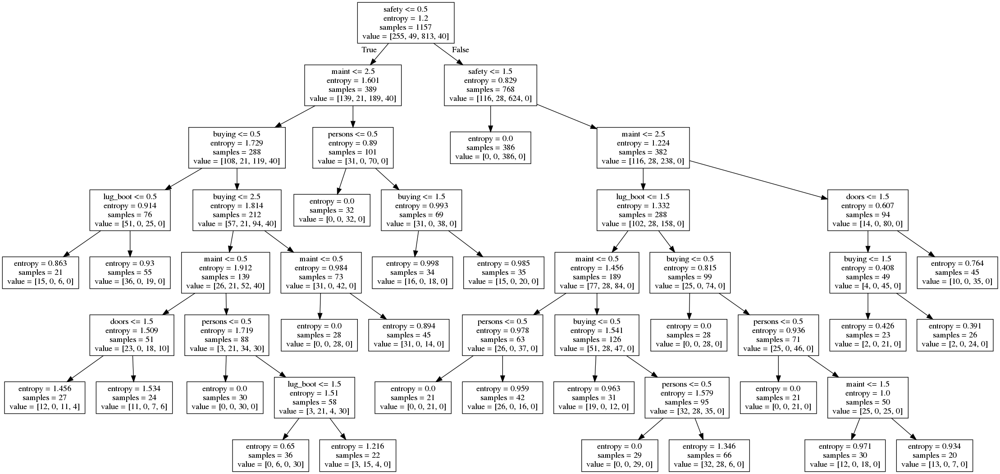

max depth  7
criterion entropy
min samples leaf 20
max features 3
Accuracy score  0.8021015761821366


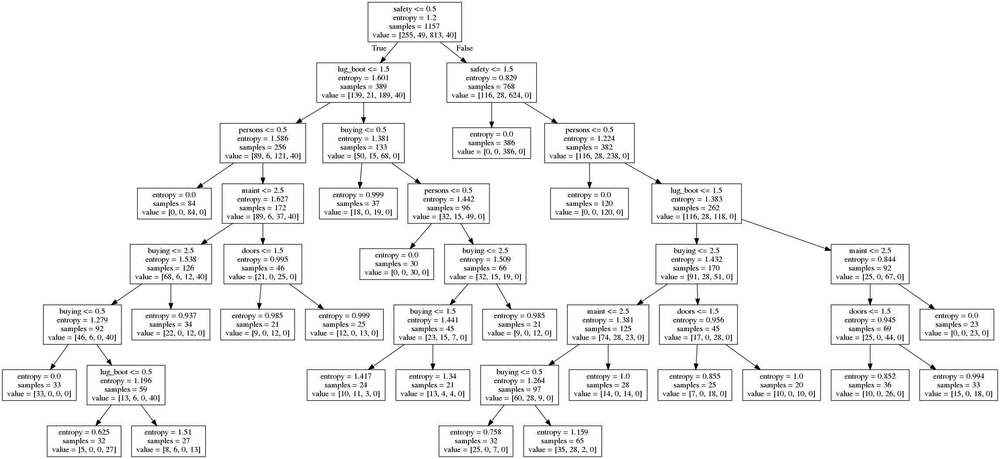

max depth  7
criterion entropy
min samples leaf 20
max features 4
Accuracy score  0.8528896672504378


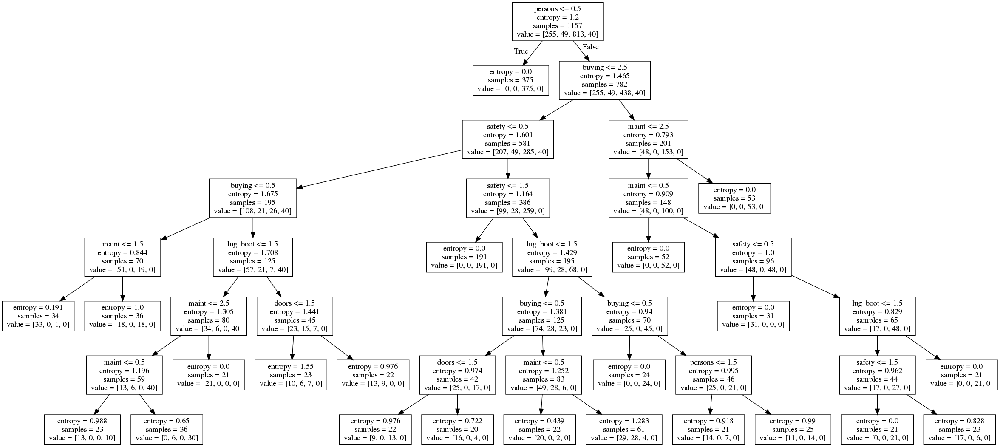

max depth  7
criterion entropy
min samples leaf 20
max features 5
Accuracy score  0.8966725043782837


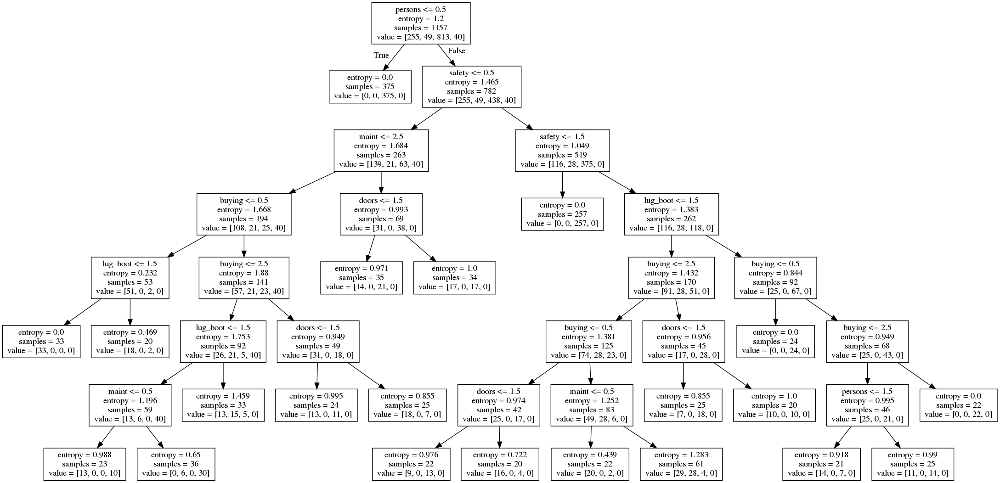

max depth  7
criterion entropy
min samples leaf 20
max features 6
Accuracy score  0.8528896672504378


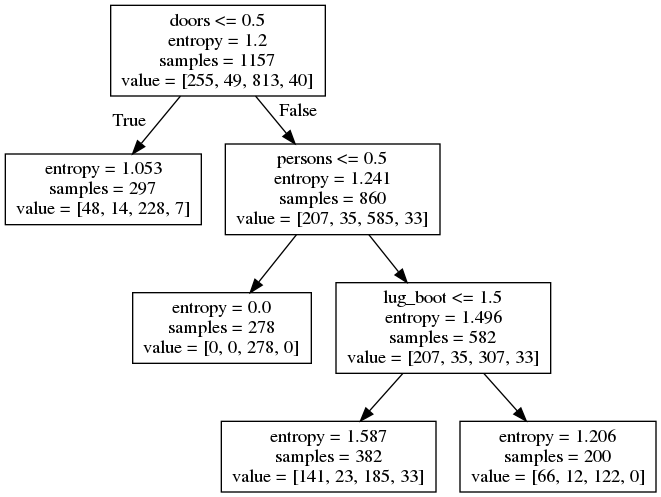

max depth  7
criterion entropy
min samples leaf 200
max features 1
Accuracy score  0.6952714535901926


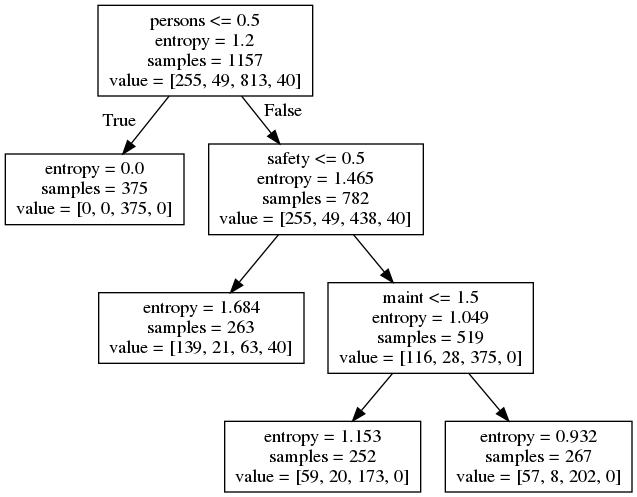

max depth  7
criterion entropy
min samples leaf 200
max features 2
Accuracy score  0.7705779334500875


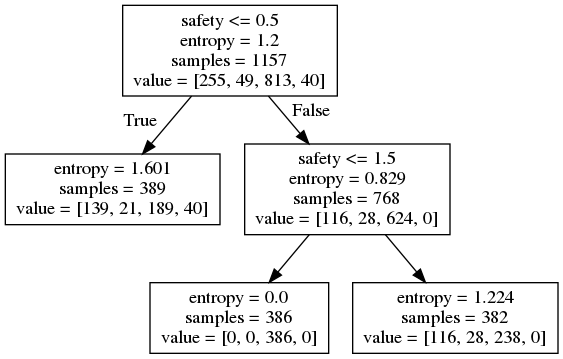

max depth  7
criterion entropy
min samples leaf 200
max features 3
Accuracy score  0.6952714535901926


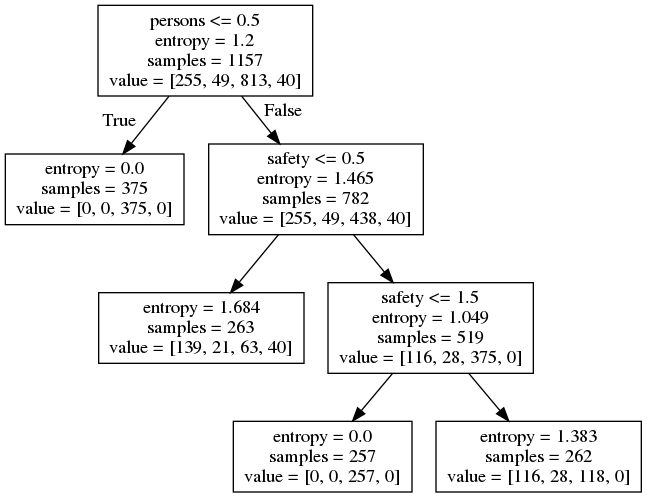

max depth  7
criterion entropy
min samples leaf 200
max features 4
Accuracy score  0.7705779334500875


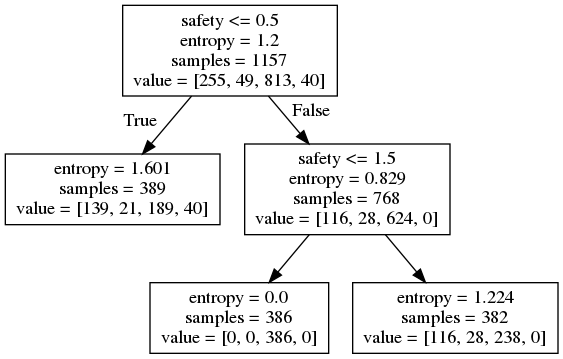

max depth  7
criterion entropy
min samples leaf 200
max features 5
Accuracy score  0.6952714535901926


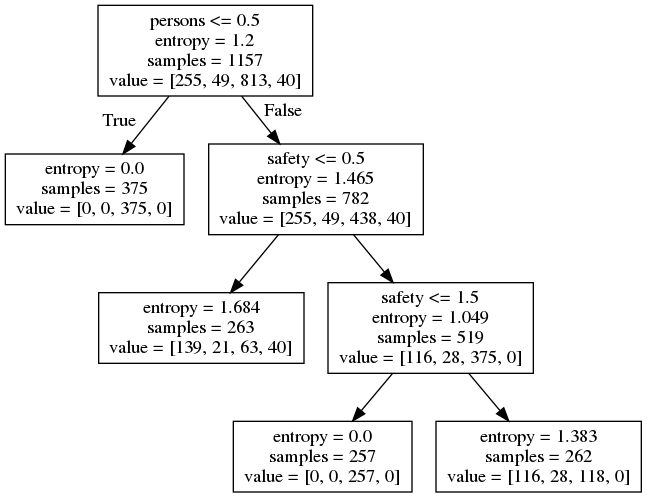

max depth  7
criterion entropy
min samples leaf 200
max features 6
Accuracy score  0.7705779334500875


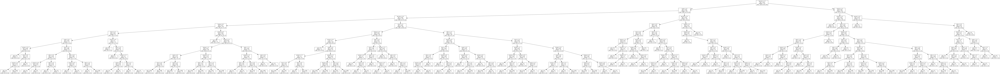

max depth  9
criterion gini
min samples leaf 1
max features 1
Accuracy score  0.7758318739054291


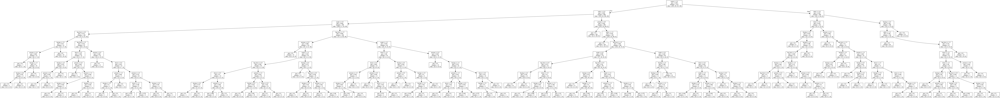

max depth  9
criterion gini
min samples leaf 1
max features 2
Accuracy score  0.8844133099824869


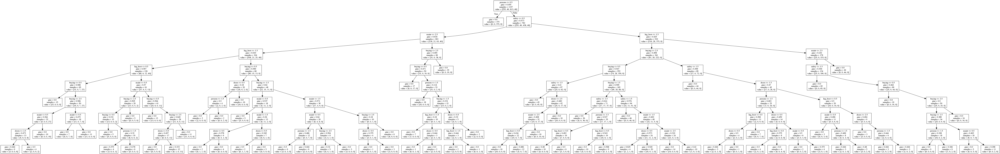

max depth  9
criterion gini
min samples leaf 1
max features 3
Accuracy score  0.9019264448336253


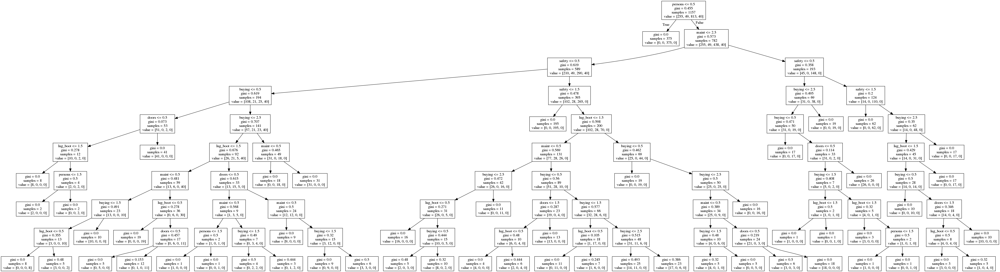

max depth  9
criterion gini
min samples leaf 1
max features 4
Accuracy score  0.9509632224168126


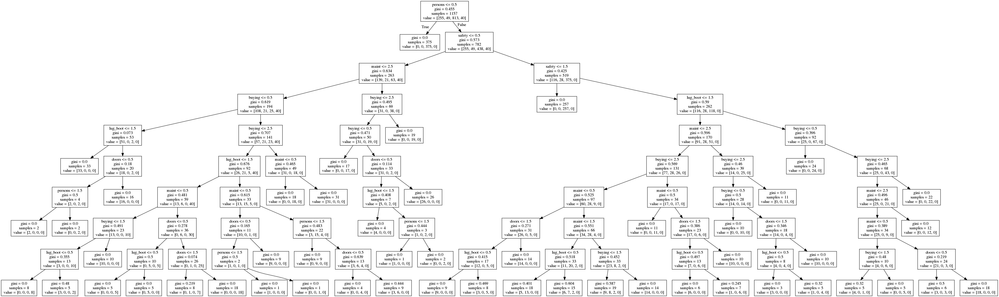

max depth  9
criterion gini
min samples leaf 1
max features 5
Accuracy score  0.9387040280210157


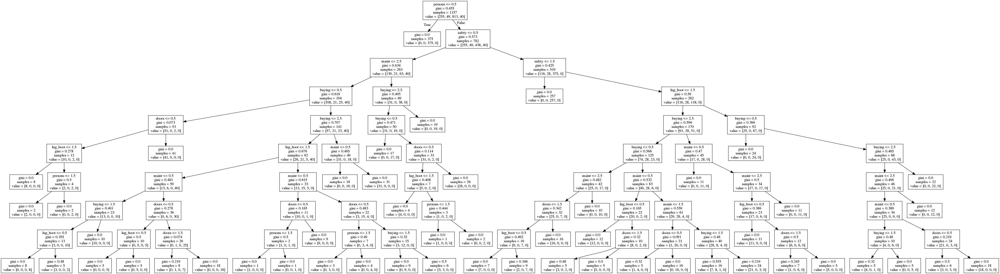

max depth  9
criterion gini
min samples leaf 1
max features 6
Accuracy score  0.9404553415061296


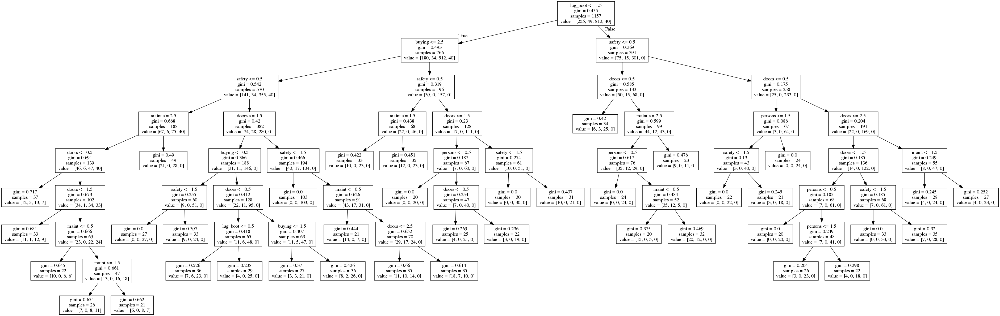

max depth  9
criterion gini
min samples leaf 20
max features 1
Accuracy score  0.7092819614711033


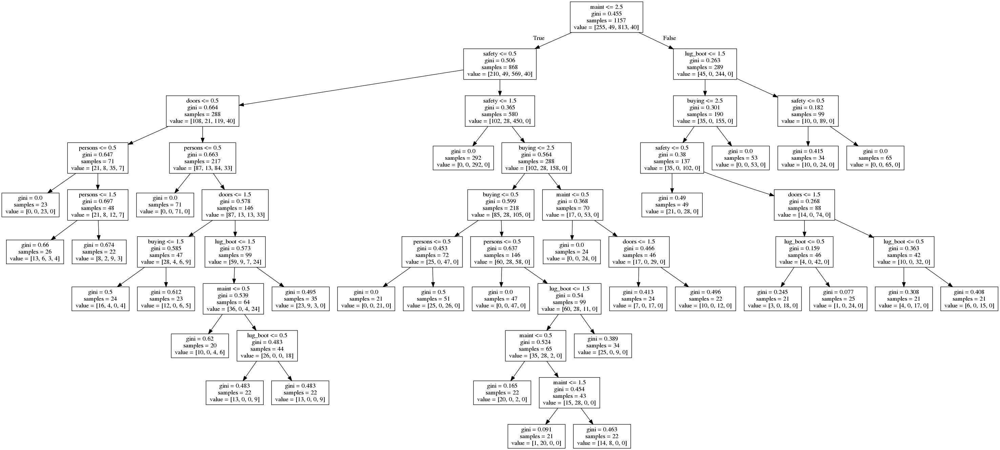

max depth  9
criterion gini
min samples leaf 20
max features 2
Accuracy score  0.8073555166374781


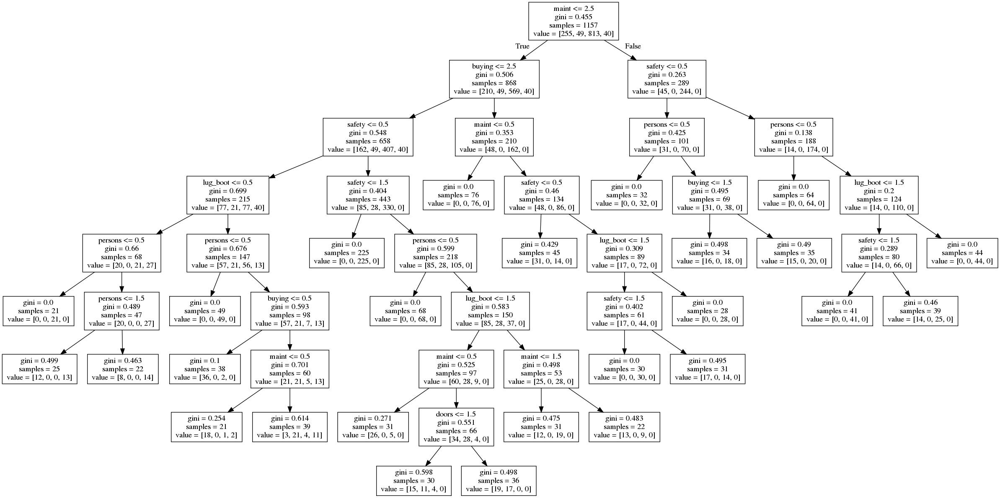

max depth  9
criterion gini
min samples leaf 20
max features 3
Accuracy score  0.8178633975481612


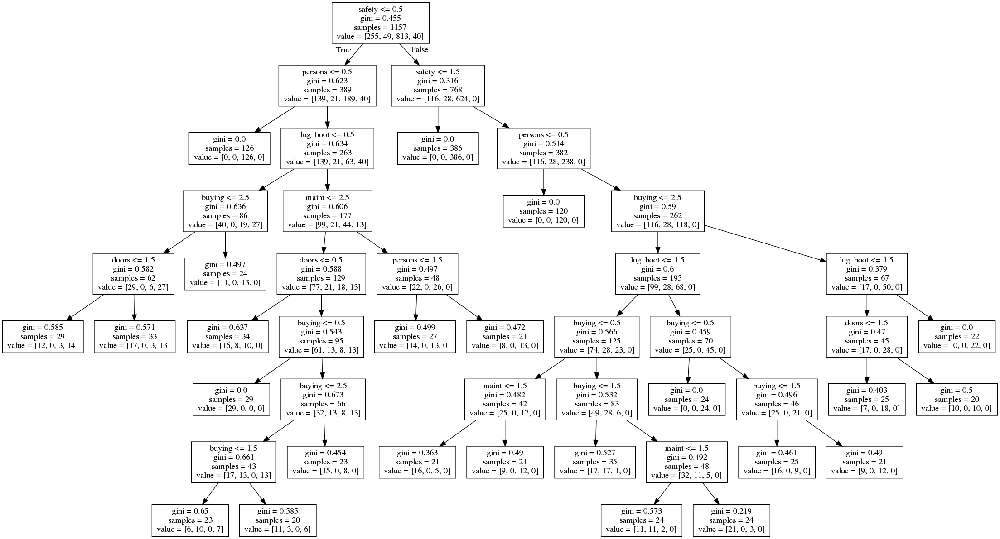

max depth  9
criterion gini
min samples leaf 20
max features 4
Accuracy score  0.830122591943958


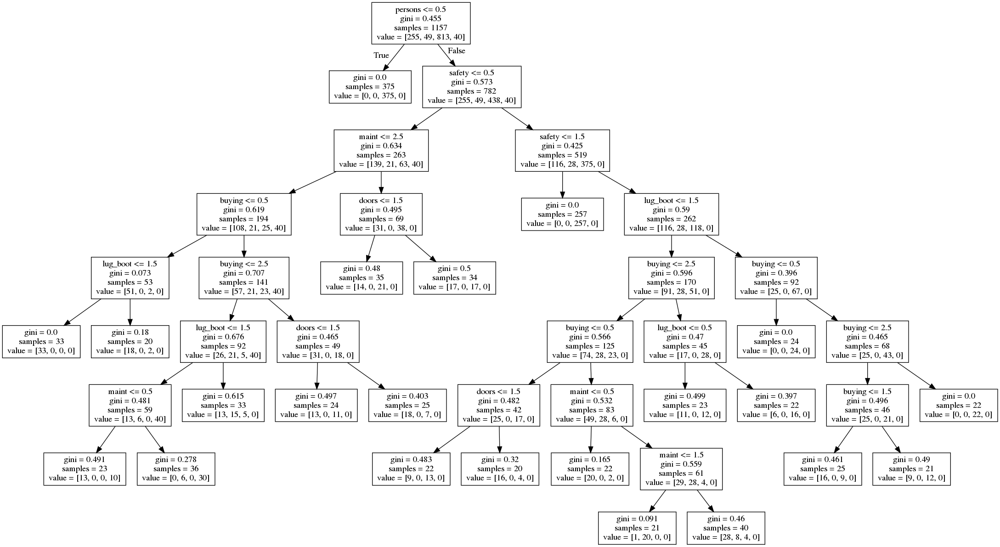

max depth  9
criterion gini
min samples leaf 20
max features 5
Accuracy score  0.8581436077057794


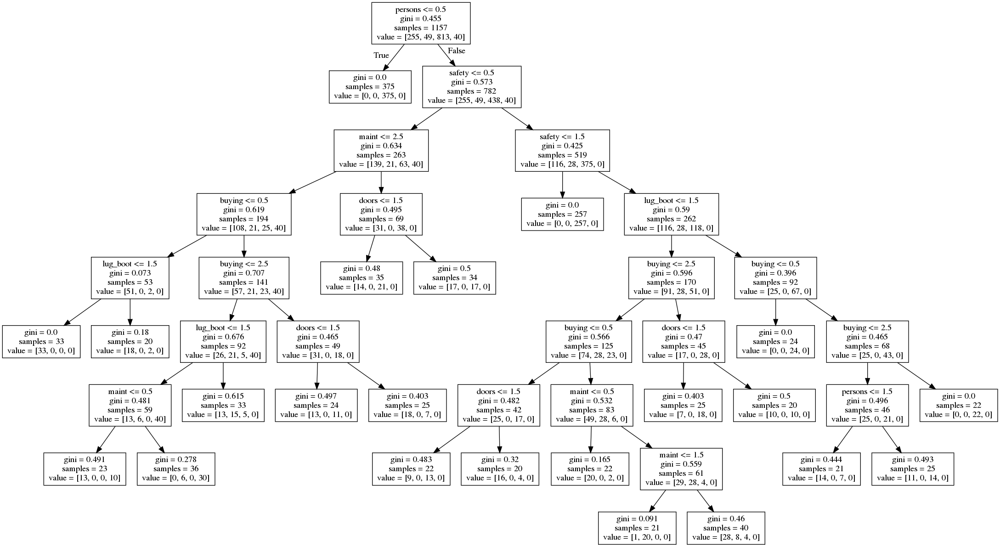

max depth  9
criterion gini
min samples leaf 20
max features 6
Accuracy score  0.8546409807355516


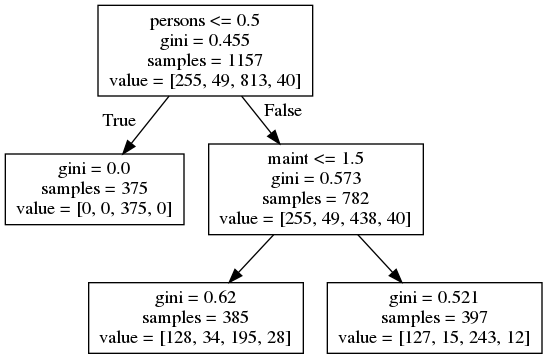

max depth  9
criterion gini
min samples leaf 200
max features 1
Accuracy score  0.6952714535901926


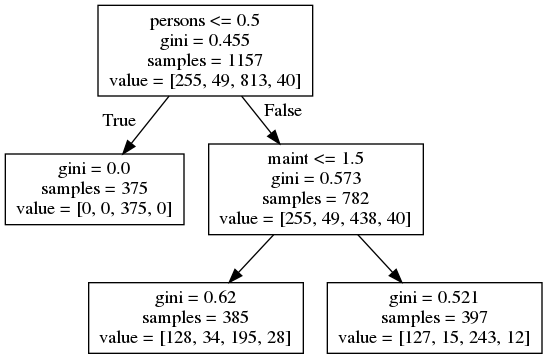

max depth  9
criterion gini
min samples leaf 200
max features 2
Accuracy score  0.6952714535901926


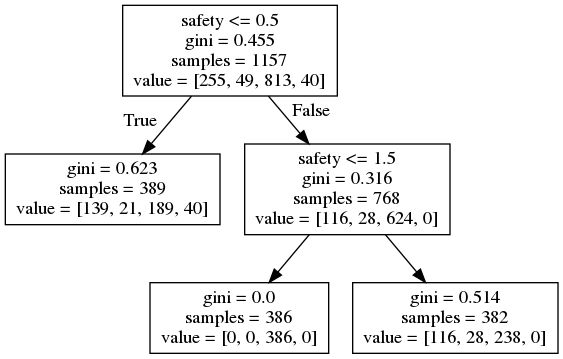

max depth  9
criterion gini
min samples leaf 200
max features 3
Accuracy score  0.6952714535901926


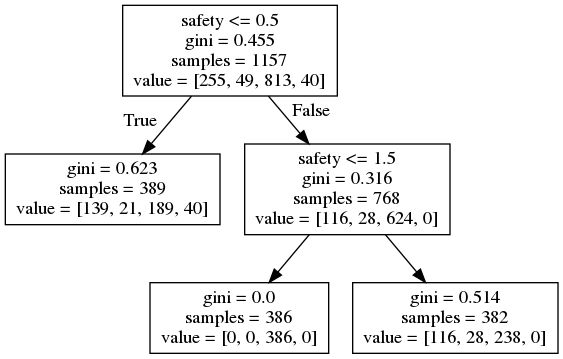

max depth  9
criterion gini
min samples leaf 200
max features 4
Accuracy score  0.6952714535901926


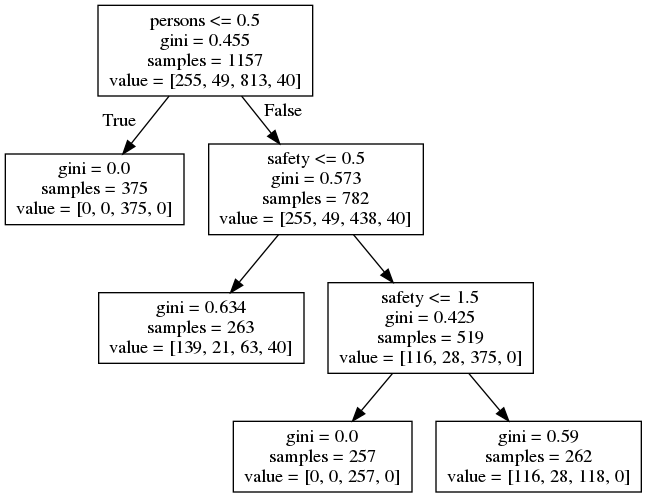

max depth  9
criterion gini
min samples leaf 200
max features 5
Accuracy score  0.7705779334500875


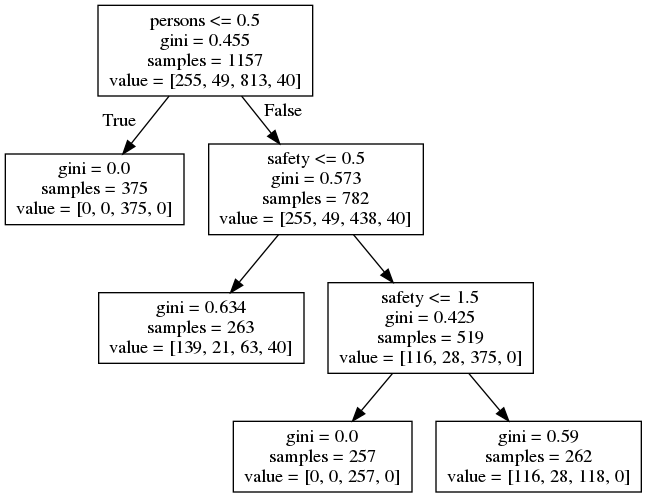

max depth  9
criterion gini
min samples leaf 200
max features 6
Accuracy score  0.7705779334500875


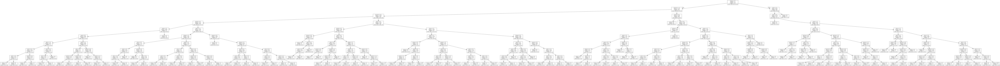

max depth  9
criterion entropy
min samples leaf 1
max features 1
Accuracy score  0.7705779334500875


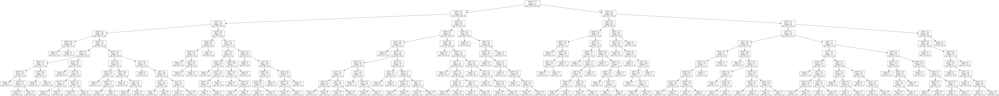

max depth  9
criterion entropy
min samples leaf 1
max features 2
Accuracy score  0.9001751313485113


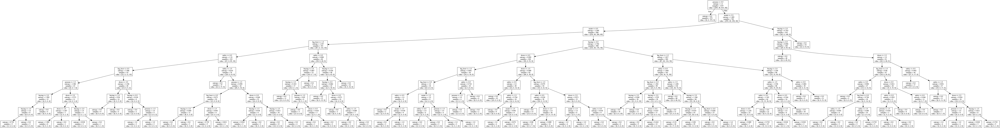

max depth  9
criterion entropy
min samples leaf 1
max features 3
Accuracy score  0.9019264448336253


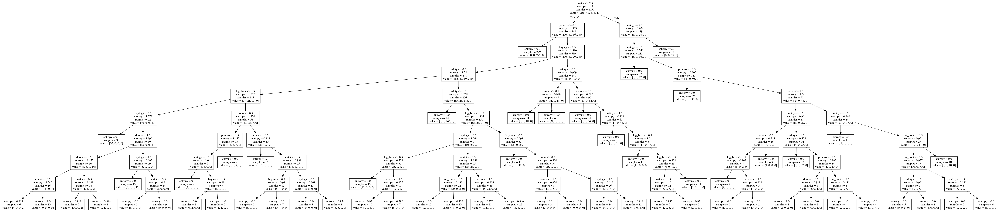

max depth  9
criterion entropy
min samples leaf 1
max features 4
Accuracy score  0.9299474605954466


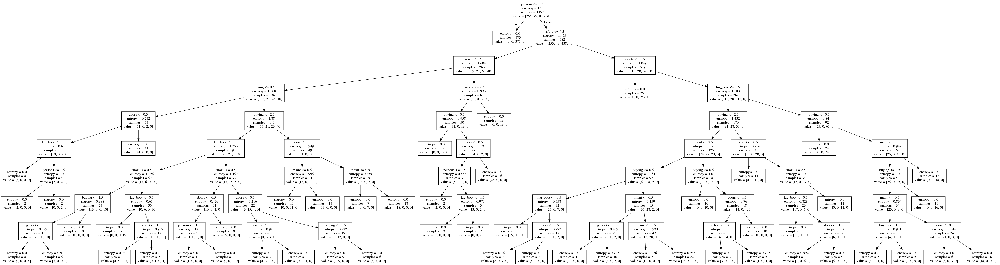

max depth  9
criterion entropy
min samples leaf 1
max features 5
Accuracy score  0.9474605954465849


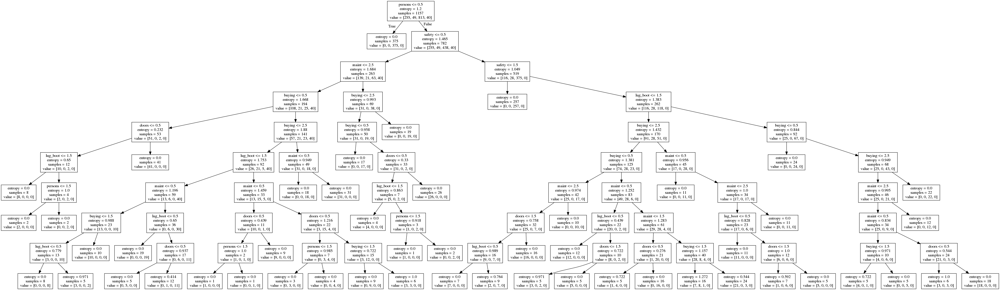

max depth  9
criterion entropy
min samples leaf 1
max features 6
Accuracy score  0.9404553415061296


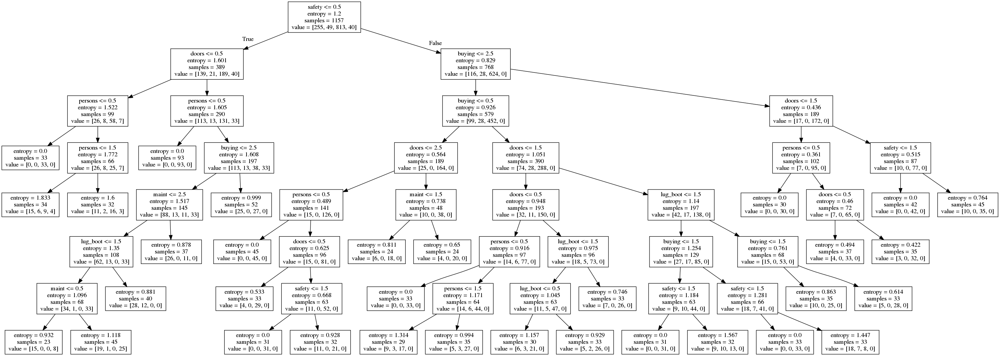

max depth  9
criterion entropy
min samples leaf 20
max features 1
Accuracy score  0.7845884413309983


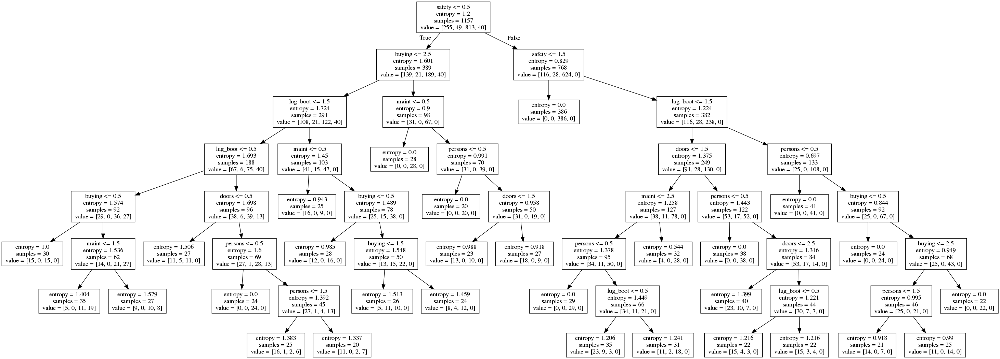

max depth  9
criterion entropy
min samples leaf 20
max features 2
Accuracy score  0.7688266199649737


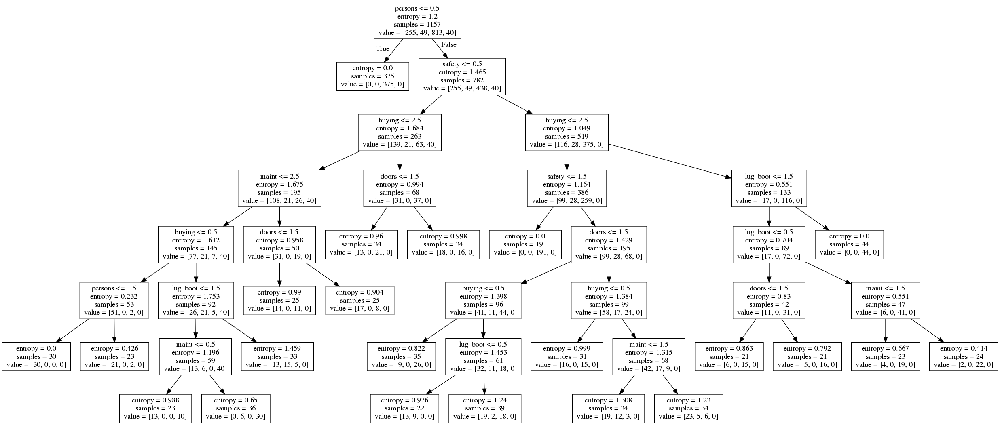

max depth  9
criterion entropy
min samples leaf 20
max features 3
Accuracy score  0.8441330998248686


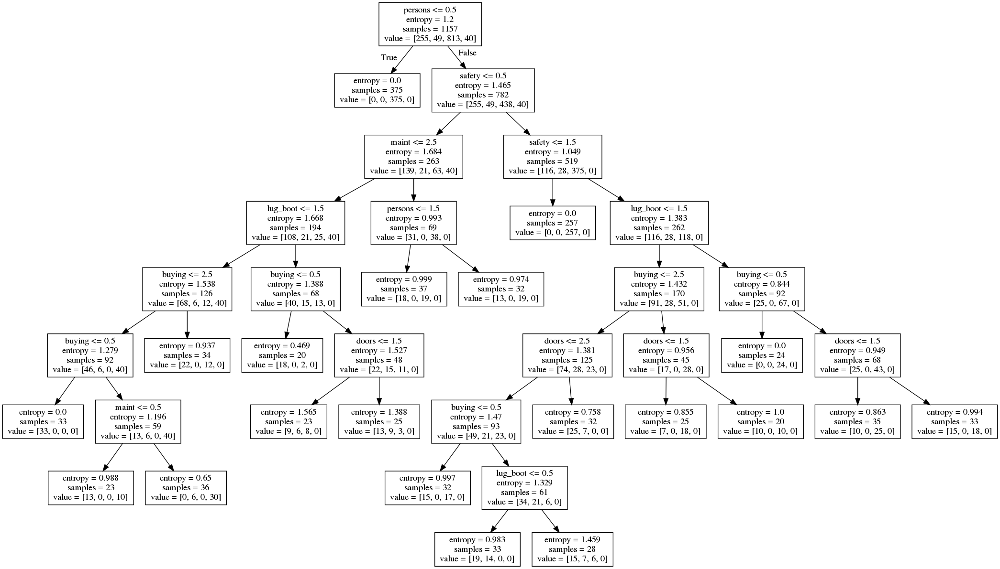

max depth  9
criterion entropy
min samples leaf 20
max features 4
Accuracy score  0.8441330998248686


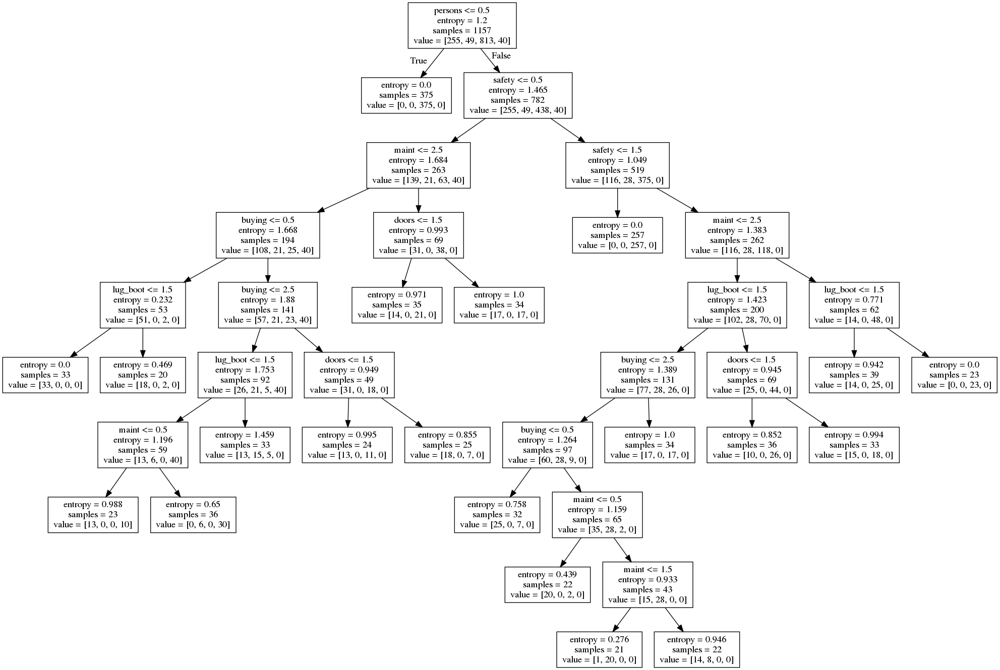

max depth  9
criterion entropy
min samples leaf 20
max features 5
Accuracy score  0.8563922942206655


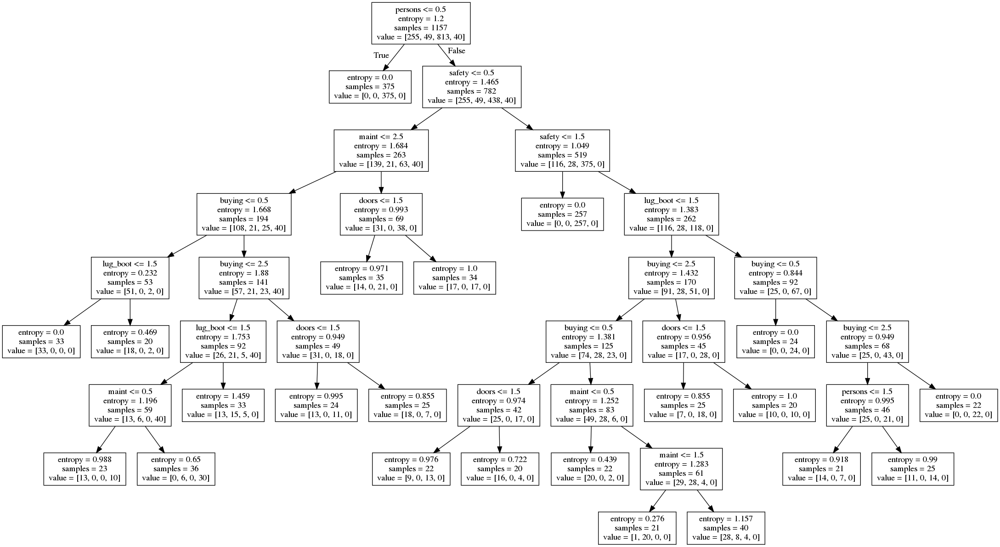

max depth  9
criterion entropy
min samples leaf 20
max features 6
Accuracy score  0.8546409807355516


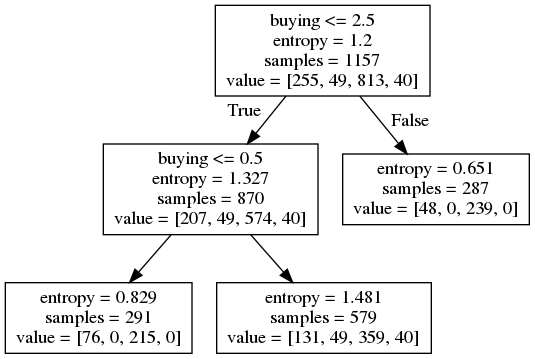

max depth  9
criterion entropy
min samples leaf 200
max features 1
Accuracy score  0.6952714535901926


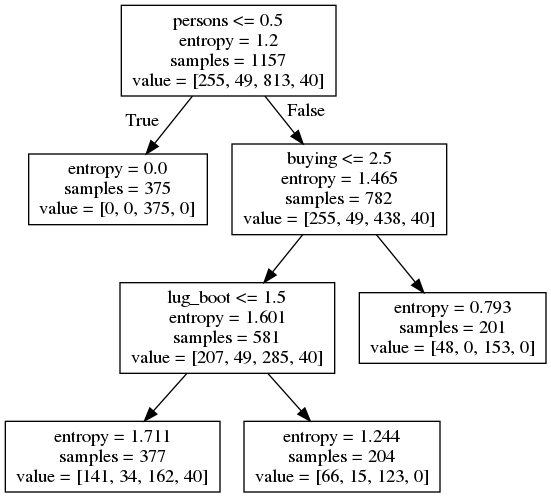

max depth  9
criterion entropy
min samples leaf 200
max features 2
Accuracy score  0.6952714535901926


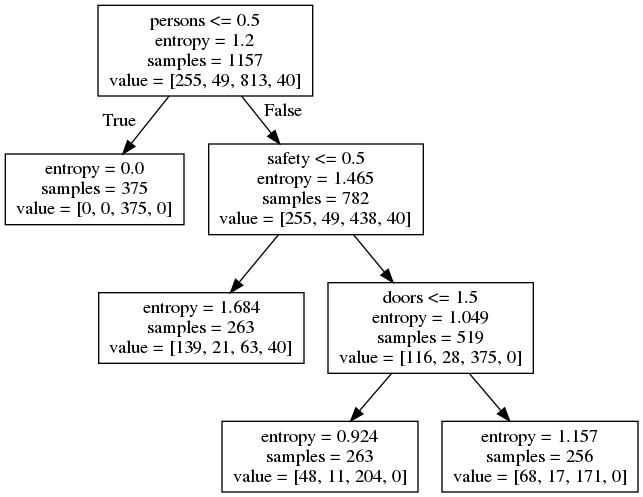

max depth  9
criterion entropy
min samples leaf 200
max features 3
Accuracy score  0.7705779334500875


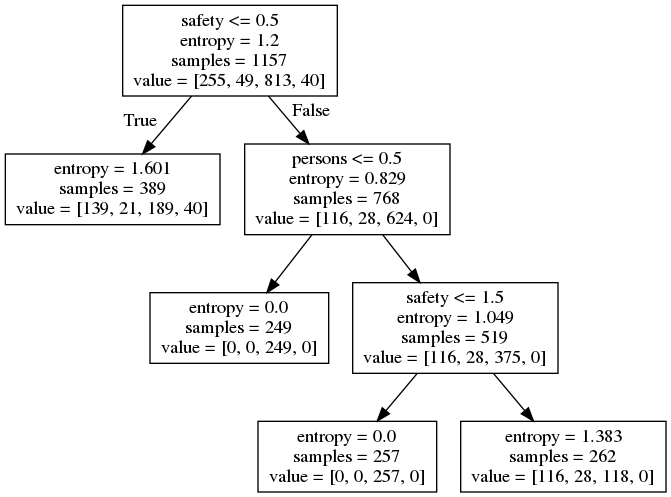

max depth  9
criterion entropy
min samples leaf 200
max features 4
Accuracy score  0.6952714535901926


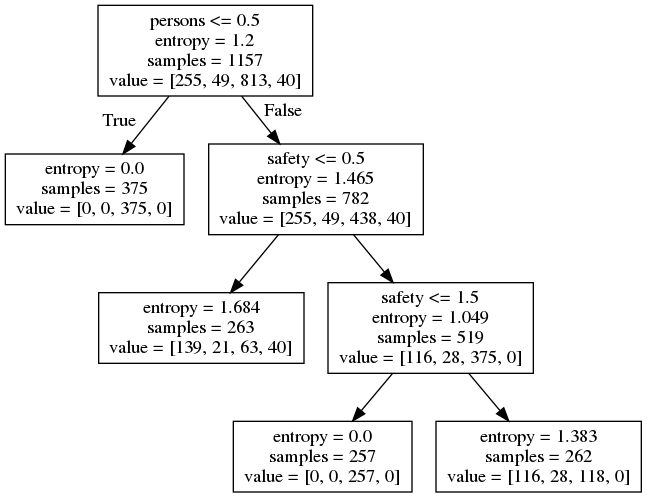

max depth  9
criterion entropy
min samples leaf 200
max features 5
Accuracy score  0.7705779334500875


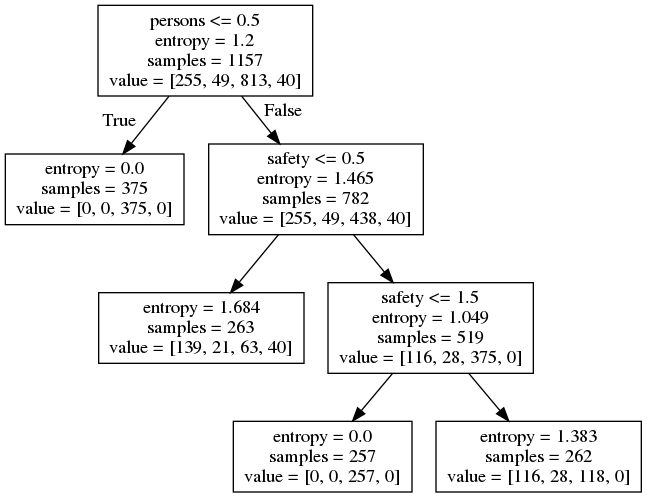

max depth  9
criterion entropy
min samples leaf 200
max features 6
Accuracy score  0.7705779334500875


max depth  100
criterion gini
min samples leaf 1
max features 1
Accuracy score  0.8161120840630472


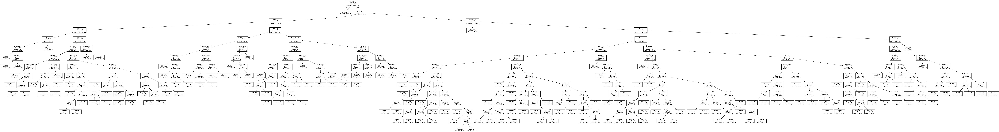

max depth  100
criterion gini
min samples leaf 1
max features 2
Accuracy score  0.9194395796847635


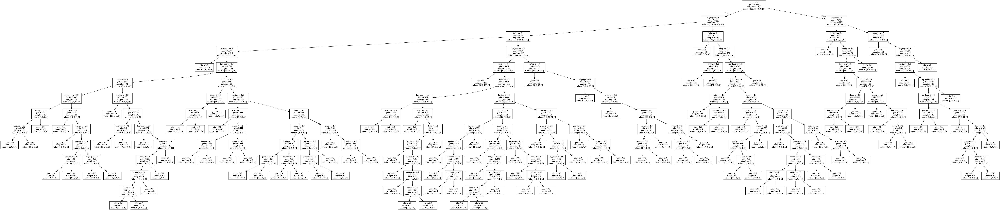

max depth  100
criterion gini
min samples leaf 1
max features 3
Accuracy score  0.9544658493870403


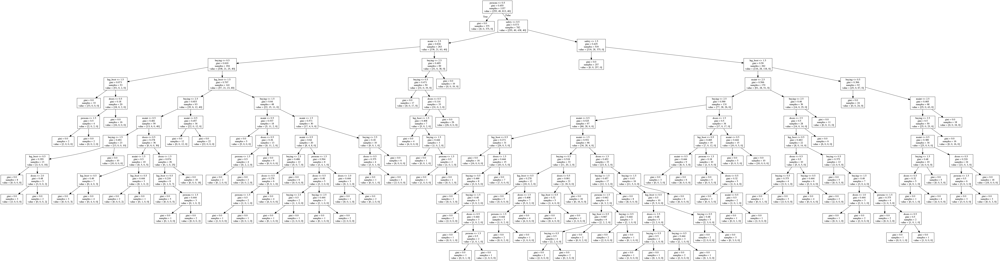

max depth  100
criterion gini
min samples leaf 1
max features 4
Accuracy score  0.9492119089316988


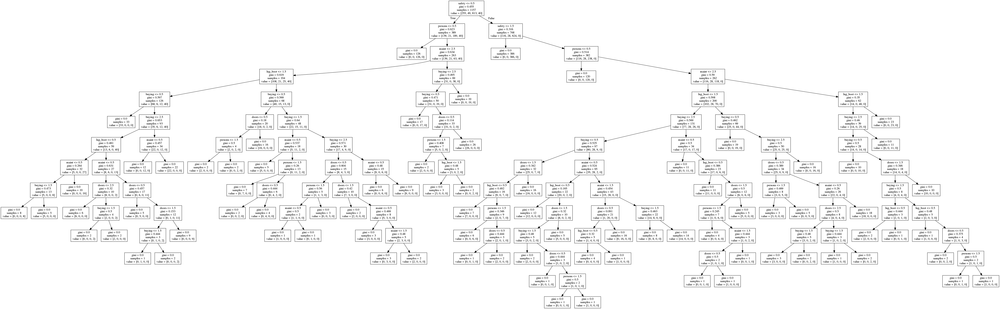

max depth  100
criterion gini
min samples leaf 1
max features 5
Accuracy score  0.9597197898423818


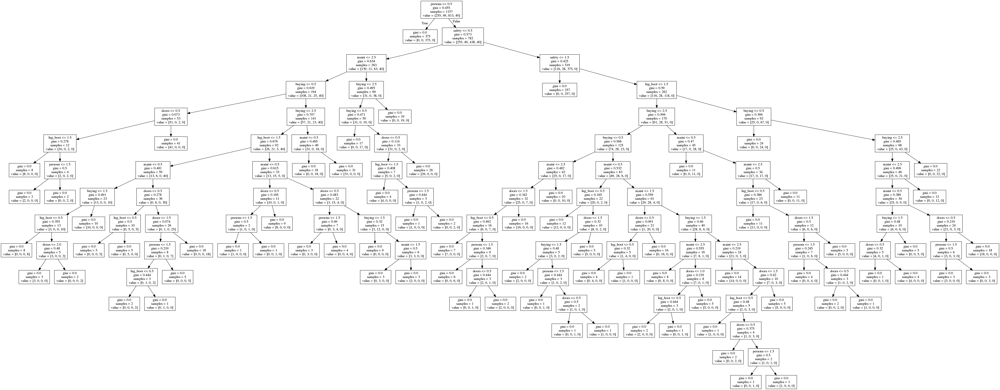

max depth  100
criterion gini
min samples leaf 1
max features 6
Accuracy score  0.9719789842381786


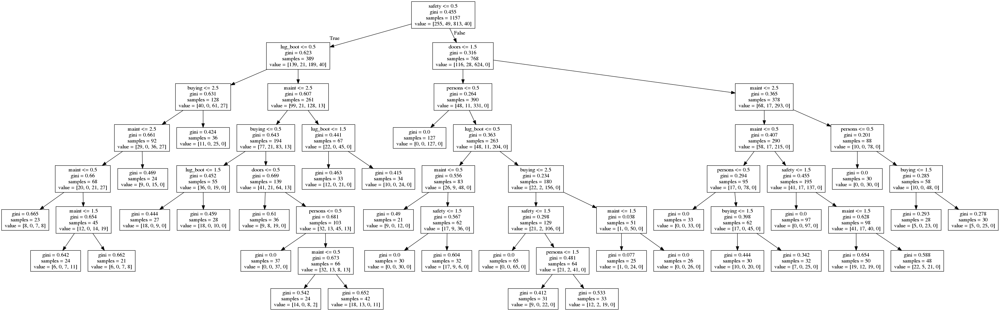

max depth  100
criterion gini
min samples leaf 20
max features 1
Accuracy score  0.7320490367775832


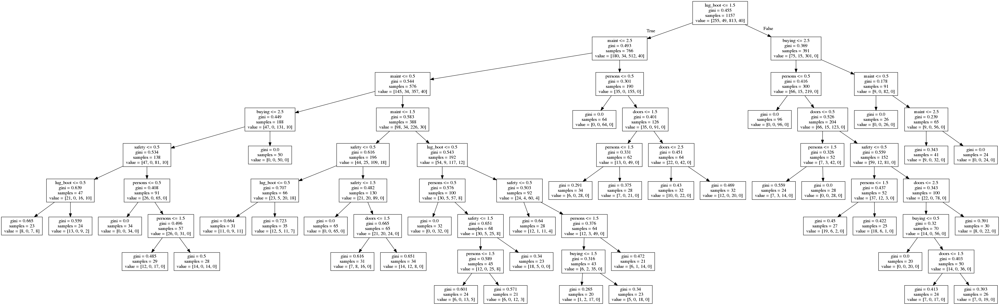

max depth  100
criterion gini
min samples leaf 20
max features 2
Accuracy score  0.7110332749562172


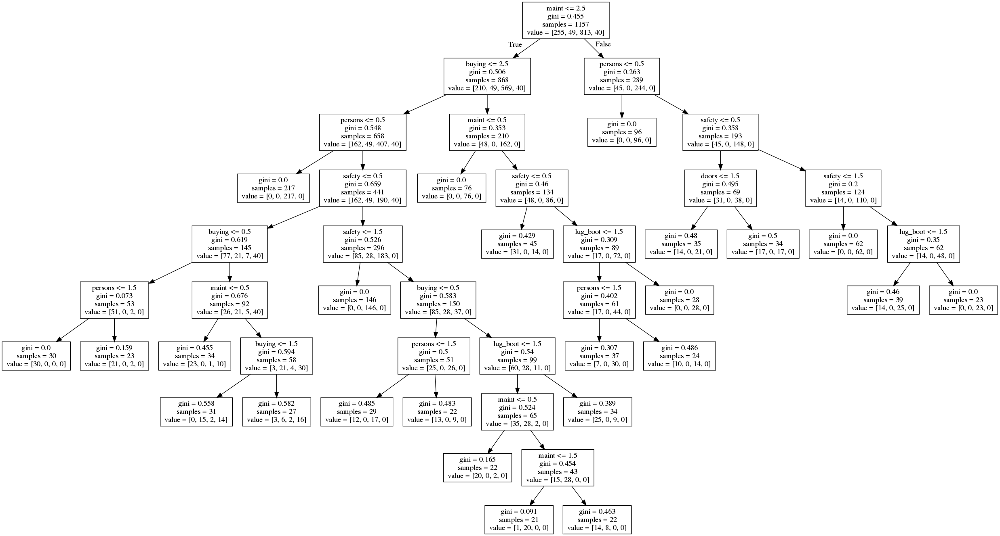

max depth  100
criterion gini
min samples leaf 20
max features 3
Accuracy score  0.819614711033275


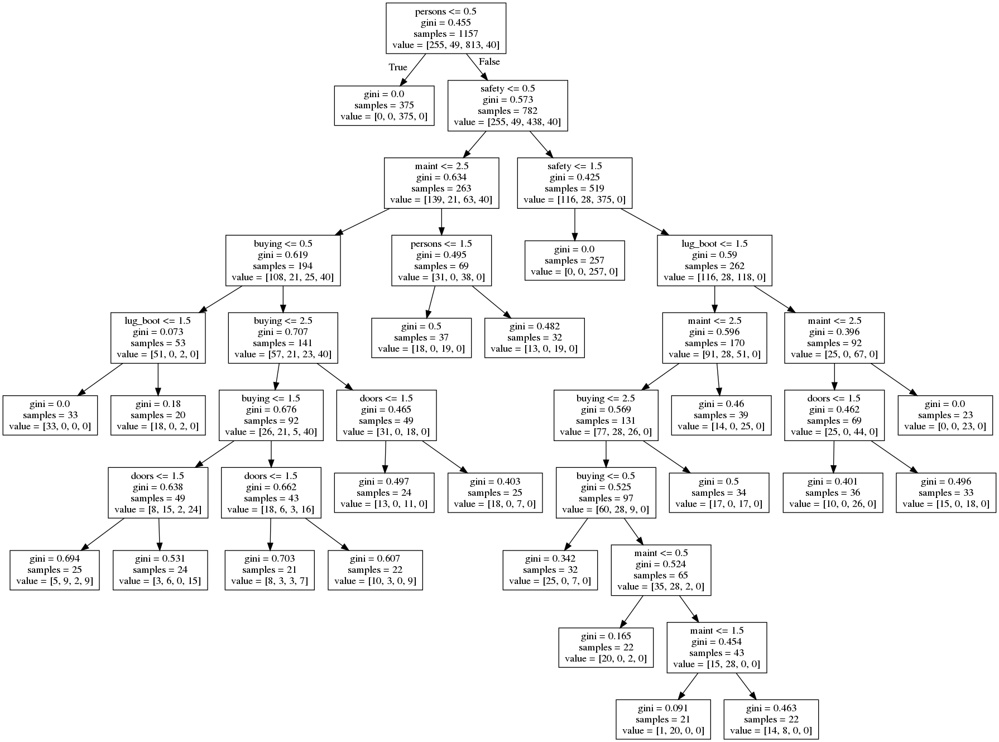

max depth  100
criterion gini
min samples leaf 20
max features 4
Accuracy score  0.8441330998248686


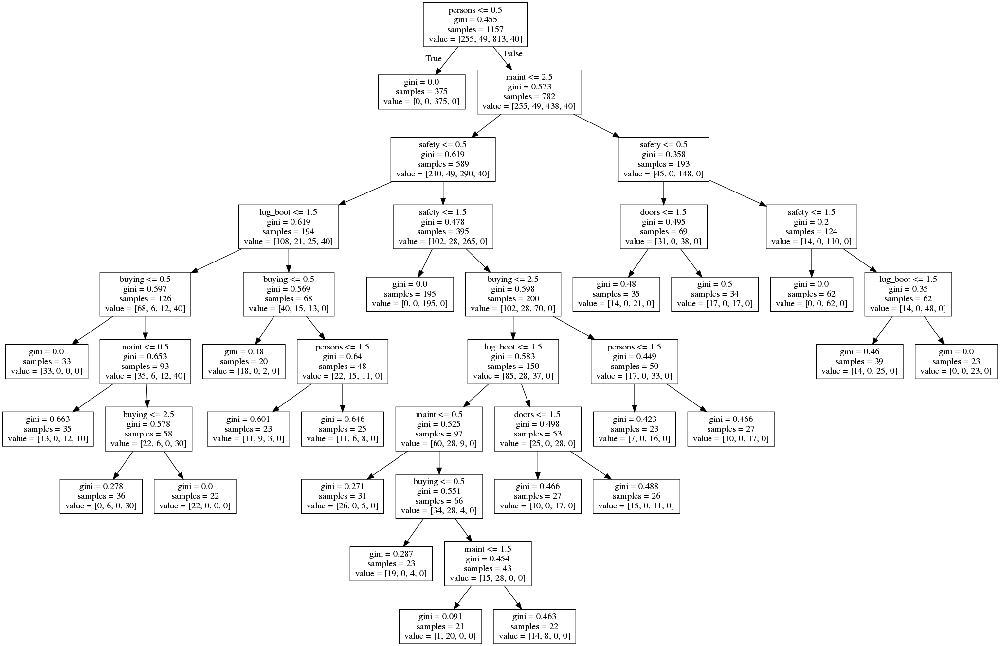

max depth  100
criterion gini
min samples leaf 20
max features 5
Accuracy score  0.8528896672504378


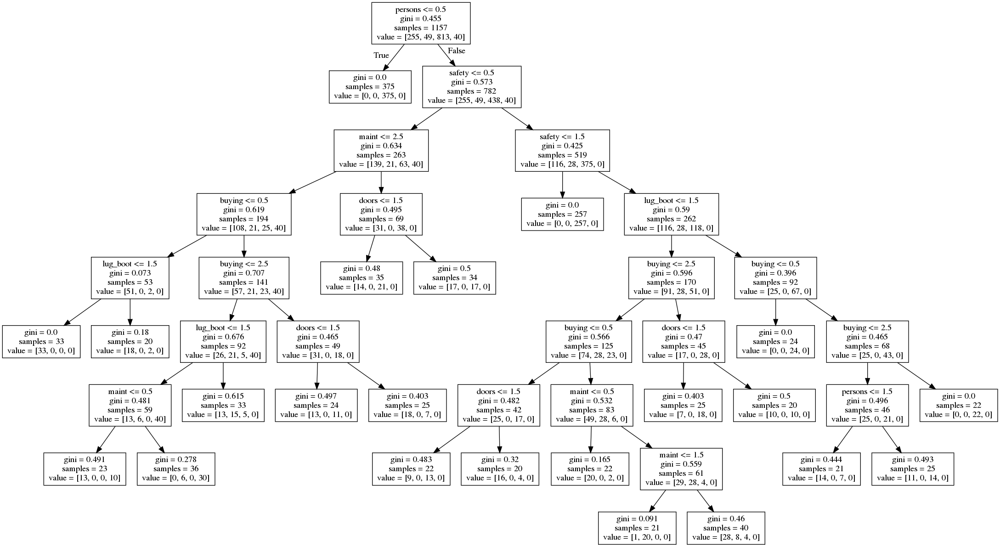

max depth  100
criterion gini
min samples leaf 20
max features 6
Accuracy score  0.8546409807355516


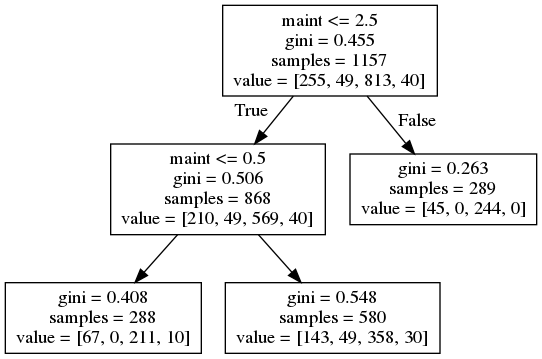

max depth  100
criterion gini
min samples leaf 200
max features 1
Accuracy score  0.6952714535901926


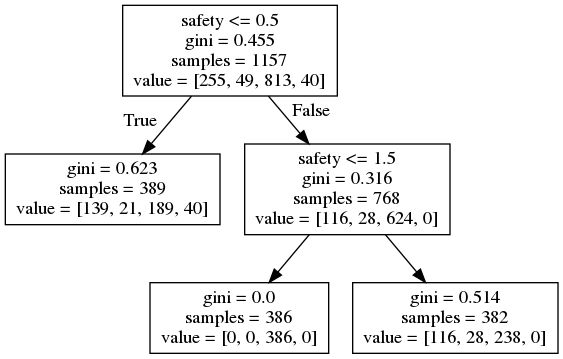

max depth  100
criterion gini
min samples leaf 200
max features 2
Accuracy score  0.6952714535901926


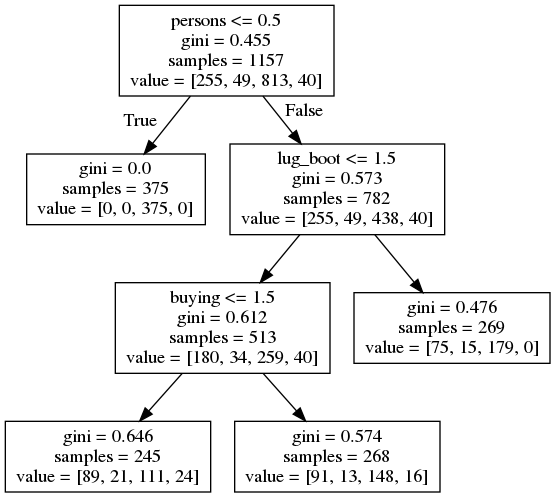

max depth  100
criterion gini
min samples leaf 200
max features 3
Accuracy score  0.6952714535901926


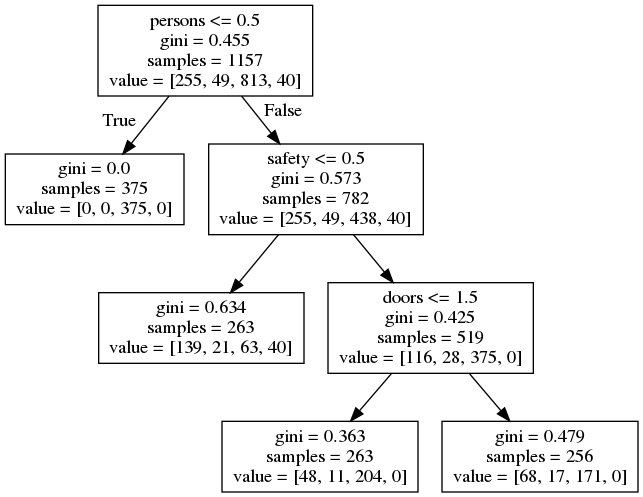

max depth  100
criterion gini
min samples leaf 200
max features 4
Accuracy score  0.7705779334500875


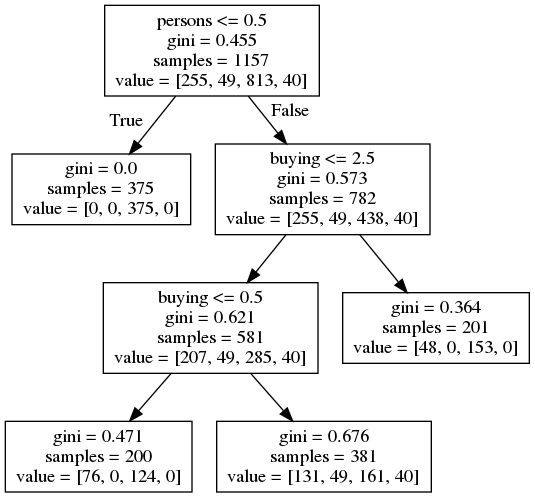

max depth  100
criterion gini
min samples leaf 200
max features 5
Accuracy score  0.6952714535901926


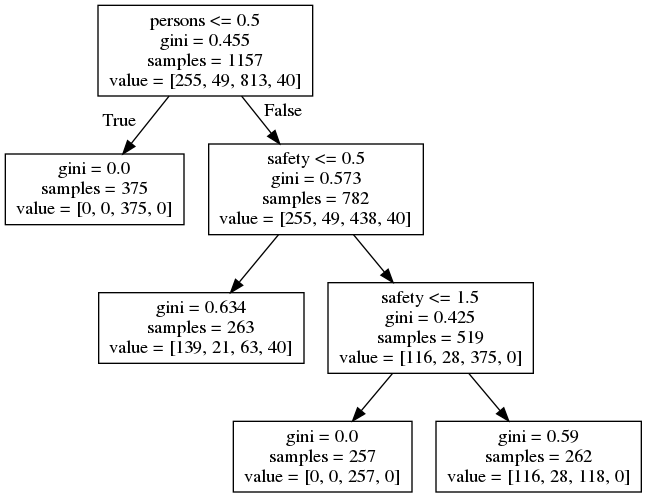

max depth  100
criterion gini
min samples leaf 200
max features 6
Accuracy score  0.7705779334500875
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.85596 to fit



max depth  100
criterion entropy
min samples leaf 1
max features 1
Accuracy score  0.7740805604203153


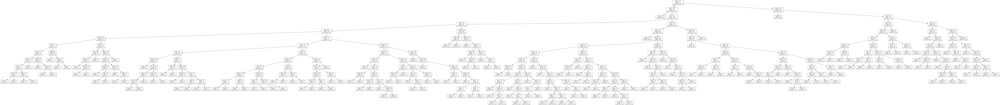

max depth  100
criterion entropy
min samples leaf 1
max features 2
Accuracy score  0.9124343257443083


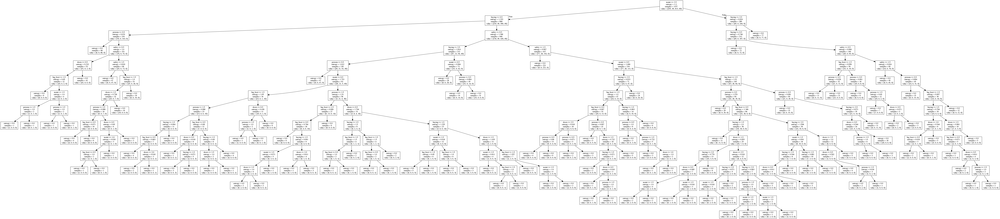

max depth  100
criterion entropy
min samples leaf 1
max features 3
Accuracy score  0.9562171628721541


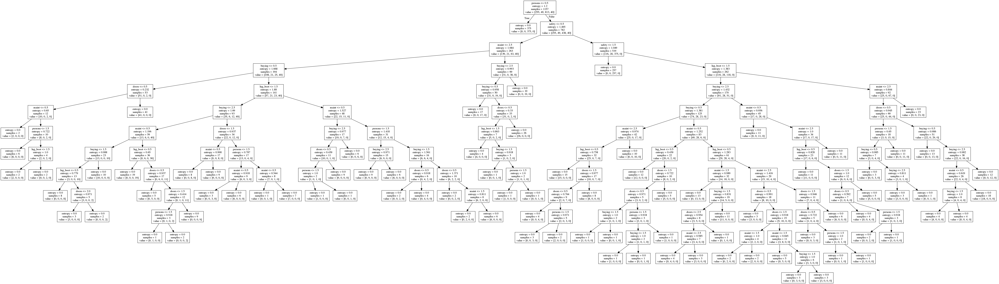

max depth  100
criterion entropy
min samples leaf 1
max features 4
Accuracy score  0.9632224168126094


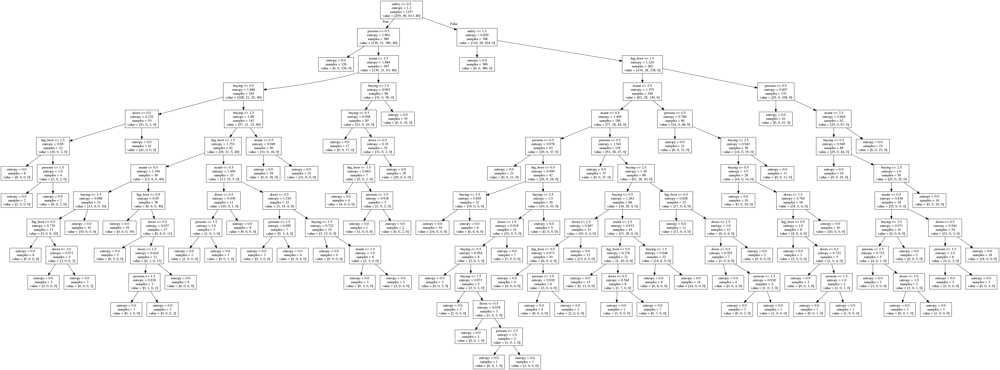

max depth  100
criterion entropy
min samples leaf 1
max features 5
Accuracy score  0.968476357267951


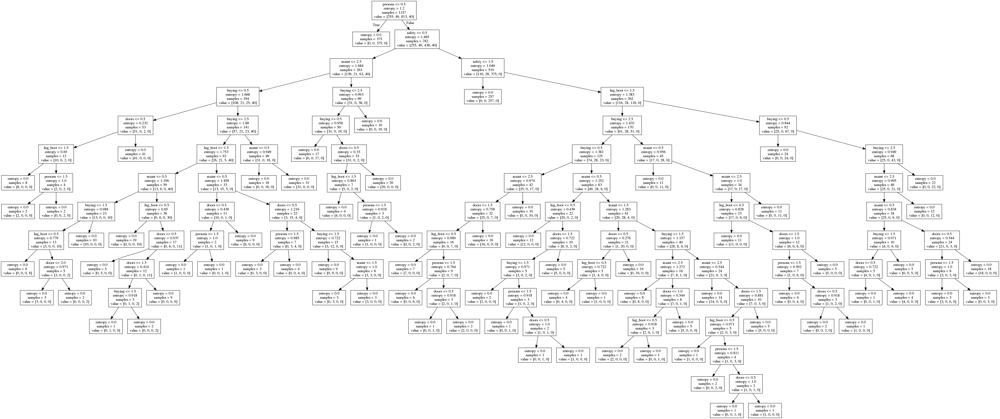

max depth  100
criterion entropy
min samples leaf 1
max features 6
Accuracy score  0.9667250437828371


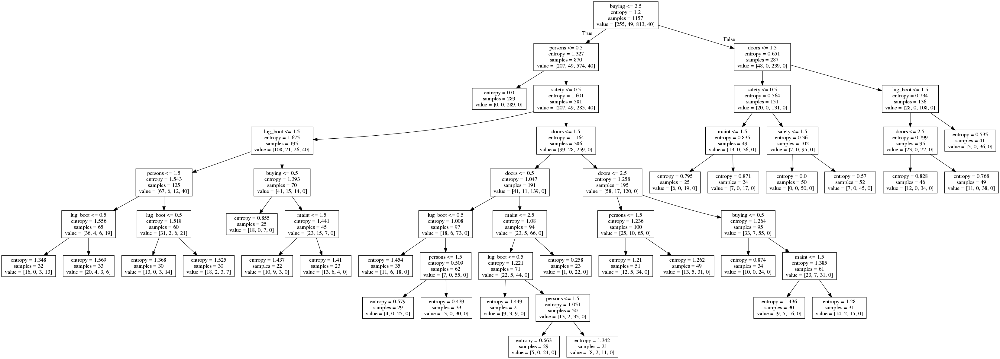

max depth  100
criterion entropy
min samples leaf 20
max features 1
Accuracy score  0.7478108581436077


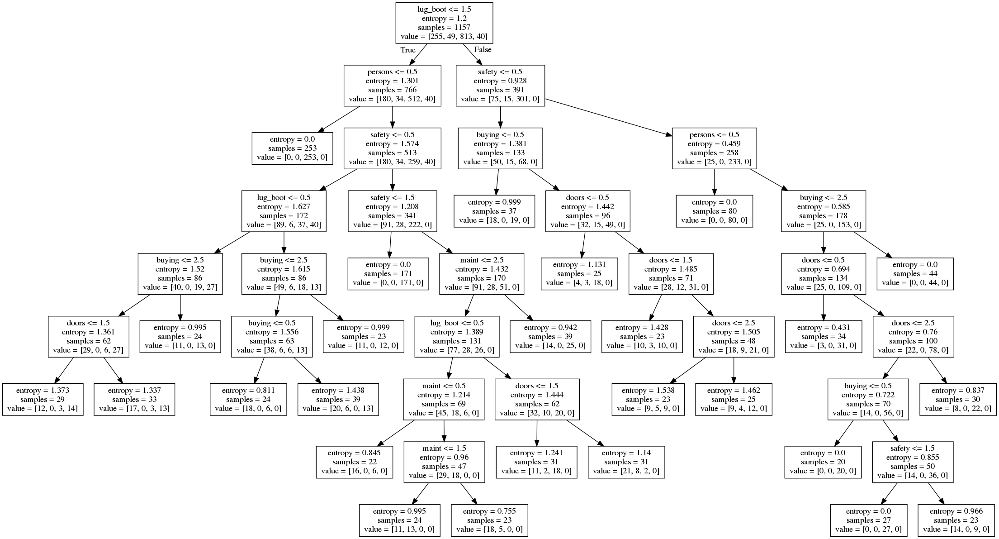

max depth  100
criterion entropy
min samples leaf 20
max features 2
Accuracy score  0.7793345008756567


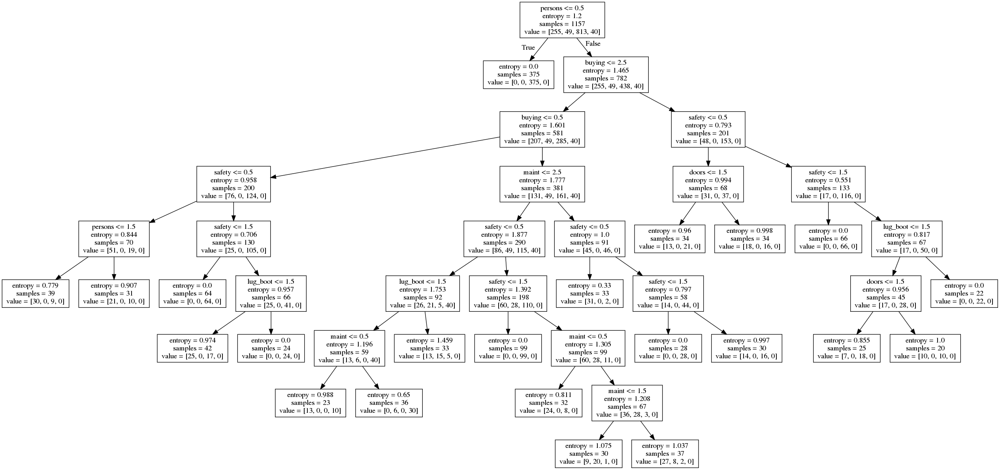

max depth  100
criterion entropy
min samples leaf 20
max features 3
Accuracy score  0.8371278458844134


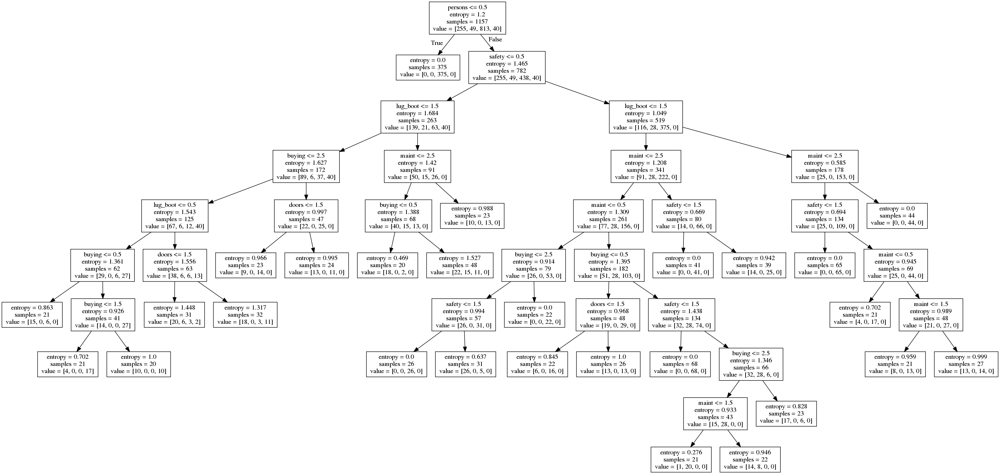

max depth  100
criterion entropy
min samples leaf 20
max features 4
Accuracy score  0.830122591943958


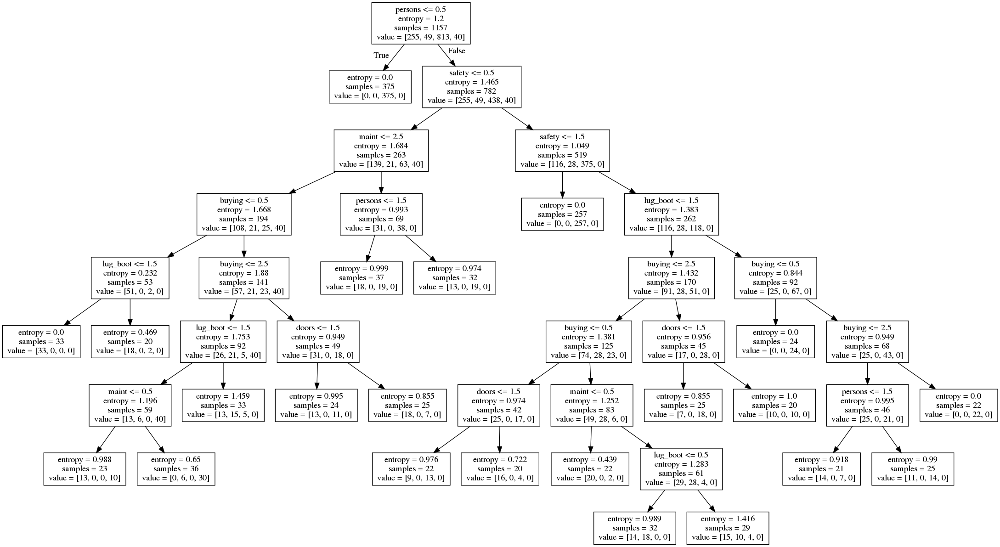

max depth  100
criterion entropy
min samples leaf 20
max features 5
Accuracy score  0.8458844133099825


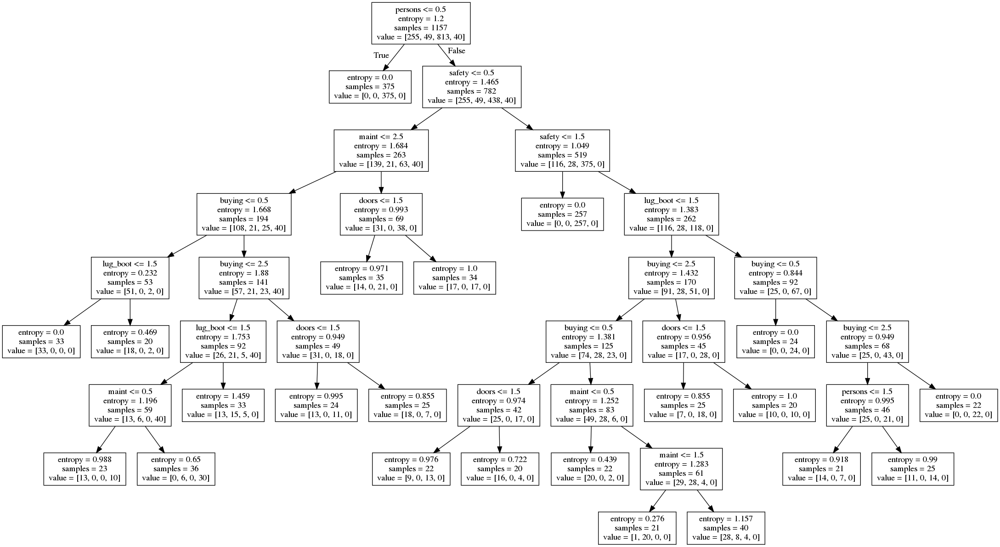

max depth  100
criterion entropy
min samples leaf 20
max features 6
Accuracy score  0.8546409807355516


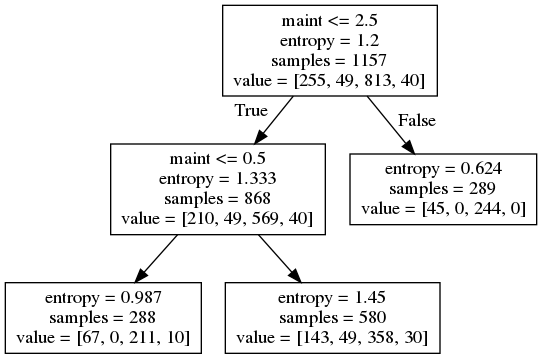

max depth  100
criterion entropy
min samples leaf 200
max features 1
Accuracy score  0.6952714535901926


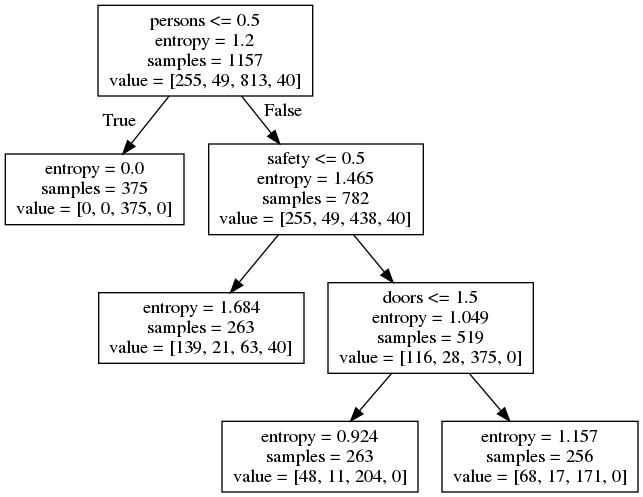

max depth  100
criterion entropy
min samples leaf 200
max features 2
Accuracy score  0.7705779334500875


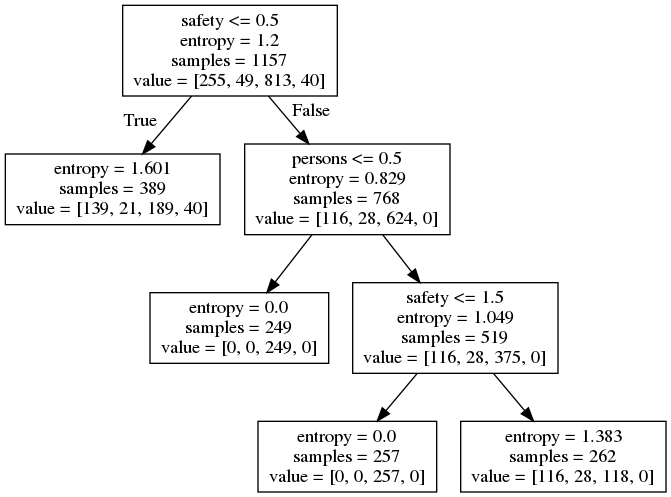

max depth  100
criterion entropy
min samples leaf 200
max features 3
Accuracy score  0.6952714535901926


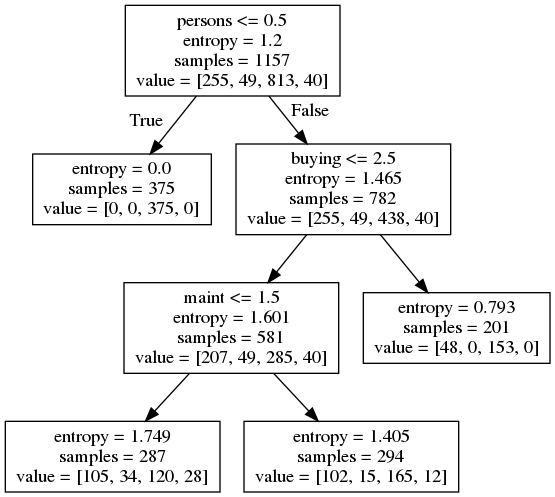

max depth  100
criterion entropy
min samples leaf 200
max features 4
Accuracy score  0.6952714535901926


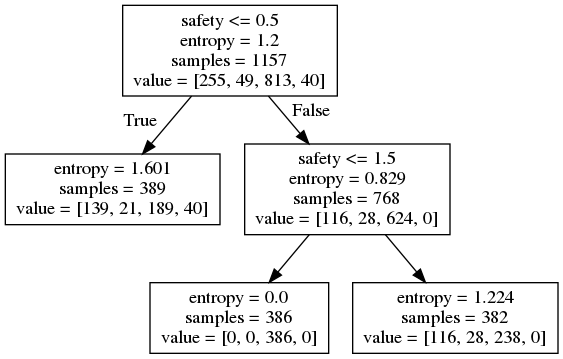

max depth  100
criterion entropy
min samples leaf 200
max features 5
Accuracy score  0.6952714535901926


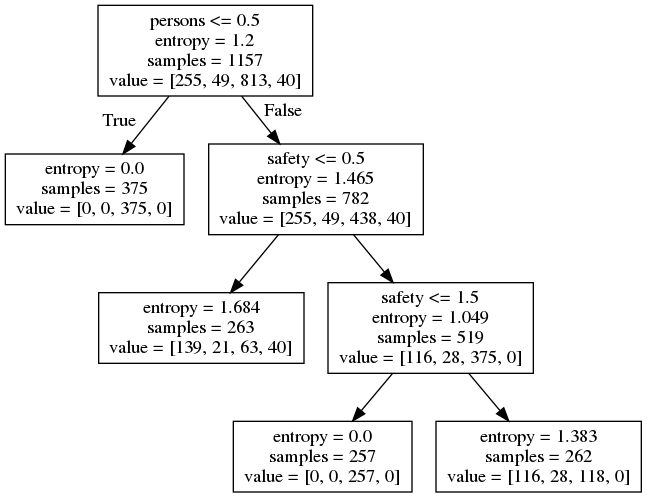

max depth  100
criterion entropy
min samples leaf 200
max features 6
Accuracy score  0.7705779334500875


In [9]:
depths = [3,5,7,9,100]
criteria = ['gini', 'entropy']
min_leaf = [1,20,200]
features = [1,2,3,4,5,6]
for depth in depths:
    for criterion in criteria:
        for min_num in min_leaf:
            for num_features in features:
                model = tree.DecisionTreeClassifier(max_depth=depth,criterion=criterion,
                                                    min_samples_leaf=min_num,max_features=num_features)
                model.fit(X_train, y_train)
                draw_decision_tree(model, cols)
                pred = model.predict(X_test)
                print('max depth ', depth)
                print('criterion', criterion)
                print('min samples leaf', min_num)
                print('max features', num_features)
                print('Accuracy score ', accuracy_score(y_test, pred))

## Часть 3. Реализация алгоритма построения дерева решений

##### 50% баллов за задание, оценочное время выполнения 2-3 часа

In [7]:
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
from sklearn.base import BaseEstimator
from sklearn.datasets import make_classification, make_regression, load_digits, load_boston
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, mean_squared_error

Зафиксируем заранее `random_state` (a.k.a. random seed). Это должно повысить вероятность полной воспроизводимости результатов, впрочем, замечено, что тем не менее небольшие флуктуации возможны (например, качества прогнозов дерева, которое мы сейчас вырастим) в случае разных ОС.

In [8]:
RANDOM_STATE = 42

**Необходимо реализовать класс `DecisionTree`**

**Спецификация:**
- класс наследуется от `sklearn.BaseEstimator`;
- конструктор содержит следующие параметры: 
    `max_depth` - максимальная глубина дерева (по умолчанию - `numpy.inf`); 
    `min_samples_split` - минимальное число объектов в вершине, при котором происходит её разбиение (по умолчанию - 2); 
    `criterion` - критерий разбиения (для классификации - 'gini' или 'entropy', для регрессии - 'variance' или 'mad_median'; 
    по умолчанию - 'gini');
    
    Функционал, значение которого максимизируется для поиска оптимального разбиения в данной вершине имеет вид
    $$Q(X, j, t) = F(X) - \dfrac{|X_l|}{|X|} F(X_l) - \dfrac{|X_r|}{|X|} F(X_r),$$
    где $X$ - выборка, находящаяся в текущей вершине, $X_l$ и $X_r$ - разбиение выборки $X$ на две части 
    по предикату $[x_j < t]$, а $F(X)$ -критерий разбиения.
    
    1. Для классификации: пусть $p_i$ - доля объектов $i$-го класса в выборке $X$.
    
        - 'gini': Неопределенность Джини $F(X) = 1 -\sum_{i = 1}^K p_i^2$.
    
        - 'entropy': Энтропия $F(X) = -\sum_{i = 1}^K p_i \log_2(p_i)$.
    
    2. Для регрессии: $y_j = y(x_j)$ - ответ на объекте $x_j$, $y = (y_1, \dots, y_{|X|})$ - вектор ответов.
    
        - 'variance': Дисперсия (среднее квадратичное отклонение от среднего) $F(X) = \dfrac{1}{|X|} \sum_{x_j \in X}(y_j - \dfrac{1}{|X|}\sum_{x_i \in X}y_i)^2$
    
        - 'mad_median': Среднее отклонение от медианы $F(X) = \dfrac{1}{|X|} \sum_{x_j \in X}|y_j - \mathrm{med}(y)|$
    
- класс имеет методы `fit`, `predict` и `predict_proba`;
- метод `fit` принимает матрицу объектов `X` и вектор ответов `y` (объекты `numpy.ndarray`) и возвращает экземпляр класса
    `DecisionTree`, представляющий собой решающее дерево, обученное по выборке `(X, y)` с учётом заданных в конструкторе параметров; 
- метод `predict_proba` принимает матрицу объектов `X` и возвращает матрицу `P` размера `X.shape[0] x K`, где `K` - число классов, такую что $p_{ij}$ есть вероятность принадлежности объекта, заданного $i$-ой строкой матрицы X к классу $j \in \{1, \dots, K\}$.
- метод `predict` принимает матрицу объектов и возвращает вектор предсказанных ответов; в случае классификации - это 
    наиболее многочисленный класс в листе, в который попал объект, а в случае регрессии - среднее значение ответов по 
    всем объектам этого листа;

**Советы по реализации:**

- Обучение дерева можно реализовать простым жадным рекурсивным алгоритмом: каждый раз выбирать наилучшее разбиение (номер признака и порог по нему).
- Если возможных порогов для разбиения будет слишком много, выбор наилучшего разбиения окажется вычислительно очень громоздкой задачей. Можно ограничить множество порогов любым удобным способом (например, посчитать квантили значений каждого признака или просто взяв случайный набор порогов).
- Лучше не подсматривать решение в готовых нагугленных вариантах. От вас требуется сделать всего лишь максимально простую реализацию того, как строится и применяется решающее дерево, а не применимую на практике универсальную библиотеку.

### Реализация (30% баллов)

In [9]:
def cluster(y, num):
    num_classes = num
    result = []
    for i in range(num_classes + 1) :
        num = np.array([y[j] for j in range(y.size) if y[j] == i]).size
        result.append(num / y.size)
    return np.array(result)

def entropy(y): 
    if y.size == 0:
        return 0
    parts = np.bincount(y) / y.size
    parts[parts == 0] = 1
    return - ((parts * np.log2(parts)).sum())

def gini(y):
    if y.size == 0:
        return 0
    parts = np.bincount(y) / y.size
    return 1 - (parts ** 2).sum()

def variance(y):
    if y.size == 0:
        return 0
    return ((y - y.mean())**2).sum() / y.size

def mad_median(y):
    if y.size == 0:
        return 0
    return (np.abs(y - np.median(y))).sum() / y.size

In [10]:
class Tree(object):
    def __init__(self):
        self.height = None
        self.left = None
        self.right = None
        self.split_feature = None
        self.split_value = None
        self.X = None
        self.y = None
        self.isLeaf = False

In [35]:
class DecisionTree(BaseEstimator):
    
    def __init__(self, max_depth=np.inf, min_samples_split=2, 
                 criterion='gini', debug=False):
        self.criterion = criterion
        self.max_depth = max_depth
        self.min_samples_split = min_samples_split
        self.debug = debug
        self.num_classes = None
        self.root = None
        
    def split(self, vertex):
        if vertex.y.size < self.min_samples_split :
            vertex.isLeaf = True
            return
        elif vertex.height > self.max_depth :
            vertex.isLeaf = True
            return
        elif vertex.y.max() == vertex.y.min():
            vertex.isLeaf = True
            return
        maxs = np.max(vertex.X, axis=0)
        mins = np.min(vertex.X, axis=0)
        q_max = 0
        ids_max = None
        feature_max = None
        border_max = None
        
        for i in range(vertex.X.shape[1]):
            if mins[i] < maxs[i]:
                for border in np.linspace(mins[i],maxs[i],9):
                    ids = np.array([j for j in range(vertex.X.shape[0]) if vertex.X[j][i] <= border])
                    left = np.array([vertex.y[j] for j in ids])
                    right = np.array([vertex.y[j] for j in range(vertex.y.size) if j not in ids])
                    q = self.calc_split(vertex.y, left, right)
                    if q > q_max and left.size > 0 and right.size > 0:
                        q_max = q
                        ids_max = np.copy(ids)
                        feature_max = i
                        border_max = border
        if ids_max is None:
            vertex.isLeaf = True
            return
        if not 0 < ids_max.size < vertex.y.size:
            vertex.isLeaf = True
            return
        left_max = np.array([vertex.y[j] for j in ids_max])
        right_max = np.array([vertex.y[j] for j in range(vertex.y.size) if j not in ids_max])
        left_X = np.array([vertex.X[j] for j in ids_max])
        right_X = np.array([vertex.X[j] for j in range(vertex.y.size) if j not in ids_max])
        vertex.left = Tree()
        vertex.right = Tree()
        vertex.split_feature = feature_max
        vertex.split_value = border_max
        vertex.left.X = np.copy(left_X)
        vertex.right.X = np.copy(right_X)
        vertex.left.y = np.copy(left_max)
        vertex.right.y = np.copy(right_max)
        vertex.left.height = vertex.height + 1
        vertex.right.height = vertex.height + 1
        vertex.X = None
        vertex.y = None
        self.split(vertex.left)
        self.split(vertex.right)
        return   
    
    def check_stop(self, y):
        if self.criterion == 'gini':
            return gini(y) < 0.05
        elif self.criterion == 'entropy' :
            return entropy(y) < 0.05
    
    def calc_split(self, y, left, right):
        if self.criterion == 'gini' :
            return gini(y) - (left.size / y.size) * gini(left) - (right.size / y.size) * gini(right)
        elif self.criterion == 'entropy' :
            return entropy(y) - (left.size / y.size) * entropy(left) - (right.size / y.size) * entropy(right)
        elif self.criterion == 'variance' :
            return variance(y) - (left.size / y.size) * variance(left) - (right.size / y.size) * variance(right)
        elif self.criterion == 'mad_median' :
            return mad_median(y) - (left.size / y.size) * mad_median(left) - (right.size / y.size) * mad_median(right)
    
    def fit(self, X, y):
        np.random.seed(RANDOM_STATE)
        self.root = Tree()
        self.root.X = np.copy(X)
        self.root.y = np.copy(y)
        self.root.height = 0
        self.num_classes = np.max(y)
        self.split(self.root)
   
    def get_leaf(self, x):
        current = self.root
        while current.isLeaf == False :
            if x[current.split_feature] > current.split_value :
                current = current.right
            else :
                current = current.left
        return current.y
    
    def predict(self, X):
        if self.criterion == 'gini' or  self.criterion == 'entropy':
            return np.argmax(self.predict_proba(X), axis = 1)
        result = []
        for i in range(X.shape[0]):
            result.append(np.mean(self.get_leaf(X[i])))
        return np.array(result)
    
    def predict_proba(self, X):
        result = []
        for i in range(X.shape[0]):
            result.append(cluster(self.get_leaf(X[i]), self.num_classes))
        return np.array(result)
    

## Тестирование реализованного алгоритма

### Классификация (10% баллов)

С помощью метода `load_digits` загрузите датасет `digits`. Разделите выборку на обучающую и тестовую с помощью метода `train_test_split`, используйте значения параметров `test_size=0.2`, `random_state=42`. Попробуйте обучить неглубокие решающие деревья и убедитесь, что критерии gini и entropy дают разные результаты.

In [15]:
digits = load_digits()
data = digits.data
target = digits.target

In [16]:
X_train, X_test, y_train, y_test = train_test_split(data, target, test_size=0.2, random_state=42)

In [17]:
%%time
model = DecisionTree(max_depth=5)
model.fit(X_train, y_train)
print('Test: ', accuracy_score(y_test, model.predict(X_test)))
print('Train: ', accuracy_score(y_train, model.predict(X_train)))

Test:  0.7972222222222223
Train:  0.8051496172581768
CPU times: user 1min, sys: 0 ns, total: 1min
Wall time: 1min


In [18]:
%%time
model = DecisionTree(max_depth=5,criterion='entropy')
model.fit(X_train, y_train)
print('Test: ', accuracy_score(y_test, model.predict(X_test)))
print('Train: ', accuracy_score(y_train, model.predict(X_train)))

Test:  0.8472222222222222
Train:  0.9046624913013221
CPU times: user 55.6 s, sys: 0 ns, total: 55.6 s
Wall time: 55.4 s


С помощью 5-кратной кросс-валидации (`GridSearchCV`) подберите оптимальное значение параметров `max_depth` и `criterion`. Для параметра `max_depth` используйте диапазон значений - range(3, 11), а для criterion - {'gini', 'entropy'}. Критерий качества `scoring`='accuracy'.

In [19]:
%%time
gs = GridSearchCV(
    DecisionTree(),
    param_grid ={
        'criterion': ['gini', 'entropy'],
        'max_depth': range(3, 11)
    },
    scoring='accuracy',
    cv = 5,
    n_jobs = 4
)
gs.fit(data,target)
print(gs.best_params_)
print(gs.best_score_)

{'criterion': 'gini', 'max_depth': 8}
0.8174735670562048
CPU times: user 1min 34s, sys: 0 ns, total: 1min 34s
Wall time: 31min 22s


Постройте графики средних значений критерия качества `accuracy` для критериев `gini` и `entropy` в зависимости от `max_depth`.

CPU times: user 14min 15s, sys: 1.56 s, total: 14min 17s
Wall time: 14min 18s


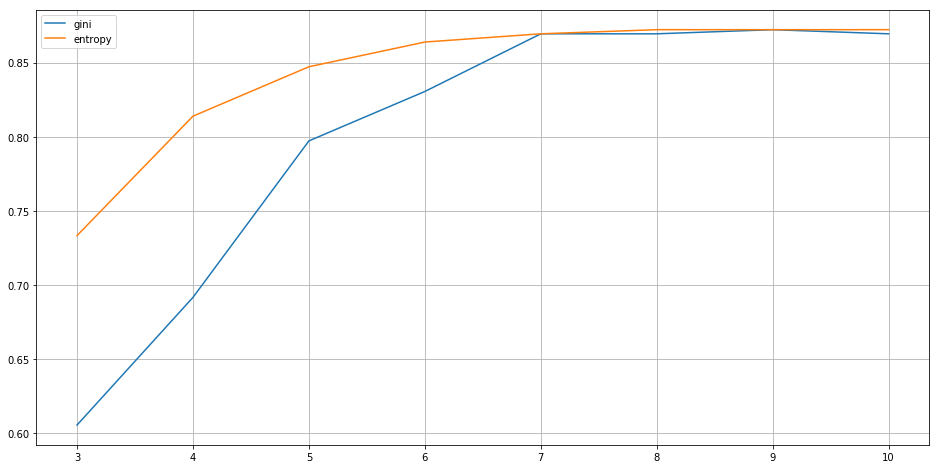

In [20]:
%%time
acc_gini = []
acc_ent = []
for depth in range(3, 11):
    for criterion in ['gini','entropy'] :
        model = DecisionTree(max_depth=depth,criterion=criterion)
        model.fit(X_train, y_train)
        if criterion == 'gini':
            acc_gini.append(accuracy_score(y_test, model.predict(X_test)))
        else :
            acc_ent.append(accuracy_score(y_test, model.predict(X_test)))
plt.figure(figsize=(16,8))
plt.plot(range(3,11), acc_gini, label='gini')
plt.plot(range(3,11), acc_ent, label='entropy')
plt.grid()
plt.legend()

Проанализируйте полученные графики. Чему равны найденные оптимальные значения параметров max_depth и criterion?

Полученные значения - экстремум двух графиков. После него начинает замечаться переобучение модели.

Используя найденные оптимальные значения max_depth и criterion, обучите решающее дерево на X_train, y_train и вычислите вероятности принадлежности к классам для X_test.

In [22]:
model = DecisionTree(max_depth=8,criterion='gini')
model.fit(X_train, y_train)
proba = model.predict_proba(X_test)
print(np.mean(proba, axis = 0))

[0.08055556 0.08811741 0.085      0.10048878 0.12838141 0.13042735
 0.09756944 0.09391026 0.07907628 0.11647351]


Для полученной матрицы вычислите усредненные по всем объектам из `X_test` значения вероятностей принадлежности к классам.

Чему примерно равна максимальная вероятность в полученном векторе?

Полученная вероятность примерно 0.13, что, считая распределение тестовой выборки примерно равномерным, значит, что у алгоритма нет больших перекосов в сторону определенного числа.

### Регрессия (10% баллов)

С помощью метода `load_boston` загрузите датасет `boston`. Разделите выборку на обучающую и тестовую с помощью метода `train_test_split`, используйте значения параметров `test_size=0.2`, `random_state=42`. Попробуйте обучить неглубокие регрессионные деревья и убедитесь, что критерии `variance` и `mad_median` дают разные результаты.

In [12]:
boston = load_boston()
data = boston.data
target = boston.target
X_train, X_test, y_train, y_test = train_test_split(data, target, test_size=0.2, random_state=42)

In [30]:
%%time
model = DecisionTree(max_depth=3,criterion='variance')
model.fit(X_train, y_train)
print('Test: ', mean_squared_error(y_test, model.predict(X_test)))
print('Train: ', mean_squared_error(y_train, model.predict(X_train)))

Test:  25.50617576464412
Train:  14.097583902489626
CPU times: user 2.96 s, sys: 5.62 ms, total: 2.97 s
Wall time: 2.97 s


In [29]:
%%time
model = DecisionTree(max_depth=3,criterion='mad_median')
model.fit(X_train, y_train)
print('Test: ', mean_squared_error(y_test, model.predict(X_test)))
print('Train: ', mean_squared_error(y_train, model.predict(X_train)))

Test:  17.653940620982493
Train:  15.382951296867649
CPU times: user 2.9 s, sys: 0 ns, total: 2.9 s
Wall time: 2.9 s


С помощью 5-кратной кросс-валидации подберите оптимальное значение параметров `max_depth` и `criterion`. Для параметра `max_depth` используйте диапазон значений - `range(2, 9)`, а для `criterion` - {'variance', 'mad_median'}. Критерий качества `scoring`='neg_mean_squared_error'.

In [38]:
%%time
gs = GridSearchCV(
    DecisionTree(),
    param_grid ={
        'criterion': ['variance', 'mad_median'],
        'max_depth': range(2, 9)
    },
    scoring='neg_mean_squared_error',
    cv = 2,
)
gs.fit(data,target)
print(gs.best_params_)
print(gs.best_score_)

{'criterion': 'mad_median', 'max_depth': 2}
-26.81316786143019
CPU times: user 1min 49s, sys: 147 ms, total: 1min 49s
Wall time: 1min 48s


Постройте графики средних значений критерия качества `neg_mean_squared_error` для критериев `variance` и `mad_median` в зависимости от `max_depth`.

HBox(children=(IntProgress(value=1, bar_style='info', max=1), HTML(value='')))

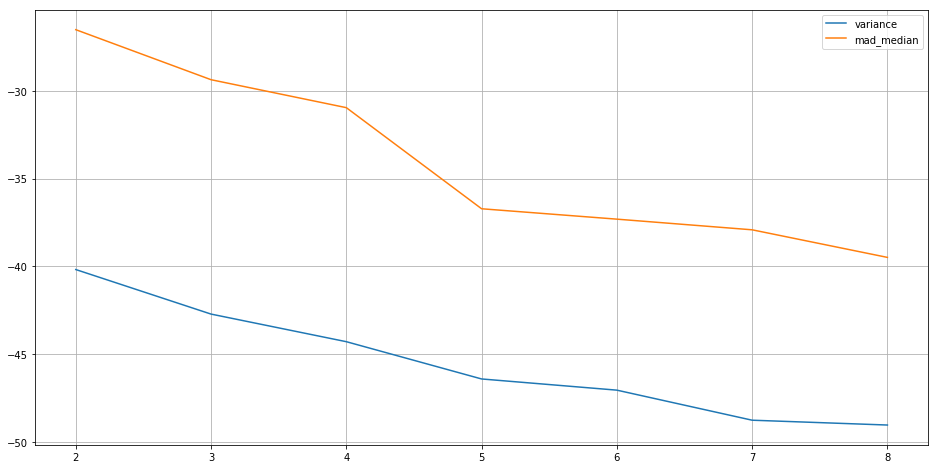

In [36]:
from tqdm import tqdm_notebook
from sklearn.model_selection import cross_val_score
acc_gini = []
acc_ent = []
pbar = tqdm_notebook()
for depth in range(2, 9):
    for criterion in ['variance','mad_median'] :
        if criterion == 'variance':
            acc_gini.append(np.mean(cross_val_score(DecisionTree(max_depth=depth,criterion=criterion), data, target, cv=5, scoring='neg_mean_squared_error')))
        else :
            acc_ent.append(np.mean(cross_val_score(DecisionTree(max_depth=depth,criterion=criterion), data, target, cv=5, scoring='neg_mean_squared_error')))
        pbar.update()
plt.figure(figsize=(16,8))
plt.plot(range(2,9), acc_gini, label='variance')
plt.plot(range(2,9), acc_ent, label='mad_median')
plt.grid()
plt.legend()

In [ ]:
Проанализируйте полученные графики. Чему равны найденные оптимальные значения параметров max_depth и criterion?

Полученные значения - экстремум двух графиков.